<a href="https://colab.research.google.com/github/iyousafzai1/AutoFe-Sel/blob/main/LAssookernal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Mean Squared Error: 79.71796228708573
R-squared: 0.750922209060631
                             Feature  Importance
5                    neighborhood.N1    7.006412
7                    neighborhood.N3    5.639513
43                        struct_X18    1.428936
50     inftheo.equivalent_attributes    1.336571
55     modelbased.nodes_per_instance    1.300868
..                               ...         ...
45  inftheo.normalized_class_entropy    0.000000
46         inftheo.attribute_entropy    0.000000
48             inftheo.joint_entropy    0.000000
49        inftheo.mutual_information    0.000000
88                      network.Hubs    0.000000

[89 rows x 2 columns]


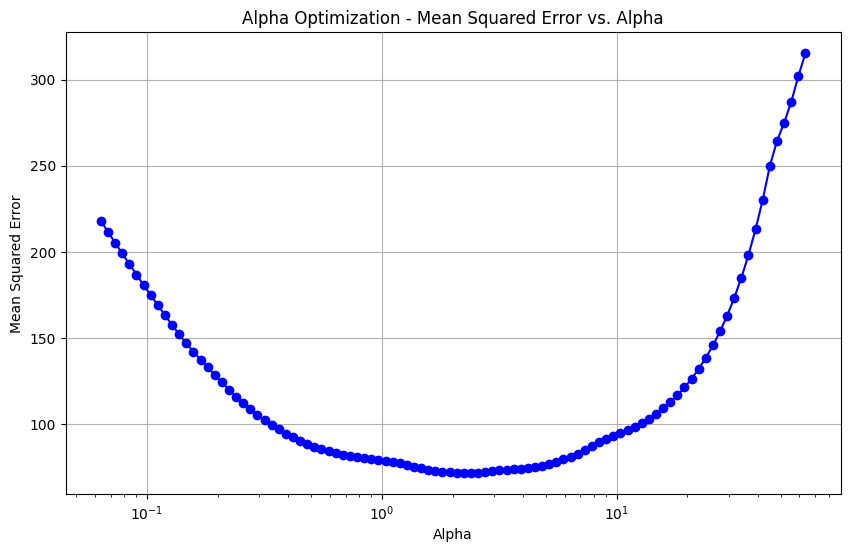

Mean Squared Error (Kernel): 399.61072431242235
R-squared (Kernel): -0.24201629933119792
       Feature  Importance
0    Feature 0         0.0
63  Feature 63         0.0
73  Feature 73         0.0
72  Feature 72         0.0
71  Feature 71         0.0
..         ...         ...
30  Feature 30         0.0
29  Feature 29         0.0
28  Feature 28         0.0
27  Feature 27         0.0
99  Feature 99         0.0

[100 rows x 2 columns]


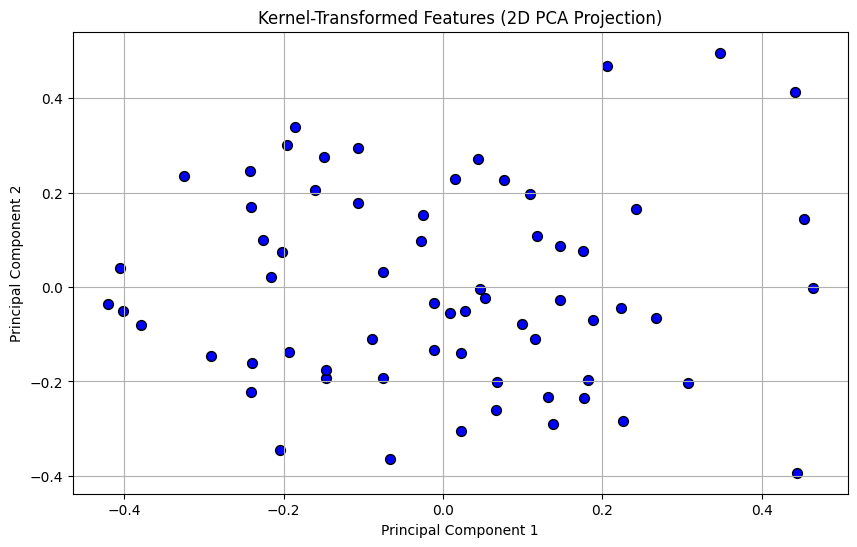

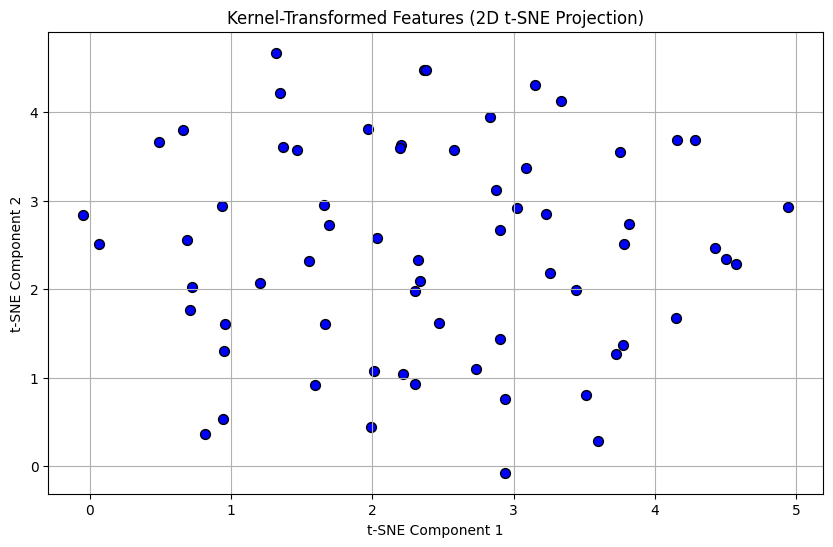

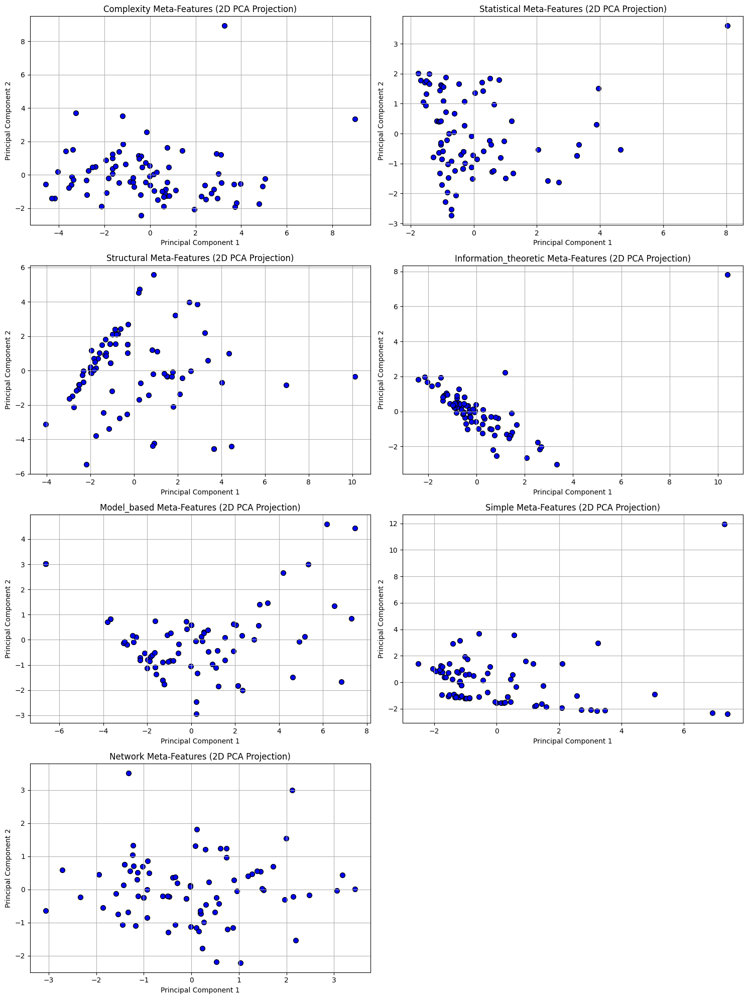

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.47264319831447, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.177442030078964, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.2675738153921, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.p

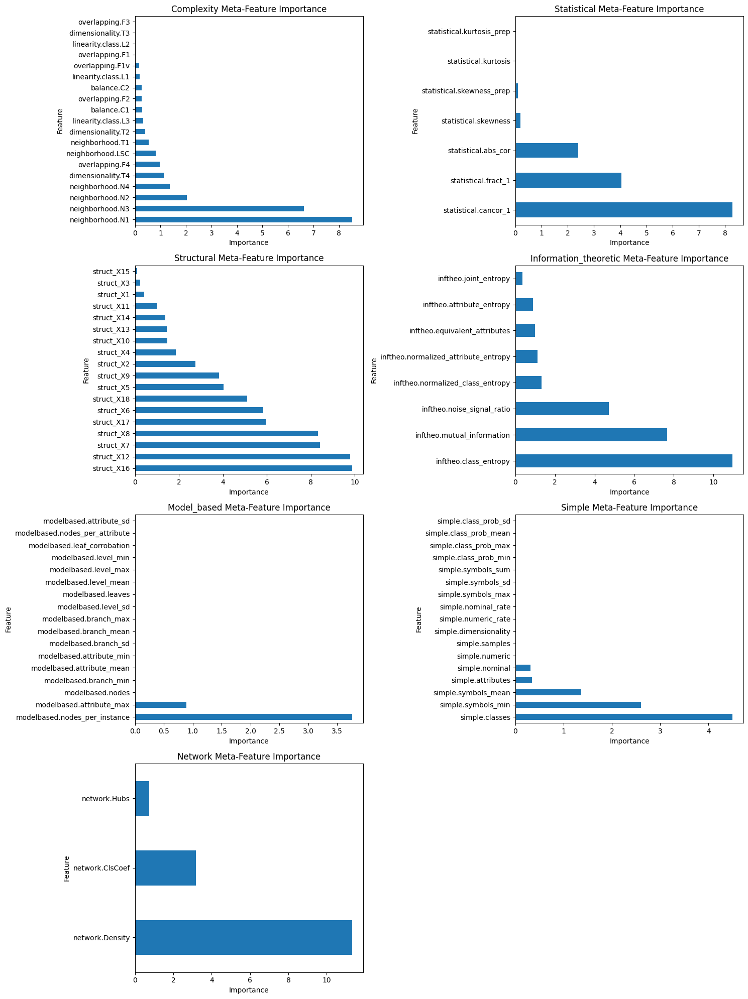

NameError: name 'feature_importance_df_sgl' is not defined

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import MultiTaskLassoCV, LassoCV
from sklearn.kernel_ridge import KernelRidge
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import KernelCenterer
from sklearn.kernel_approximation import RBFSampler

# Load meta-features and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')

# Merge all meta-features with performance data
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X_extended = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]

# Handle missing values
X_extended.fillna(X_extended.mean(), inplace=True)

# Standardize the independent variables
scaler = StandardScaler()
X_extended_scaled = scaler.fit_transform(X_extended)

# Split data into training and testing sets
X_train_ext, X_test_ext, Y_train, Y_test = train_test_split(X_extended_scaled, Y, test_size=0.2, random_state=42)

# Train MultiTaskLassoCV on the extended dataset
multi_task_lasso_ext = MultiTaskLassoCV(cv=5, random_state=42)
multi_task_lasso_ext.fit(X_train_ext, Y_train)

# Predict on the test set
Y_pred_ext = multi_task_lasso_ext.predict(X_test_ext)

# Evaluate the model
mse_ext = mean_squared_error(Y_test, Y_pred_ext)
r2_ext = r2_score(Y_test, Y_pred_ext)

# Display evaluation results
print(f'Mean Squared Error: {mse_ext}')
print(f'R-squared: {r2_ext}')

# Feature importance
coefficients_ext = multi_task_lasso_ext.coef_
avg_coefficients_ext = np.mean(np.abs(coefficients_ext), axis=0)

# Create a DataFrame for feature importance
feature_importance_df_ext = pd.DataFrame({
    'Feature': X_extended.columns,
    'Importance': avg_coefficients_ext
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(feature_importance_df_ext)

# Plot cross-validation results
alphas = multi_task_lasso_ext.alphas_
mean_scores = multi_task_lasso_ext.mse_path_.mean(axis=-1)

plt.figure(figsize=(10, 6))
plt.plot(alphas, mean_scores, marker='o', linestyle='-', color='b')
plt.xlabel('Alpha')
plt.ylabel('Mean Squared Error')
plt.title('Alpha Optimization - Mean Squared Error vs. Alpha')
plt.xscale('log')
plt.grid(True)
plt.show()

# Apply RBF kernel approximation
rbf_sampler = RBFSampler(gamma=0.1, random_state=42)
X_train_k = rbf_sampler.fit_transform(X_train_ext)
X_test_k = rbf_sampler.transform(X_test_ext)

# Apply MultiTaskLassoCV on Kernel Features
lasso_k = MultiTaskLassoCV(cv=5, random_state=42) # Use MultiTaskLassoCV for multi-task output
lasso_k.fit(X_train_k, Y_train)

# Predict on the test set
Y_pred_k = lasso_k.predict(X_test_k)

# Evaluate the model
mse_k = mean_squared_error(Y_test, Y_pred_k)
r2_k = r2_score(Y_test, Y_pred_k)

# Display evaluation results
print(f'Mean Squared Error (Kernel): {mse_k}')
print(f'R-squared (Kernel): {r2_k}')

# Feature importance for Kernel Lasso
lasso_coefficients_k = lasso_k.coef_
feature_importance_k = np.mean(np.abs(lasso_coefficients_k), axis=0)

# Create a DataFrame for feature importance
# Use the length of feature_importance_k to create a generic list of feature names
kernel_feature_importance_df_k = pd.DataFrame({
    'Feature': [f"Feature {i}" for i in range(len(feature_importance_k))],  # Generic feature names
    'Importance': feature_importance_k
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(kernel_feature_importance_df_k)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)
X_train_k_pca = pca.fit_transform(X_train_k)

plt.figure(figsize=(10, 6))
plt.scatter(X_train_k_pca[:, 0], X_train_k_pca[:, 1], c='blue', edgecolor='k', s=50)
plt.title('Kernel-Transformed Features (2D PCA Projection)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True)
plt.show()

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_train_k_tsne = tsne.fit_transform(X_train_k)

plt.figure(figsize=(10, 6))
plt.scatter(X_train_k_tsne[:, 0], X_train_k_tsne[:, 1], c='blue', edgecolor='k', s=50)
plt.title('Kernel-Transformed Features (2D t-SNE Projection)')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.grid(True)
plt.show()

# PCA for each meta-feature group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, df) in enumerate(meta_features_dfs.items()):
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Apply PCA
    pca = PCA(n_components=2)
    X_group_pca = pca.fit_transform(X_group_scaled)

    # Plotting
    ax = axes[i]
    ax.scatter(X_group_pca[:, 0], X_group_pca[:, 1], c='blue', edgecolor='k', s=50)
    ax.set_title(f'{name.capitalize()} Meta-Features (2D PCA Projection)')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.grid(True)

# Remove the last empty subplot if the number of groups is odd
if len(meta_features_dfs) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Compute feature importance for each group
feature_importance_dict = {}

for name, df in meta_features_dfs.items():
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Train MultiTaskLassoCV on the group
    lasso = MultiTaskLassoCV(cv=5, random_state=42)
    lasso.fit(X_group_scaled, Y)

    # Compute feature importance
    feature_importance = np.mean(np.abs(lasso.coef_), axis=0)

    # Store in the dictionary
    feature_importance_dict[name] = pd.DataFrame({
        'Feature': X_group.columns,
        'Importance': feature_importance
    }).sort_values(by='Importance', ascending=False)

# Visualize feature importance for each group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, importance_df) in enumerate(feature_importance_dict.items()):
    ax = axes[i]
    importance_df.plot(kind='barh', x='Feature', y='Importance', ax=ax, legend=False)
    ax.set_title(f'{name.capitalize()} Meta-Feature Importance')
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')

# Remove the last empty subplot if the number of groups is odd
if len(feature_importance_dict) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.kernel_approximation import RBFSampler

# Load and preprocess data (as previously shown)

# Train Sparse Group Lasso model and other models (as previously shown)

# Feature Importance and Visualizations
def visualize_feature_importance(feature_importance_df, title):
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

# Visualize feature importance for Sparse Group Lasso
visualize_feature_importance(feature_importance_df_sgl, 'Feature Importance (Sparse Group Lasso)')

# Visualize feature importance for Kernel Lasso
visualize_feature_importance(kernel_feature_importance_df_k, 'Feature Importance (Kernel Lasso)')

# PCA and t-SNE visualizations
def plot_pca_tsne(X, title):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (PCA Projection)')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()

    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (t-SNE Projection)')
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

# Apply PCA and t-SNE visualizations
plot_pca_tsne(X_train_k, 'Kernel-Transformed Features')


In [ ]:
!pip install group-lasso


In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.kernel_approximation import RBFSampler

# Load meta-features and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')

# Merge all meta-features with performance data
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X_extended = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]

# Handle missing values
X_extended.fillna(X_extended.mean(), inplace=True)

# Standardize the independent variables
scaler = StandardScaler()
X_extended_scaled = scaler.fit_transform(X_extended)

# Split data into training and testing sets
X_train_ext, X_test_ext, Y_train, Y_test = train_test_split(X_extended_scaled, Y, test_size=0.2, random_state=42)

# Define group structure for Sparse Group Lasso
group_indices = []
start_idx = 0
for name, df in meta_features_dfs.items():
    group_indices.extend([start_idx + i for i in range(df.shape[1] - 1)])  # exclude the 'Datasets' column
    start_idx += df.shape[1] - 1

# Train Sparse Group Lasso model
sgl = GroupLasso(
    groups=group_indices,
    group_reg=0.01,
    l1_reg=0.01,
    frobenius_lipschitz=True,
    scale_reg="group_size",
    subsampling_scheme=1,
    supress_warning=True,
    n_iter=1000,
    tol=1e-3,
    fit_intercept=True,
    random_state=42
)
sgl.fit(X_train_ext, Y_train)

# Predict on the test set
Y_pred_sgl = sgl.predict(X_test_ext)

# Evaluate the model
mse_sgl = mean_squared_error(Y_test, Y_pred_sgl)
r2_sgl = r2_score(Y_test, Y_pred_sgl)

# Display evaluation results
print(f'Mean Squared Error (SGL): {mse_sgl}')
print(f'R-squared (SGL): {r2_sgl}')

# Feature importance for Sparse Group Lasso
sgl_coefficients = sgl.coef_
avg_sgl_coefficients = np.mean(np.abs(sgl_coefficients), axis=0)

# Create a DataFrame for feature importance
feature_importance_df_sgl = pd.DataFrame({
    'Feature': X_extended.columns,
    'Importance': avg_sgl_coefficients
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(feature_importance_df_sgl)

# Visualize feature importance function
def visualize_feature_importance(feature_importance_df, title):
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

# Visualize feature importance for Sparse Group Lasso
visualize_feature_importance(feature_importance_df_sgl, 'Feature Importance (Sparse Group Lasso)')

# Apply RBF kernel approximation
rbf_sampler = RBFSampler(gamma=0.1, random_state=42)
X_train_k = rbf_sampler.fit_transform(X_train_ext)
X_test_k = rbf_sampler.transform(X_test_ext)

# Apply MultiTaskLassoCV on Kernel Features
lasso_k = MultiTaskLassoCV(cv=5, random_state=42)
lasso_k.fit(X_train_k, Y_train)

# Predict on the test set
Y_pred_k = lasso_k.predict(X_test_k)

# Evaluate the model
mse_k = mean_squared_error(Y_test, Y_pred_k)
r2_k = r2_score(Y_test, Y_pred_k)

# Display evaluation results
print(f'Mean Squared Error (Kernel): {mse_k}')
print(f'R-squared (Kernel): {r2_k}')

# Feature importance for Kernel Lasso
lasso_coefficients_k = lasso_k.coef_
feature_importance_k = np.mean(np.abs(lasso_coefficients_k), axis=0)

# Create a DataFrame for feature importance
kernel_feature_importance_df_k = pd.DataFrame({
    'Feature': X_extended.columns[:len(feature_importance_k)],
    'Importance': feature_importance_k
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(kernel_feature_importance_df_k)

# Visualize feature importance for Kernel Lasso
visualize_feature_importance(kernel_feature_importance_df_k, 'Feature Importance (Kernel Lasso)')

# PCA and t-SNE visualizations
def plot_pca_tsne(X, title):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (PCA Projection)')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()

    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (t-SNE Projection)')
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

# Apply PCA and t-SNE visualizations
plot_pca_tsne(X_train_k, 'Kernel-Transformed Features')

# PCA for each meta-feature group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, df) in enumerate(meta_features_dfs.items()):
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Apply PCA
    pca = PCA(n_components=2)
    X_group_pca = pca.fit_transform(X_group_scaled)

    # Plotting
    ax = axes[i]
    ax.scatter(X_group_pca[:, 0], X_group_pca[:, 1], c='blue', edgecolor='k', s=50)
    ax.set_title(f'{name.capitalize()} Meta-Features (2D PCA Projection)')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.grid(True)

# Remove the last empty subplot if the number of groups is odd
if len(meta_features_dfs) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Compute feature importance for each group
feature_importance_dict = {}

for name, df in meta_features_dfs.items():
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Train MultiTaskLassoCV on the group
    lasso = MultiTaskLassoCV(cv=5, random_state=42)
    lasso.fit(X_group_scaled, Y)

    # Compute feature importance
    feature_importance = np.mean(np.abs(lasso.coef_), axis=0)

    # Store in the dictionary
    feature_importance_dict[name] = pd.DataFrame({
        'Feature': X_group.columns,
        'Importance': feature_importance
    }).sort_values(by='Importance', ascending=False)


# Visualize feature importance for each group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, importance_df) in enumerate(feature_importance_dict.items()):
    ax = axes[i]
    importance_df.plot(kind='barh', x='Feature', y='Importance', ax=ax, legend=False)
    ax.set_title(f'{name.capitalize()} Meta-Feature Importance')
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')

# Remove the last empty subplot if the number of groups is odd
if len(feature_importance_dict) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()


Mean Squared Error (SGL): 156.45127016699328
R-squared (SGL): 0.5173761994866857


ValueError: All arrays must be of the same length

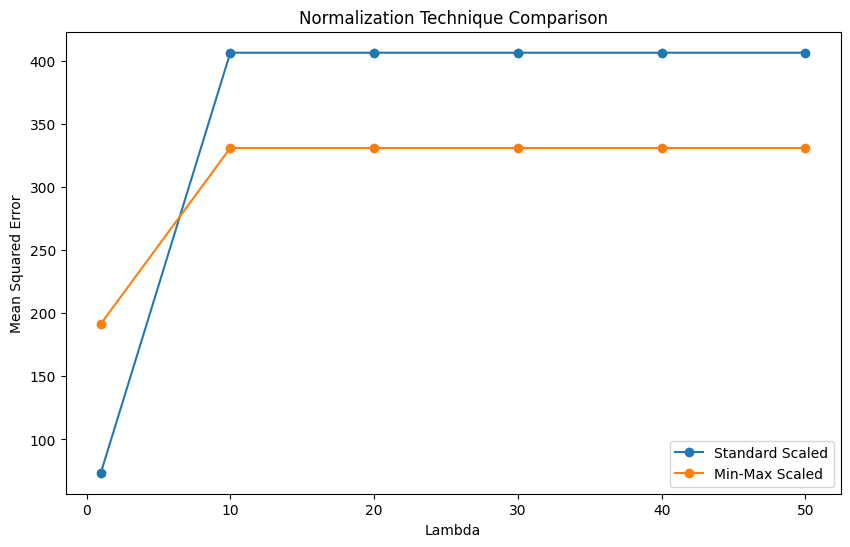

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:,~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)

# Apply grid search on min-max scaled data
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to find optimal p
def find_optimal_p(results):
    optimal_p = sorted(results, key=lambda x: x[2])[0][0]
    return optimal_p

optimal_p_standard = find_optimal_p(results_standard)
optimal_p_minmax = find_optimal_p(results_minmax)

# Function to train Group Lasso model
def train_sglasso(X, Y, lambda_values, p):
    group_indices = []
    group_size = X.shape[1] // p
    for i in range(p):
        start_idx = i * group_size
        end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
        group_indices.extend([i] * (end_idx - start_idx))
    remaining_features = X.shape[1] % p
    if remaining_features > 0:
        group_indices.extend([p] * remaining_features)

    group_indices = np.array(group_indices)

    metrics = []
    for lam in lambda_values:
        sgl = GroupLasso(
            groups=group_indices,
            group_reg=lam,
            l1_reg=lam,
            frobenius_lipschitz=True,
            scale_reg="group_size",
            subsampling_scheme=1,
            supress_warning=True,
            n_iter=1000,
            tol=1e-3,
            fit_intercept=True,
            random_state=42
        )
        sgl.fit(X, Y)
        Y_pred = sgl.predict(X)
        mse = mean_squared_error(Y, Y_pred)
        r2 = r2_score(Y, Y_pred)
        metrics.append((lam, mse, r2))
    return metrics

# Train with the optimal p for standard scaled data
metrics_standard = train_sglasso(X_standard_scaled, Y, lambda_values, optimal_p_standard)

# Train with the optimal p for min-max scaled data
metrics_minmax = train_sglasso(X_minmax_scaled, Y, lambda_values, optimal_p_minmax)

# Plotting functions
def plot_feature_importance(sgl, X, title):
    coefficients = sgl.coef_
    importance = np.mean(np.abs(coefficients), axis=0)
    feature_names = [f'Feature {i}' for i in range(X.shape[1])]

    plt.figure(figsize=(10, 6))
    plt.barh(feature_names, importance)
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

def plot_eigenvalues(X, title):
    corr_matrix = np.corrcoef(X, rowvar=False)
    eigenvalues, _ = np.linalg.eig(corr_matrix)
    eigenvalues = sorted(eigenvalues)[:6]

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 7), eigenvalues, marker='o')
    plt.yscale('log')
    plt.xlabel('Eigenvalue Index')
    plt.ylabel('Eigenvalue')
    plt.title(title)
    plt.show()

def plot_normalization_comparison(metrics_standard, metrics_minmax):
    lambda_values = [m[0] for m in metrics_standard]
    mse_standard = [m[1] for m in metrics_standard]
    mse_minmax = [m[1] for m in metrics_minmax]

    plt.figure(figsize=(10, 6))
    plt.plot(lambda_values, mse_standard, label='Standard Scaled', marker='o')
    plt.plot(lambda_values, mse_minmax, label='Min-Max Scaled', marker='o')
    plt.xlabel('Lambda')
    plt.ylabel('Mean Squared Error')
    plt.title('Normalization Technique Comparison')
    plt.legend()
    plt.show()

# Example calls
# plot_feature_importance(sgl_standard, X_standard_scaled, 'Feature Importance (Standard Scaled)')
# plot_eigenvalues(X_standard_scaled, 'Eigenvalues (Standard Scaled)')
plot_normalization_comparison(metrics_standard, metrics_minmax)


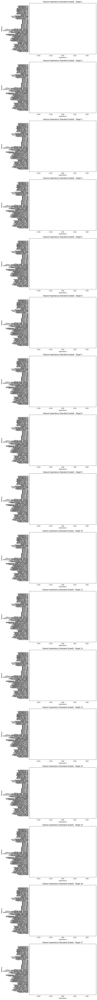

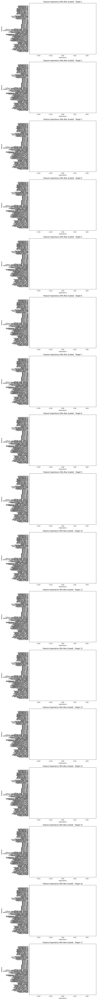

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


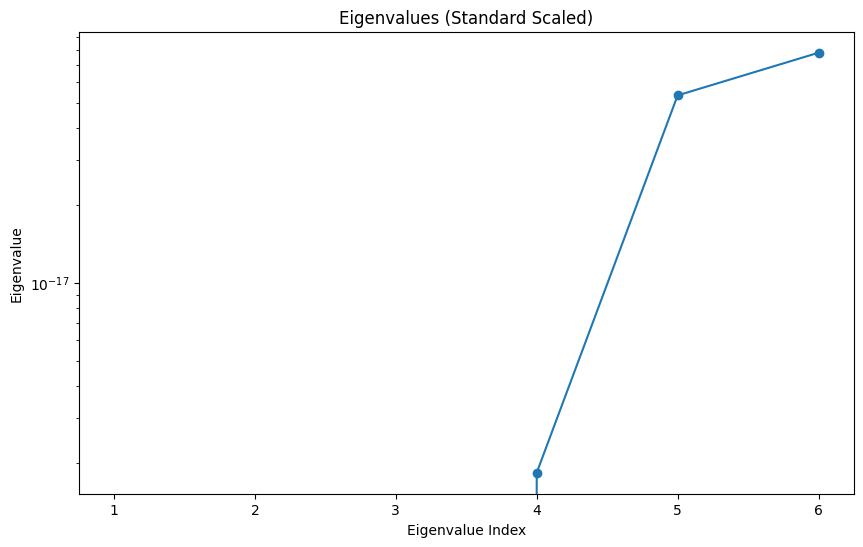

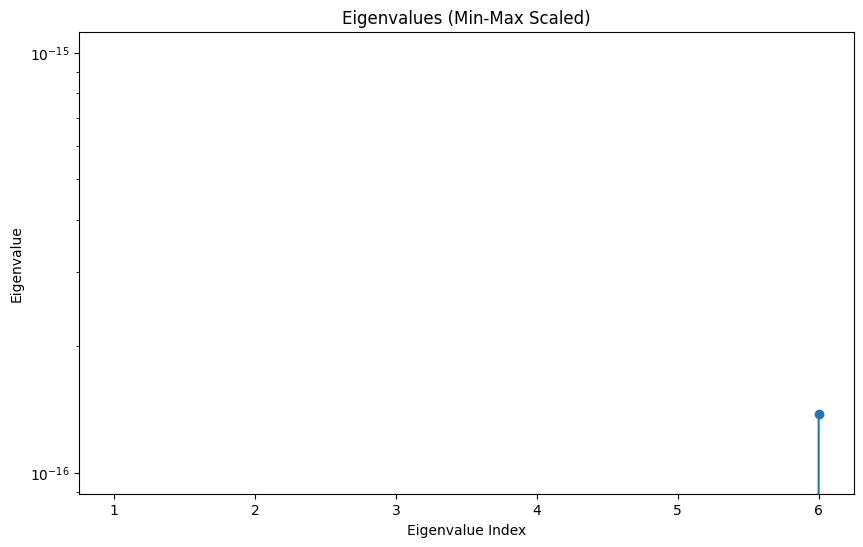

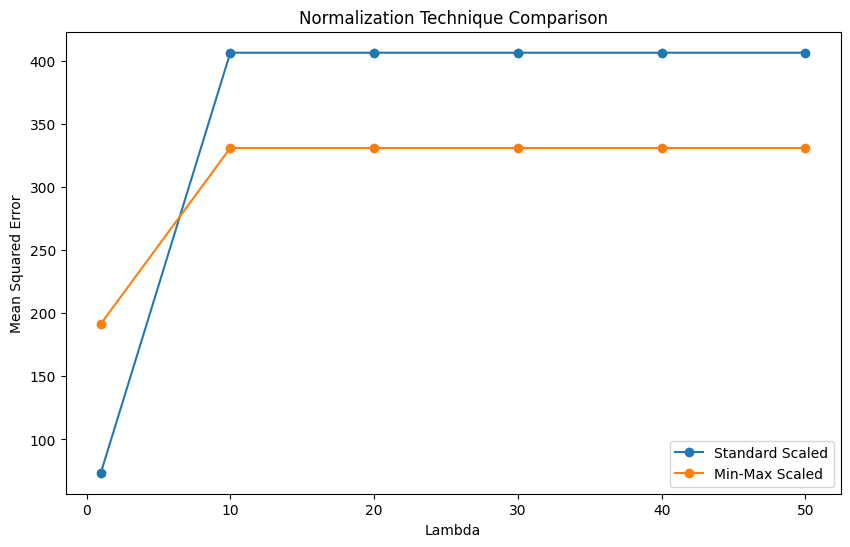

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:,~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [1, 10, 20, 30, 40, 50]
p_values = [5, 10, 20, 30, 40, 50]

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to find optimal p
def find_optimal_p(results):
    optimal_p = sorted(results, key=lambda x: x[2])[0][0]
    return optimal_p

optimal_p_standard = find_optimal_p(results_standard)
optimal_p_minmax = find_optimal_p(results_minmax)

# Function to train Group Lasso model
def train_sglasso(X, Y, lambda_values, p):
    group_indices = []
    group_size = X.shape[1] // p
    for i in range(p):
        start_idx = i * group_size
        end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
        group_indices.extend([i] * (end_idx - start_idx))
    remaining_features = X.shape[1] % p
    if remaining_features > 0:
        group_indices.extend([p] * remaining_features)

    group_indices = np.array(group_indices)

    metrics = []
    for lam in lambda_values:
        sgl = GroupLasso(
            groups=group_indices,
            group_reg=lam,
            l1_reg=lam,
            frobenius_lipschitz=True,
            scale_reg="group_size",
            subsampling_scheme=1,
            supress_warning=True,
            n_iter=1000,
            tol=1e-3,
            fit_intercept=True,
            random_state=42
        )
        sgl.fit(X, Y)
        Y_pred = sgl.predict(X)
        mse = mean_squared_error(Y, Y_pred)
        r2 = r2_score(Y, Y_pred)
        metrics.append((lam, mse, r2))
    return metrics

# Train with the optimal p for standard scaled data
metrics_standard = train_sglasso(X_standard_scaled, Y, lambda_values, optimal_p_standard)

# Train with the optimal p for min-max scaled data
metrics_minmax = train_sglasso(X_minmax_scaled, Y, lambda_values, optimal_p_minmax)

def plot_feature_importance(sgl, feature_names, title):
    coefficients = sgl.coef_
    # Calculate importance for each target variable separately
    importance = np.abs(coefficients).mean(axis=0)

    num_targets = importance.shape[0]

    plt.figure(figsize=(10, 6 * num_targets))  # Adjust figure size based on number of targets

    for i in range(num_targets):
        plt.subplot(num_targets, 1, i + 1)  # Create subplots for each target
        plt.barh(feature_names, importance[i])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f'{title} - Target {i+1}')
        plt.gca().invert_yaxis()

    plt.tight_layout()  # Adjust spacing between subplots
    plt.show()

def plot_eigenvalues(X, title):
    corr_matrix = np.corrcoef(X, rowvar=False)
    eigenvalues, _ = np.linalg.eig(corr_matrix)
    eigenvalues = sorted(eigenvalues)[:6]

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 7), eigenvalues, marker='o')
    plt.yscale('log')
    plt.xlabel('Eigenvalue Index')
    plt.ylabel('Eigenvalue')
    plt.title(title)
    plt.show()

def plot_normalization_comparison(metrics_standard, metrics_minmax):
    lambda_values = [m[0] for m in metrics_standard]
    mse_standard = [m[1] for m in metrics_standard]
    mse_minmax = [m[1] for m in metrics_minmax]

    plt.figure(figsize=(10, 6))
    plt.plot(lambda_values, mse_standard, label='Standard Scaled', marker='o')
    plt.plot(lambda_values, mse_minmax, label='Min-Max Scaled', marker='o')
    plt.xlabel('Lambda')
    plt.ylabel('Mean Squared Error')
    plt.title('Normalization Technique Comparison')
    plt.legend()
    plt.show()

# Example calls for plotting
# Assuming `sgl_standard` and `sgl_minmax` are the trained Group Lasso models for the best lambda values
sgl_standard = GroupLasso(
    groups=np.arange(X_standard_scaled.shape[1]),
    group_reg=10,  # example value, replace with actual best lambda value found
    l1_reg=10,     # example value, replace with actual best lambda value found
    frobenius_lipschitz=True,
    scale_reg="group_size",
    subsampling_scheme=1,
    supress_warning=True,
    n_iter=1000,
    tol=1e-3,
    fit_intercept=True,
    random_state=42
)
sgl_standard.fit(X_standard_scaled, Y)

sgl_minmax = GroupLasso(
    groups=np.arange(X_minmax_scaled.shape[1]),
    group_reg=10,  # example value, replace with actual best lambda value found
    l1_reg=10,     # example value, replace with actual best lambda value found
    frobenius_lipschitz=True,
    scale_reg="group_size",
    subsampling_scheme=1,
    supress_warning=True,
    n_iter=1000,
    tol=1e-3,
    fit_intercept=True,
    random_state=42
)
sgl_minmax.fit(X_minmax_scaled, Y)

# Plotting feature importance
plot_feature_importance(sgl_standard, feature_names, 'Feature Importance (Standard Scaled)')
plot_feature_importance(sgl_minmax, feature_names, 'Feature Importance (Min-Max Scaled)')

# Plotting eigenvalues
plot_eigenvalues(X_standard_scaled, 'Eigenvalues (Standard Scaled)')
plot_eigenvalues(X_minmax_scaled, 'Eigenvalues (Min-Max Scaled)')

# Plotting normalization comparison
plot_normalization_comparison(metrics_standard, metrics_minmax)







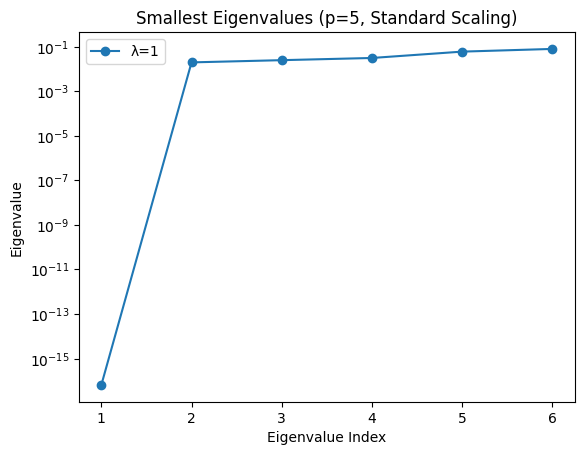

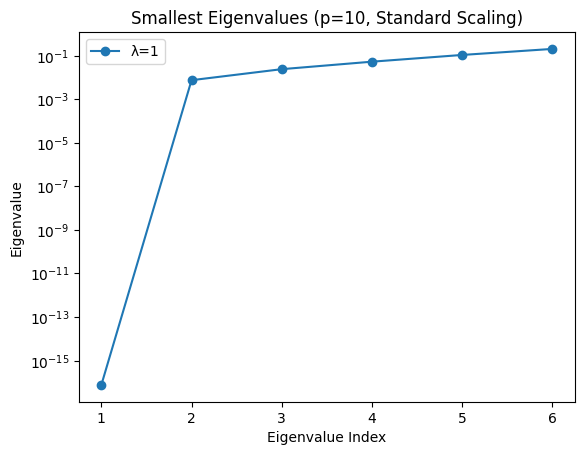

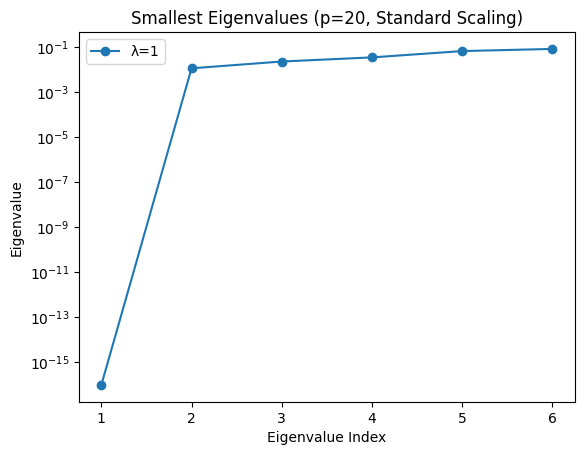

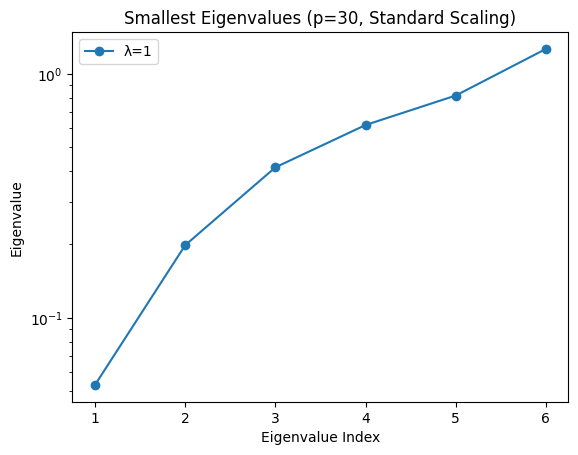

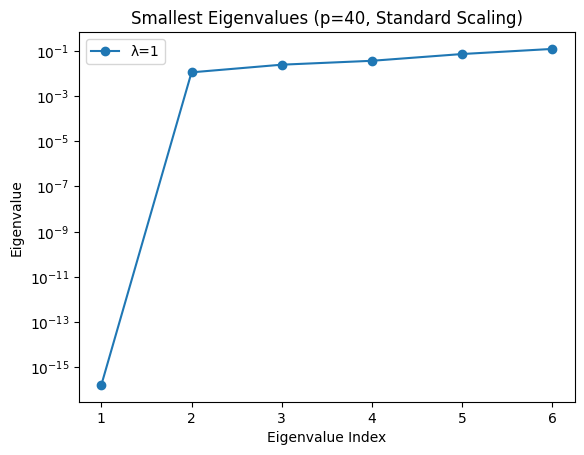

...

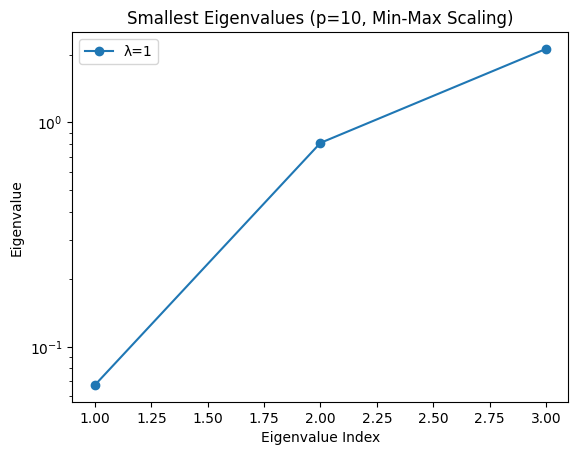

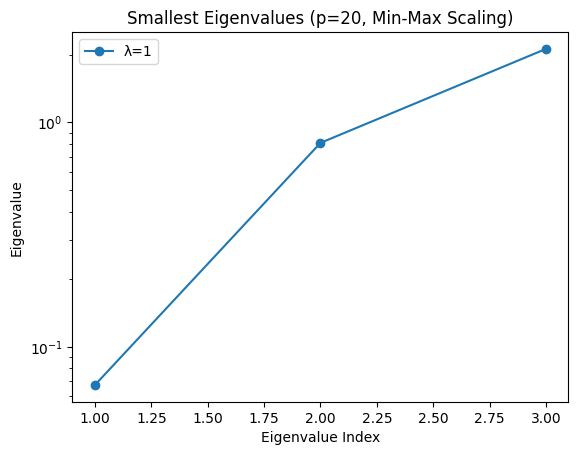

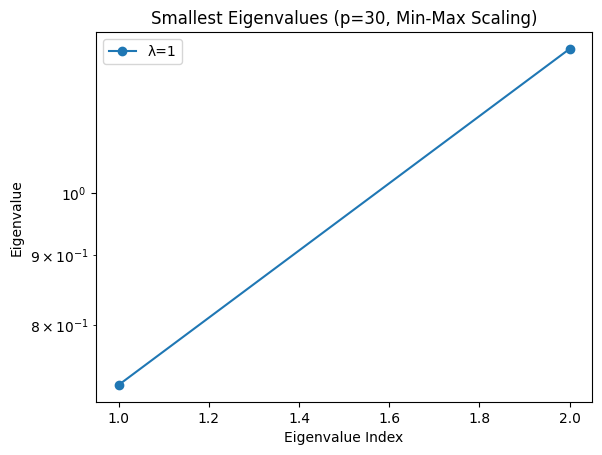

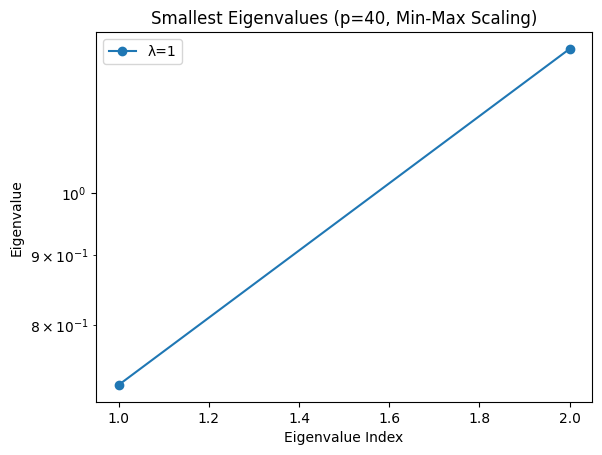

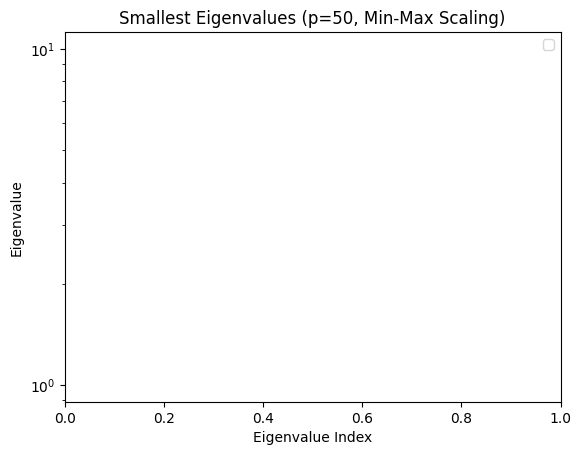

NameError: name 'sgl_standard' is not defined

In [ ]:
!pip install group-lasso
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:,~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [1, 10, 20, 30, 40, 50]
p_values = [5, 10, 20, 30, 40, 50]

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to find optimal p
def find_optimal_p(results):
    optimal_p = sorted(results, key=lambda x: x[2])[0][0]
    return optimal_p

optimal_p_standard = find_optimal_p(results_standard)
optimal_p_minmax = find_optimal_p(results_minmax)

# Function to train Group Lasso model
def train_sglasso(X, Y, lambda_values, p):
    group_indices = []
    group_size = X.shape[1] // p
    for i in range(p):
        start_idx = i * group_size
        end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
        group_indices.extend([i] * (end_idx - start_idx))
    remaining_features = X.shape[1] % p
    if remaining_features > 0:
        group_indices.extend([p] * remaining_features)

    group_indices = np.array(group_indices)

    metrics = []
    for lam in lambda_values:
        sgl = GroupLasso(
            groups=group_indices,
            group_reg=lam,
            l1_reg=lam,
            frobenius_lipschitz=True,
            scale_reg="group_size",
            subsampling_scheme=1,
            supress_warning=True,
            n_iter=1000,
            tol=1e-3,
            fit_intercept=True,
            random_state=42
        )
        sgl.fit(X, Y)
        Y_pred = sgl.predict(X)
        mse = mean_squared_error(Y, Y_pred)
        r2 = r2_score(Y, Y_pred)
        metrics.append((lam, mse, r2))
    return metrics

# Train with the optimal p for standard scaled data
metrics_standard = train_sglasso(X_standard_scaled, Y, lambda_values, optimal_p_standard)

# Train with the optimal p for min-max scaled data
metrics_minmax = train_sglasso(X_minmax_scaled, Y, lambda_values, optimal_p_minmax)

def plot_smallest_eigenvalues(X, Y, p_values, lambda_values, normalization_type):
    import matplotlib.pyplot as plt
    import numpy as np
    from numpy.linalg import eigvals
    from group_lasso import GroupLasso

    for p in p_values:
        fig, ax = plt.subplots()
        for lam in lambda_values:
            # Define group indices
            group_indices = []
            start_idx = 0
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            # Handle remaining features
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

            group_indices = np.array(group_indices)

            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)

            # Get the selected features
            # Calculate importance for each feature by summing absolute coefficients across targets
            importance = np.abs(sgl.coef_).sum(axis=1)  # Sum across targets to get feature importance
            selected_features = importance != 0  # Select features with non-zero importance

            # Correctly index into X using the boolean mask
            selected_X = X[:, selected_features] # Use boolean indexing to select features

            # Calculate the eigenvalues of the correlation matrix
            if selected_X.shape[1] <= 1:  # Check if less than 2 features are selected
                continue  # Skip if no or only one feature is selected - can't calculate correlation matrix
            corr_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = np.sort(eigvals(corr_matrix))
            smallest_eigenvalues = eigenvalues[:6]

            # Adjust x-values to match the length of smallest_eigenvalues
            x_values = range(1, len(smallest_eigenvalues) + 1)

            # Plot the smallest eigenvalues
            ax.plot(x_values, smallest_eigenvalues, marker='o', label=f'λ={lam}')

        ax.set_yscale('log')
        ax.set_xlabel('Eigenvalue Index')
        ax.set_ylabel('Eigenvalue')
        ax.set_title(f'Smallest Eigenvalues (p={p}, {normalization_type} Scaling)')
        ax.legend()
        plt.show()

# Assuming previous code is already executed and variables are defined

# Example call for standard scaling
plot_smallest_eigenvalues(X_standard_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Standard')

# Example call for min-max scaling
plot_smallest_eigenvalues(X_minmax_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Min-Max')







# Plotting feature importance
plot_feature_importance(sgl_standard, feature_names, 'Feature Importance (Standard Scaled)')
plot_feature_importance(sgl_minmax, feature_names, 'Feature Importance (Min-Max Scaled)')

# Plotting eigenvalues
plot_eigenvalues(X_standard_scaled, 'Eigenvalues (Standard Scaled)')
plot_eigenvalues(X_minmax_scaled, 'Eigenvalues (Min-Max Scaled)')

# Plotting normalization comparison
plot_normalization_comparison(metrics_standard, metrics_minmax)



In [ ]:
!pip install group-lasso

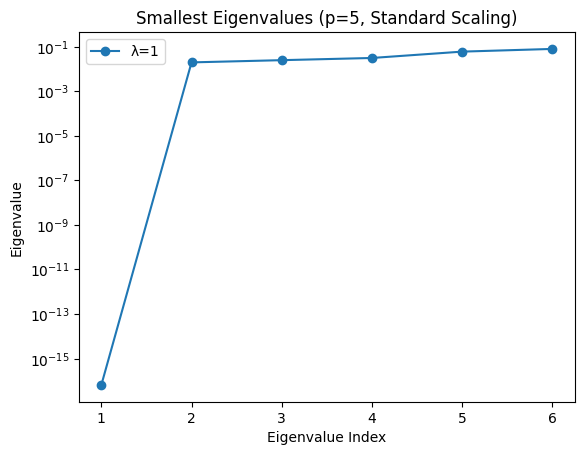

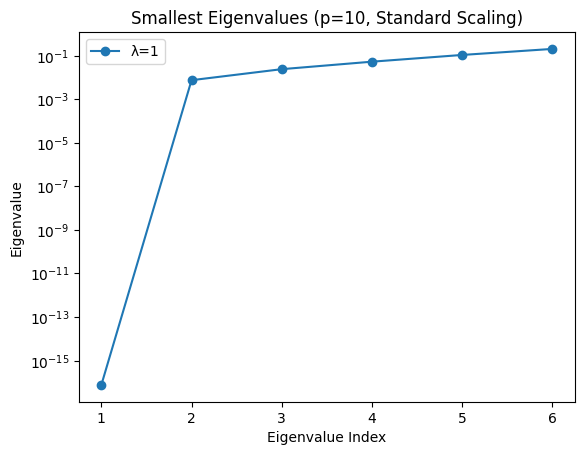

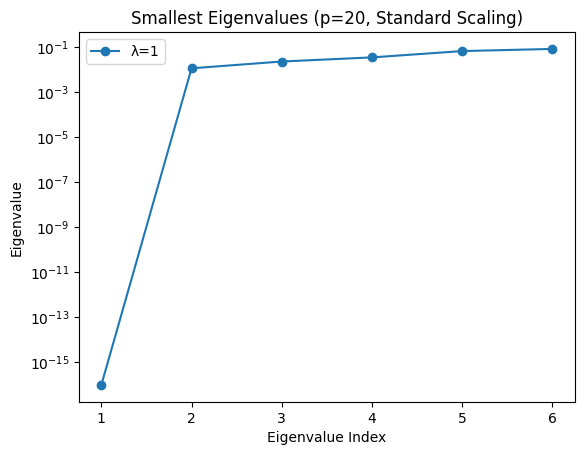

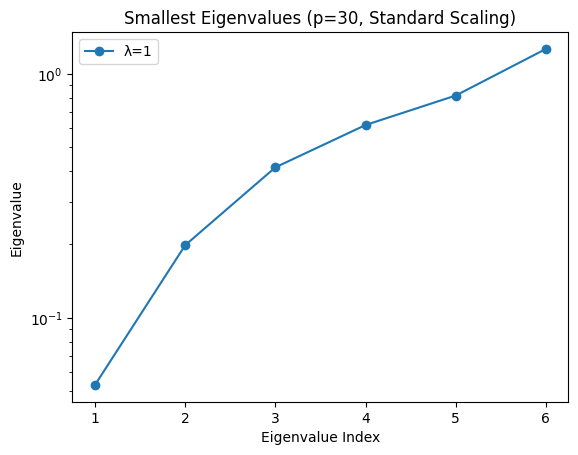

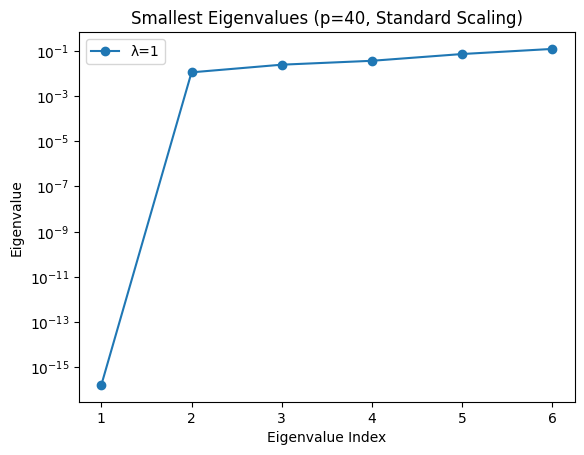

...

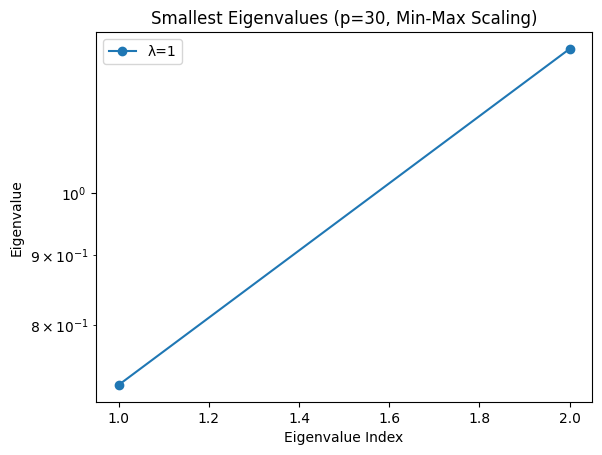

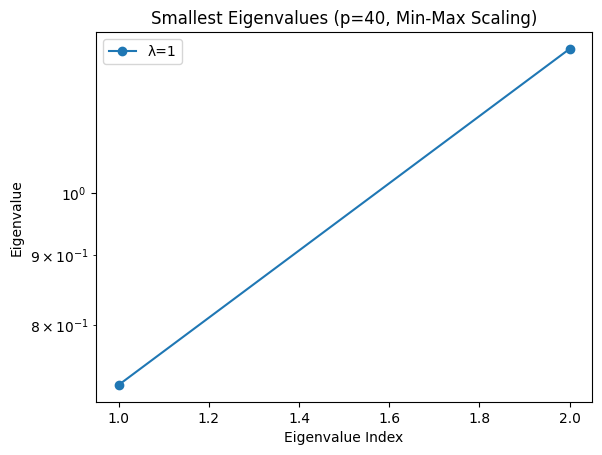

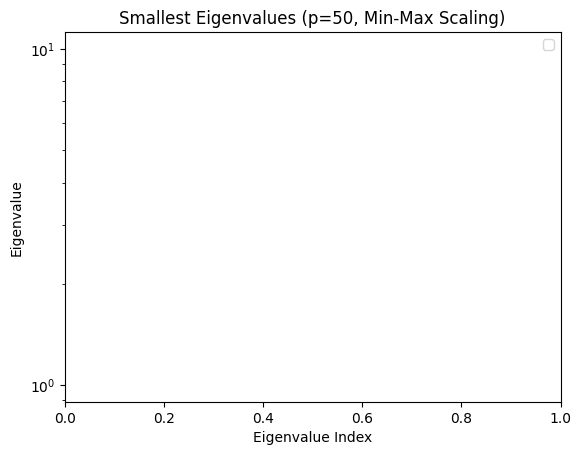

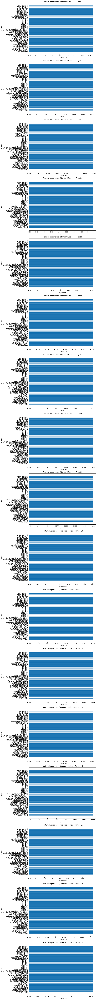

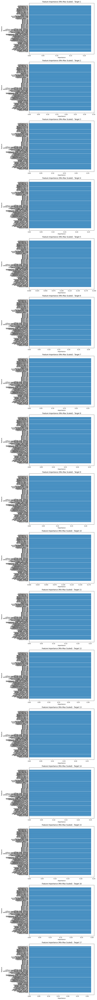

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


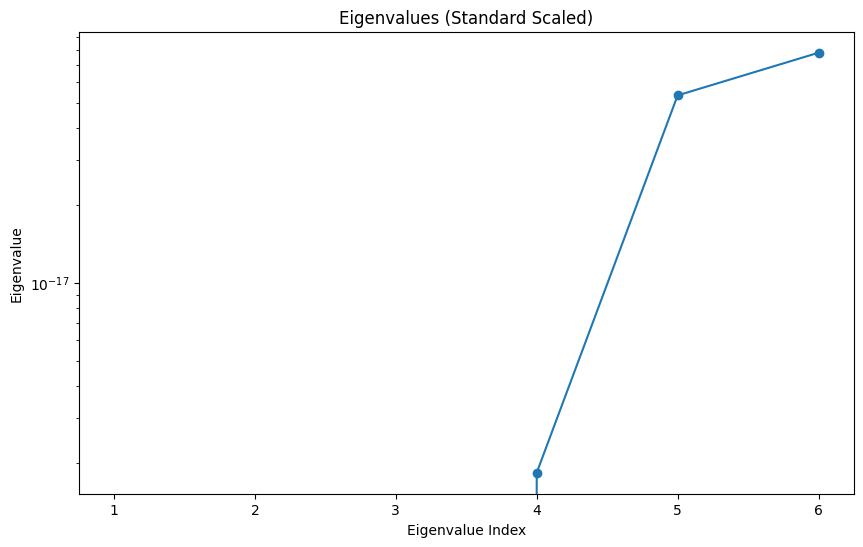

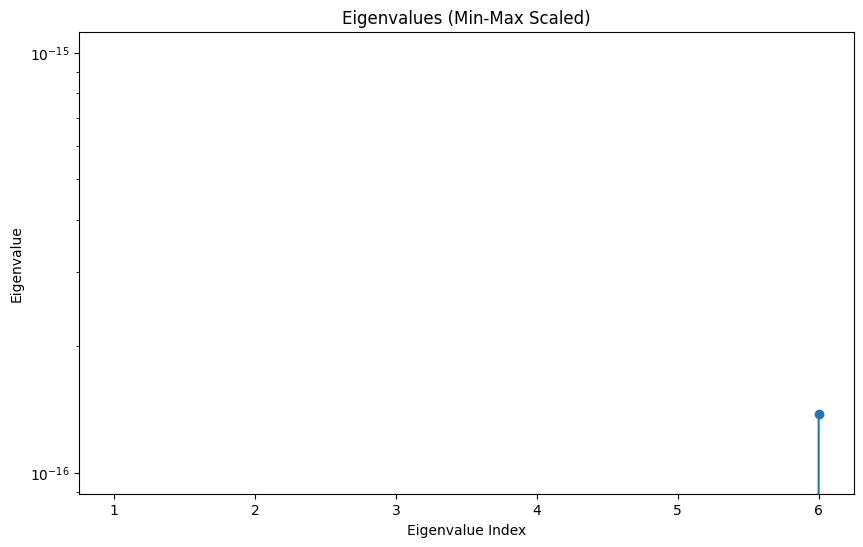

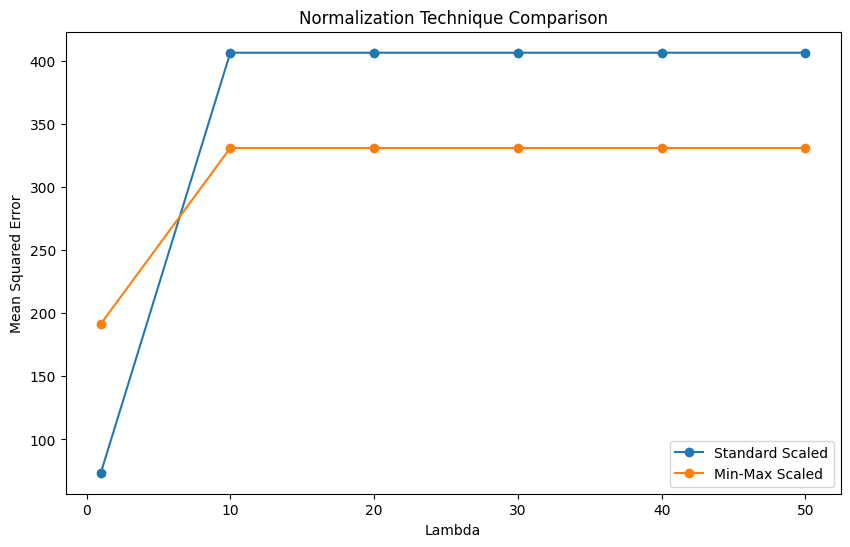

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:,~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [1, 10, 20, 30, 40, 50]
p_values = [5, 10, 20, 30, 40, 50]

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to find optimal p
def find_optimal_p(results):
    optimal_p = sorted(results, key=lambda x: x[2])[0][0]
    return optimal_p

optimal_p_standard = find_optimal_p(results_standard)
optimal_p_minmax = find_optimal_p(results_minmax)

# Function to train Group Lasso model
def train_sglasso(X, Y, lambda_values, p):
    group_indices = []
    group_size = X.shape[1] // p
    for i in range(p):
        start_idx = i * group_size
        end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
        group_indices.extend([i] * (end_idx - start_idx))
    remaining_features = X.shape[1] % p
    if remaining_features > 0:
        group_indices.extend([p] * remaining_features)

    group_indices = np.array(group_indices)

    metrics = []
    models = []  # List to store trained models
    for lam in lambda_values:
        sgl = GroupLasso(
            groups=group_indices,
            group_reg=lam,
            l1_reg=lam,
            frobenius_lipschitz=True,
            scale_reg="group_size",
            subsampling_scheme=1,
            supress_warning=True,
            n_iter=1000,
            tol=1e-3,
            fit_intercept=True,
            random_state=42
        )
        sgl.fit(X, Y)
        Y_pred = sgl.predict(X)
        mse = mean_squared_error(Y, Y_pred)
        r2 = r2_score(Y, Y_pred)
        metrics.append((lam, mse, r2))
        models.append(sgl)  # Store the trained model
    return metrics, models  # Return both metrics and models

# Train with the optimal p for standard scaled data
metrics_standard, models_standard = train_sglasso(X_standard_scaled, Y, lambda_values, optimal_p_standard)
sgl_standard = models_standard[0]  # Assuming you want the first model (corresponding to the first lambda value)

# Train with the optimal p for min-max scaled data
metrics_minmax, models_minmax = train_sglasso(X_minmax_scaled, Y, lambda_values, optimal_p_minmax)
sgl_minmax = models_minmax[0]  # Assuming you want the first model

def plot_feature_importance(sgl, feature_names, title):
    coefficients = sgl.coef_
    # Calculate importance for each target variable separately
    importance = np.abs(coefficients).mean(axis=0)

    num_targets = importance.shape[0]

    plt.figure(figsize=(10, 6 * num_targets))  # Adjust figure size based on number of targets

    for i in range(num_targets):
        plt.subplot(num_targets, 1, i + 1)  # Create subplots for each target
        plt.barh(feature_names, importance[i])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f'{title} - Target {i+1}')
        plt.gca().invert_yaxis()

    plt.tight_layout()  # Adjust spacing between subplots
    plt.show()

def plot_eigenvalues(X, title):
    corr_matrix = np.corrcoef(X, rowvar=False)
    eigenvalues, _ = np.linalg.eig(corr_matrix)
    eigenvalues = sorted(eigenvalues)[:6]

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 7), eigenvalues, marker='o')
    plt.yscale('log')
    plt.xlabel('Eigenvalue Index')
    plt.ylabel('Eigenvalue')
    plt.title(title)
    plt.show()

def plot_normalization_comparison(metrics_standard, metrics_minmax):
    lambda_values = [m[0] for m in metrics_standard]
    mse_standard = [m[1] for m in metrics_standard]
    mse_minmax = [m[1] for m in metrics_minmax]

    plt.figure(figsize=(10, 6))
    plt.plot(lambda_values, mse_standard, label='Standard Scaled', marker='o')
    plt.plot(lambda_values, mse_minmax, label='Min-Max Scaled', marker='o')
    plt.xlabel('Lambda')
    plt.ylabel('Mean Squared Error')
    plt.title('Normalization Technique Comparison')
    plt.legend()
    plt.show()

def plot_smallest_eigenvalues(X, Y, p_values, lambda_values, normalization_type):
    import matplotlib.pyplot as plt
    import numpy as np
    from numpy.linalg import eigvals
    from group_lasso import GroupLasso

    for p in p_values:
        fig, ax = plt.subplots()
        for lam in lambda_values:
            # Define group indices
            group_indices = []
            start_idx = 0
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            # Handle remaining features
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

            group_indices = np.array(group_indices)

            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)

            # Get the selected features
            # Calculate importance for each feature by summing absolute coefficients across targets
            importance = np.abs(sgl.coef_).sum(axis=1)  # Sum across targets to get feature importance
            selected_features = importance != 0  # Select features with non-zero importance

            # Correctly index into X using the boolean mask
            selected_X = X[:, selected_features] # Use boolean indexing to select features

            # Calculate the eigenvalues of the correlation matrix
            if selected_X.shape[1] <= 1:  # Check if less than 2 features are selected
                continue  # Skip if no or only one feature is selected - can't calculate correlation matrix
            corr_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = np.sort(eigvals(corr_matrix))
            smallest_eigenvalues = eigenvalues[:6]

            # Adjust x-values to match the length of smallest_eigenvalues
            x_values = range(1, len(smallest_eigenvalues) + 1)

            # Plot the smallest eigenvalues
            ax.plot(x_values, smallest_eigenvalues, marker='o', label=f'λ={lam}')

        ax.set_yscale('log')
        ax.set_xlabel('Eigenvalue Index')
        ax.set_ylabel('Eigenvalue')
        ax.set_title(f'Smallest Eigenvalues (p={p}, {normalization_type} Scaling)')
        ax.legend()
        plt.show()

# Plotting smallest eigenvalues
plot_smallest_eigenvalues(X_standard_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Standard')
plot_smallest_eigenvalues(X_minmax_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Min-Max')

# Plotting feature importance
plot_feature_importance(sgl_standard, feature_names, 'Feature Importance (Standard Scaled)')
plot_feature_importance(sgl_minmax, feature_names, 'Feature Importance (Min-Max Scaled)')

# Plotting eigenvalues
plot_eigenvalues(X_standard_scaled, 'Eigenvalues (Standard Scaled)')
plot_eigenvalues(X_minmax_scaled, 'Eigenvalues (Min-Max Scaled)')

# Plotting normalization comparison
plot_normalization_comparison(metrics_standard, metrics_minmax)


In [ ]:
pip install jupyter nbconvert


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.4/123.4 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 9.4 MB/s eta 0:00:00


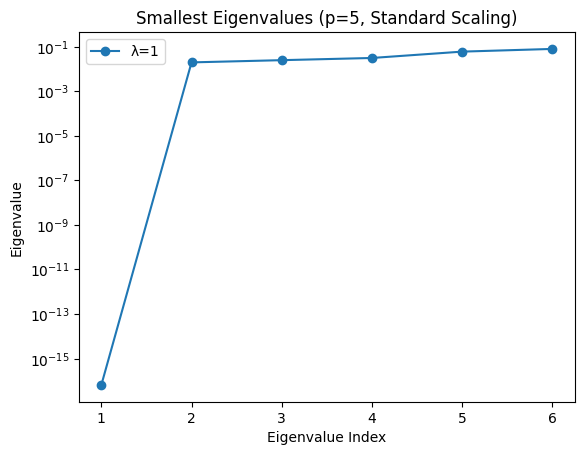

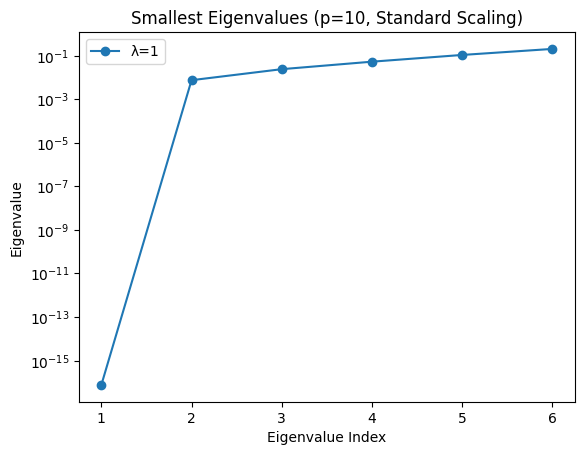

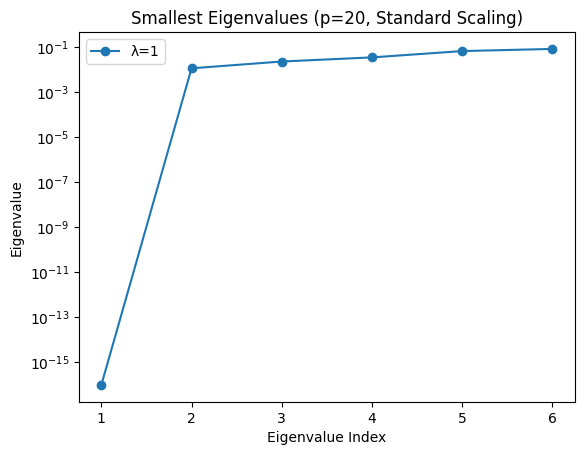

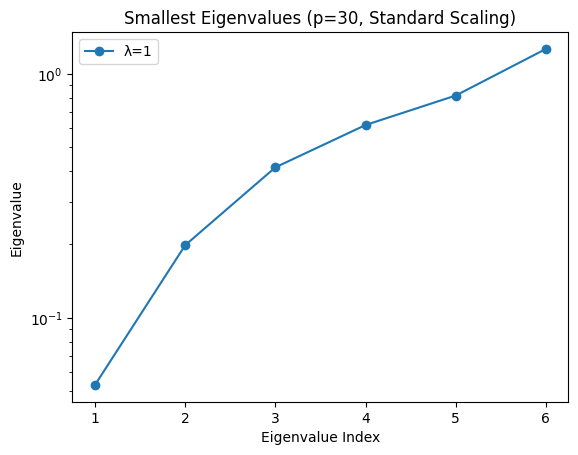

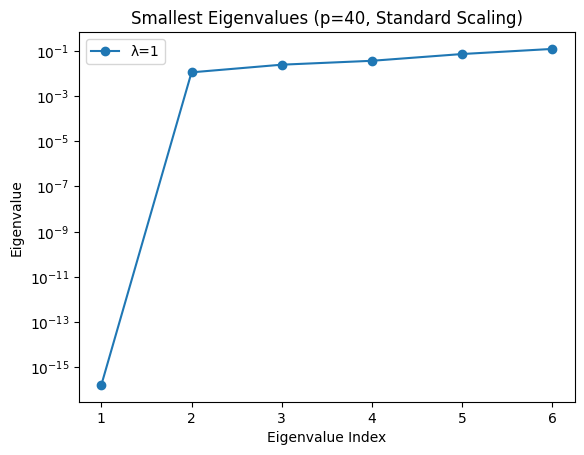

...

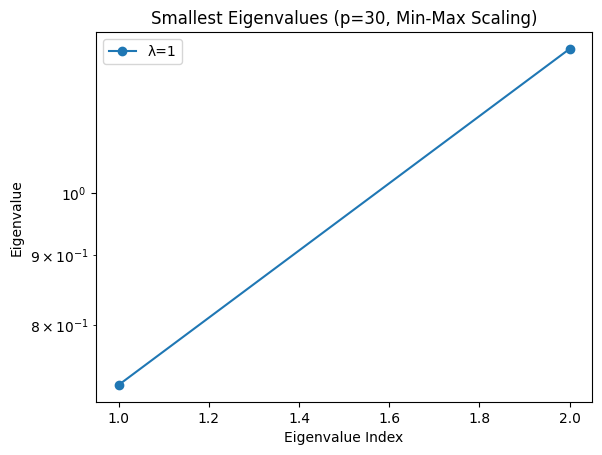

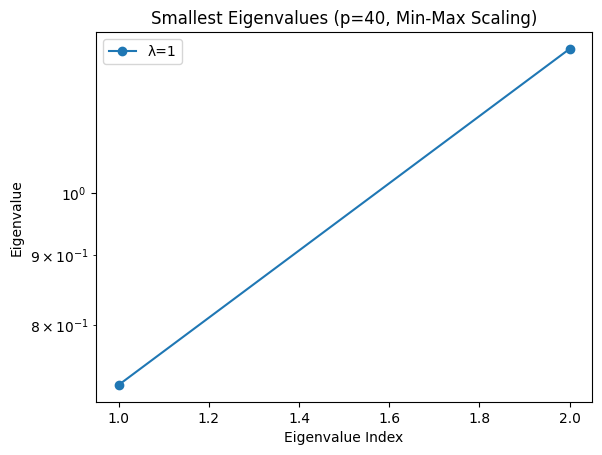

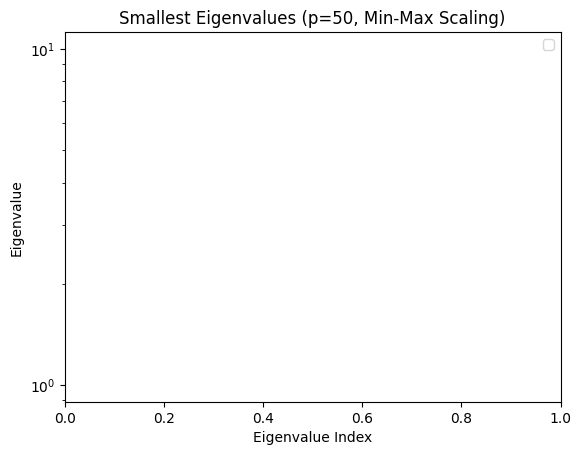

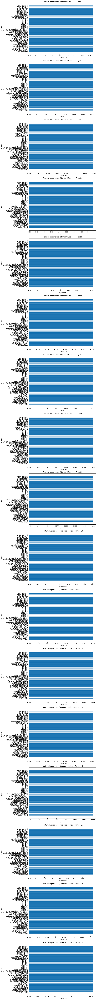

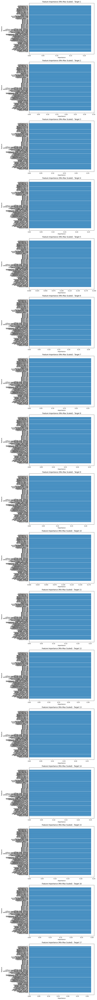

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


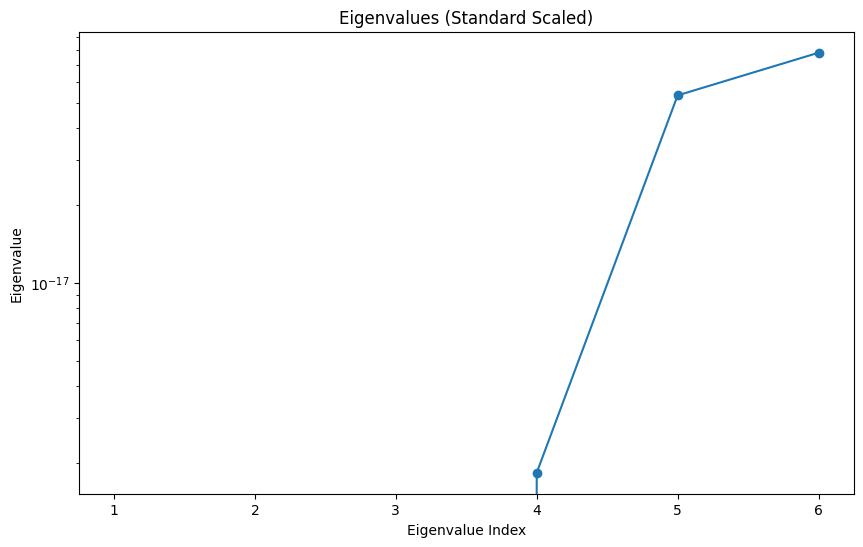

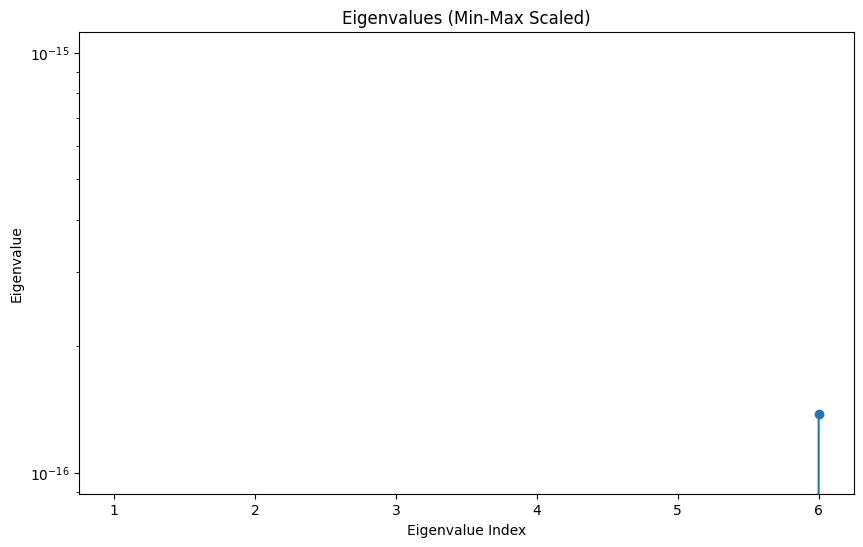

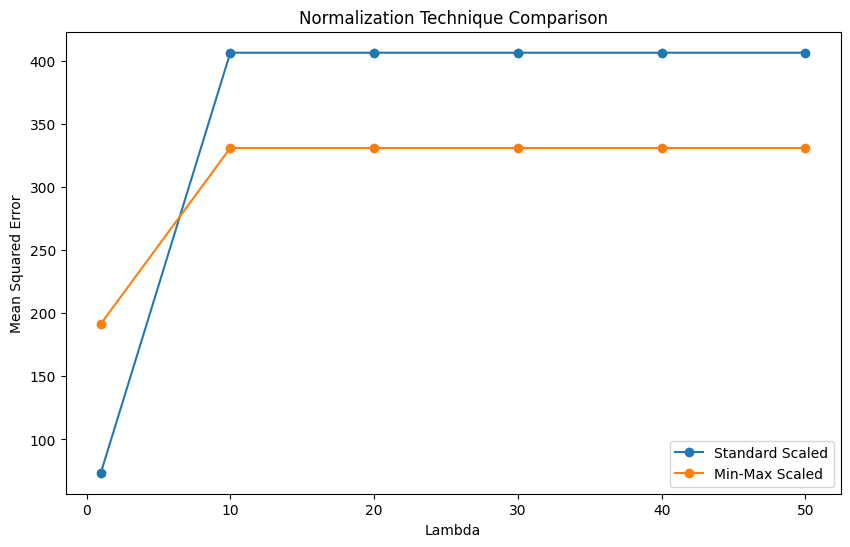

<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-

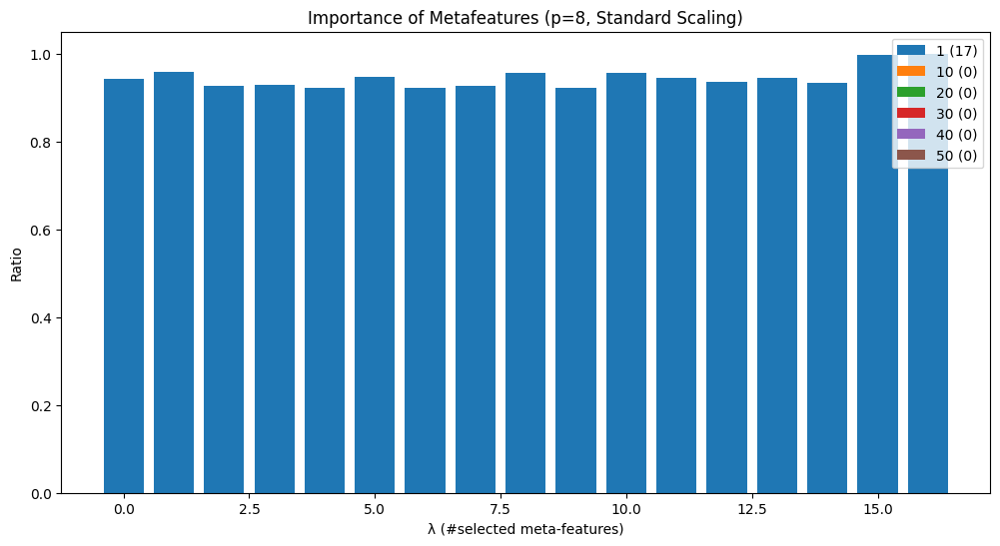

<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-

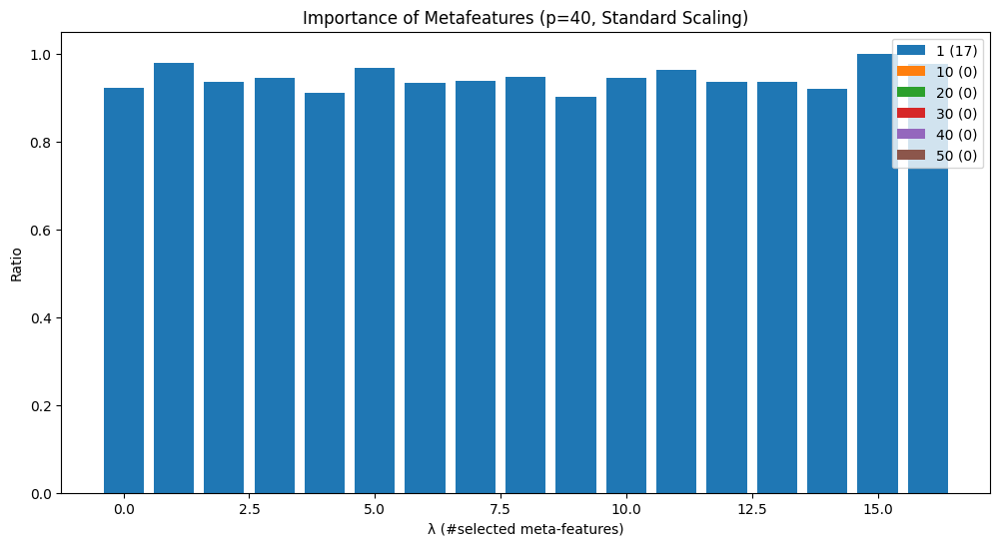

<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-

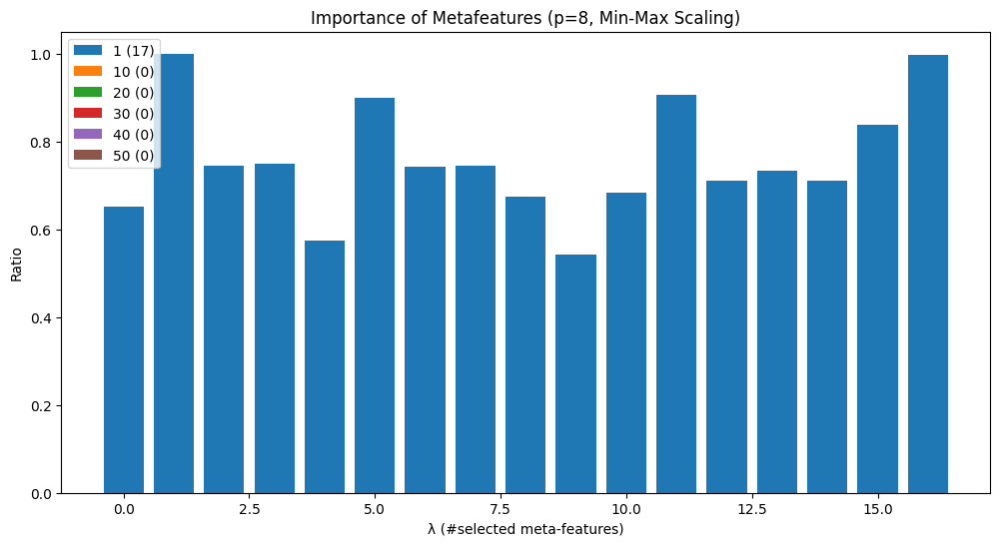

<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-9-570397c6b6b8>:294: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-

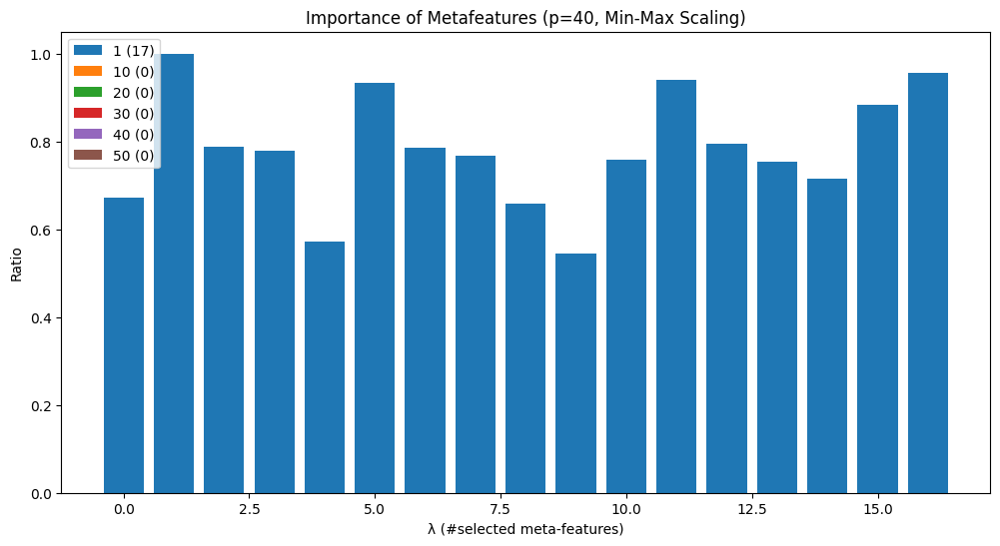

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:,~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [1, 10, 20, 30, 40, 50]
p_values = [5, 10, 20, 30, 40, 50]

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to find optimal p
def find_optimal_p(results):
    optimal_p = sorted(results, key=lambda x: x[2])[0][0]
    return optimal_p

optimal_p_standard = find_optimal_p(results_standard)
optimal_p_minmax = find_optimal_p(results_minmax)

# Function to train Group Lasso model
def train_sglasso(X, Y, lambda_values, p):
    group_indices = []
    group_size = X.shape[1] // p
    for i in range(p):
        start_idx = i * group_size
        end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
        group_indices.extend([i] * (end_idx - start_idx))
    remaining_features = X.shape[1] % p
    if remaining_features > 0:
        group_indices.extend([p] * remaining_features)

    group_indices = np.array(group_indices)

    metrics = []
    models = []  # List to store trained models
    for lam in lambda_values:
        sgl = GroupLasso(
            groups=group_indices,
            group_reg=lam,
            l1_reg=lam,
            frobenius_lipschitz=True,
            scale_reg="group_size",
            subsampling_scheme=1,
            supress_warning=True,
            n_iter=1000,
            tol=1e-3,
            fit_intercept=True,
            random_state=42
        )
        sgl.fit(X, Y)
        Y_pred = sgl.predict(X)
        mse = mean_squared_error(Y, Y_pred)
        r2 = r2_score(Y, Y_pred)
        metrics.append((lam, mse, r2))
        models.append(sgl)  # Store the trained model
    return metrics, models  # Return both metrics and models

# Train with the optimal p for standard scaled data
metrics_standard, models_standard = train_sglasso(X_standard_scaled, Y, lambda_values, optimal_p_standard)
sgl_standard = models_standard[0]  # Assuming you want the first model (corresponding to the first lambda value)

# Train with the optimal p for min-max scaled data
metrics_minmax, models_minmax = train_sglasso(X_minmax_scaled, Y, lambda_values, optimal_p_minmax)
sgl_minmax = models_minmax[0]  # Assuming you want the first model

def plot_feature_importance(sgl, feature_names, title):
    coefficients = sgl.coef_
    # Calculate importance for each target variable separately
    importance = np.abs(coefficients).mean(axis=0)

    num_targets = importance.shape[0]

    plt.figure(figsize=(10, 6 * num_targets))  # Adjust figure size based on number of targets

    for i in range(num_targets):
        plt.subplot(num_targets, 1, i + 1)  # Create subplots for each target
        plt.barh(feature_names, importance[i])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f'{title} - Target {i+1}')
        plt.gca().invert_yaxis()

    plt.tight_layout()  # Adjust spacing between subplots
    plt.show()

def plot_eigenvalues(X, title):
    corr_matrix = np.corrcoef(X, rowvar=False)
    eigenvalues, _ = np.linalg.eig(corr_matrix)
    eigenvalues = sorted(eigenvalues)[:6]

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 7), eigenvalues, marker='o')
    plt.yscale('log')
    plt.xlabel('Eigenvalue Index')
    plt.ylabel('Eigenvalue')
    plt.title(title)
    plt.show()

def plot_normalization_comparison(metrics_standard, metrics_minmax):
    lambda_values = [m[0] for m in metrics_standard]
    mse_standard = [m[1] for m in metrics_standard]
    mse_minmax = [m[1] for m in metrics_minmax]

    plt.figure(figsize=(10, 6))
    plt.plot(lambda_values, mse_standard, label='Standard Scaled', marker='o')
    plt.plot(lambda_values, mse_minmax, label='Min-Max Scaled', marker='o')
    plt.xlabel('Lambda')
    plt.ylabel('Mean Squared Error')
    plt.title('Normalization Technique Comparison')
    plt.legend()
    plt.show()

def plot_smallest_eigenvalues(X, Y, p_values, lambda_values, normalization_type):
    import matplotlib.pyplot as plt
    import numpy as np
    from numpy.linalg import eigvals
    from group_lasso import GroupLasso

    for p in p_values:
        fig, ax = plt.subplots()
        for lam in lambda_values:
            # Define group indices
            group_indices = []
            start_idx = 0
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            # Handle remaining features
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

            group_indices = np.array(group_indices)

            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)

            # Get the selected features
            # Calculate importance for each feature by summing absolute coefficients across targets
            importance = np.abs(sgl.coef_).sum(axis=1)  # Sum across targets to get feature importance
            selected_features = importance != 0  # Select features with non-zero importance

            # Correctly index into X using the boolean mask
            selected_X = X[:, selected_features] # Use boolean indexing to select features

            # Calculate the eigenvalues of the correlation matrix
            if selected_X.shape[1] <= 1:  # Check if less than 2 features are selected
                continue  # Skip if no or only one feature is selected - can't calculate correlation matrix
            corr_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = np.sort(eigvals(corr_matrix))
            smallest_eigenvalues = eigenvalues[:6]

            # Adjust x-values to match the length of smallest_eigenvalues
            x_values = range(1, len(smallest_eigenvalues) + 1)

            # Plot the smallest eigenvalues
            ax.plot(x_values, smallest_eigenvalues, marker='o', label=f'λ={lam}')

        ax.set_yscale('log')
        ax.set_xlabel('Eigenvalue Index')
        ax.set_ylabel('Eigenvalue')
        ax.set_title(f'Smallest Eigenvalues (p={p}, {normalization_type} Scaling)')
        ax.legend()
        plt.show()

# New function to calculate and plot importance ratios
def plot_importance_ratios(X, Y, lambda_values, p_values, feature_names, normalization_type):
    for p in p_values:
        results = []
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)
            importance_ratio = importance / np.max(importance)

            num_selected_features = np.sum(importance > 0)
            results.append((lam, num_selected_features, importance_ratio))

        # Plot results for the current value of p
        plt.figure(figsize=(12, 6))
        for lam, num_selected, importance_ratio in results:
            plt.bar(range(len(importance_ratio)), importance_ratio, label=f'{lam} ({num_selected})')
        plt.xlabel(f'λ (#selected meta-features)')
        plt.ylabel('Ratio')
        plt.title(f'Importance of Metafeatures (p={p}, {normalization_type} Scaling)')
        plt.legend()
        plt.show()

# Plotting smallest eigenvalues
plot_smallest_eigenvalues(X_standard_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Standard')
plot_smallest_eigenvalues(X_minmax_scaled, Y, [5, 10, 20, 30, 40, 50], lambda_values, 'Min-Max')

# Plotting feature importance
plot_feature_importance(sgl_standard, feature_names, 'Feature Importance (Standard Scaled)')
plot_feature_importance(sgl_minmax, feature_names, 'Feature Importance (Min-Max Scaled)')

# Plotting eigenvalues
plot_eigenvalues(X_standard_scaled, 'Eigenvalues (Standard Scaled)')
plot_eigenvalues(X_minmax_scaled, 'Eigenvalues (Min-Max Scaled)')

# Plotting normalization comparison
plot_normalization_comparison(metrics_standard, metrics_minmax)

# Plotting importance ratios
plot_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names, 'Standard')
plot_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names, 'Min-Max')


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:, ~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [1, 10, 20, 30, 40, 50]
p_values = [8, 40]  # Only for p=8 and p=40

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to train Group Lasso model and get importance ratios
def get_importance_ratios(X, Y, lambda_values, p_values, feature_names):
    meta_feature_groups = {
        'complexity': 'Complexity',
        'statistical': 'Statistical',
        'structural': 'Structural',
        'information_theoretic': 'Information Theoretic',
        'model_based': 'Model Based',
        'simple': 'Simple',
        'network': 'Network'
    }

    results = []

    for p in p_values:
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)
            importance_ratio = importance / np.max(importance)
            num_selected_features = np.sum(importance > 0)

            group_importance_ratios = {}
            for group_name, df_name in meta_feature_groups.items():
                # Get the indices of features belonging to this group
                feature_indices = [i for i, name in enumerate(feature_names) if df_name in name]

                # Calculate the mean importance ratio for this group
                if feature_indices:  # Check if any features belong to this group
                    group_importance_ratios[group_name] = np.mean(importance_ratio[feature_indices])
                else:
                    group_importance_ratios[group_name] = 0.0  # Or any default value you prefer

            results.append((p, lam, num_selected_features, group_importance_ratios))

    return results

# Get importance ratios for standard scaled data
importance_ratios_standard = get_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names)
importance_ratios_minmax = get_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names)

# Create DataFrames to display the results
df_standard = pd.DataFrame(importance_ratios_standard, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])
df_minmax = pd.DataFrame(importance_ratios_minmax, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])

# Expand the importance_ratios column into separate columns for each meta-feature group
df_standard = df_standard.join(pd.DataFrame(df_standard.pop('importance_ratios').tolist()))
df_minmax = df_minmax.join(pd.DataFrame(df_minmax.pop('importance_ratios').tolist()))

# Display the DataFrames
print("Standard Scaled Importance Ratios")
print(df_standard)

print("\nMin-Max Scaled Importance Ratios")
print(df_minmax)


<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<i

Standard Scaled Importance Ratios
     p  lambda  num_selected_features  complexity  statistical  structural  \
0    8       1                     17         0.0          0.0         0.0   
1    8      10                      0         0.0          0.0         0.0   
2    8      20                      0         0.0          0.0         0.0   
3    8      30                      0         0.0          0.0         0.0   
4    8      40                      0         0.0          0.0         0.0   
5    8      50                      0         0.0          0.0         0.0   
6   40       1                     17         0.0          0.0         0.0   
7   40      10                      0         0.0          0.0         0.0   
8   40      20                      0         0.0          0.0         0.0   
9   40      30                      0         0.0          0.0         0.0   
10  40      40                      0         0.0          0.0         0.0   
11  40      50                

<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: divide by zero encountered in divide
  importance_ratio = importance / np.max(importance)
<ipython-input-21-c61a3f74872a>:135: RuntimeWarning: invalid value encountered in divide
  importance_ratio = importance / np.max(importance)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:, ~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
    return results

# Apply grid search on standard scaled data
lambda_values = [0.1, 1, 10, 20, 30, 40, 50]
p_values = [8, 40]  # Only for p=8 and p=40

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to train Group Lasso model and get importance ratios
def get_importance_ratios(X, Y, lambda_values, p_values, feature_names):
    meta_feature_groups = {
        'complexity': 'Complexity',
        'statistical': 'Statistical',
        'structural': 'Structural',
        'information_theoretic': 'Information Theoretic',
        'model_based': 'Model Based',
        'simple': 'Simple',
        'network': 'Network'
    }

    results = []

    for p in p_values:
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)

            # Avoid division by zero by checking if max(importance) > 0
            if np.max(importance) > 0:
                importance_ratio = importance / np.max(importance)
            else:
                importance_ratio = importance  # All zeros if no feature is selected

            num_selected_features = np.sum(importance > 0)

            group_importance_ratios = {}
            for group_name, df_name in meta_feature_groups.items():
                # Get the indices of features belonging to this group
                feature_indices = [i for i, name in enumerate(feature_names) if df_name in name]

                # Calculate the mean importance ratio for this group
                if feature_indices:  # Check if any features belong to this group
                    group_importance_ratios[group_name] = np.mean(importance_ratio[feature_indices])
                else:
                    group_importance_ratios[group_name] = 0.0  # Or any default value you prefer

            results.append((p, lam, num_selected_features, group_importance_ratios))

    return results

# Get importance ratios for standard scaled data
importance_ratios_standard = get_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names)
importance_ratios_minmax = get_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names)

# Create DataFrames to display the results
df_standard = pd.DataFrame(importance_ratios_standard, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])
df_minmax = pd.DataFrame(importance_ratios_minmax, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])

# Expand the importance_ratios column into separate columns for each meta-feature group
df_standard = df_standard.join(pd.DataFrame(df_standard.pop('importance_ratios').tolist()))
df_minmax = df_minmax.join(pd.DataFrame(df_minmax.pop('importance_ratios').tolist()))

# Display the DataFrames
print("Standard Scaled Importance Ratios")
print(df_standard)

print("\nMin-Max Scaled Importance Ratios")
print(df_minmax)


Standard Scaled Importance Ratios
     p  lambda  num_selected_features  complexity  statistical  structural  \
0    8     0.1                     17         0.0          0.0         0.0   
1    8     1.0                     17         0.0          0.0         0.0   
2    8    10.0                      0         0.0          0.0         0.0   
3    8    20.0                      0         0.0          0.0         0.0   
4    8    30.0                      0         0.0          0.0         0.0   
5    8    40.0                      0         0.0          0.0         0.0   
6    8    50.0                      0         0.0          0.0         0.0   
7   40     0.1                     17         0.0          0.0         0.0   
8   40     1.0                     17         0.0          0.0         0.0   
9   40    10.0                      0         0.0          0.0         0.0   
10  40    20.0                      0         0.0          0.0         0.0   
11  40    30.0                

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:, ~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Function to print group assignments and coefficients
def print_group_assignments_and_coefficients(group_indices, coefficients):
    print(f"Group Indices: {group_indices}")
    print(f"Coefficients: {coefficients}")

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
            # Print group assignments and coefficients
            print_group_assignments_and_coefficients(group_indices, sgl.coef_)
    return results

# Apply grid search on standard scaled data
lambda_values = [0.001, 0.01, 0.1, 1, 10, 20, 30]  # Include smaller lambda values
p_values = [8, 40]  # Only for p=8 and p=40

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to train Group Lasso model and get importance ratios
def get_importance_ratios(X, Y, lambda_values, p_values, feature_names):
    meta_feature_groups = {
        'complexity': 'Complexity',
        'statistical': 'Statistical',
        'structural': 'Structural',
        'information_theoretic': 'Information Theoretic',
        'model_based': 'Model Based',
        'simple': 'Simple',
        'network': 'Network'
    }

    results = []

    for p in p_values:
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)

            # Avoid division by zero by checking if max(importance) > 0
            if np.max(importance) > 0:
                importance_ratio = importance / np.max(importance)
            else:
                importance_ratio = importance  # All zeros if no feature is selected

            num_selected_features = np.sum(importance > 0)

            group_importance_ratios = {}
            for group_name, df_name in meta_feature_groups.items():
                # Get the indices of features belonging to this group
                feature_indices = [i for i, name in enumerate(feature_names) if df_name in name]

                # Calculate the mean importance ratio for this group
                if feature_indices:  # Check if any features belong to this group
                    group_importance_ratios[group_name] = np.mean(importance_ratio[feature_indices])
                else:
                    group_importance_ratios[group_name] = 0.0  # Or any default value you prefer

            results.append((p, lam, num_selected_features, group_importance_ratios))

    return results

# Get importance ratios for standard scaled data
importance_ratios_standard = get_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names)
importance_ratios_minmax = get_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names)

# Create DataFrames to display the results
df_standard = pd.DataFrame(importance_ratios_standard, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])
df_minmax = pd.DataFrame(importance_ratios_minmax, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])

# Expand the importance_ratios column into separate columns for each meta-feature group
df_standard = df_standard.join(pd.DataFrame(df_standard.pop('importance_ratios').tolist()))
df_minmax = df_minmax.join(pd.DataFrame(df_minmax.pop('importance_ratios').tolist()))

# Display the DataFrames
print("Standard Scaled Importance Ratios")
print(df_standard)

print("\nMin-Max Scaled Importance Ratios")
print(df_minmax)


Group Indices: [0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3
 3 3 3 3 3 3 3 4 4 4 4 4 4 4 4 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6
 6 6 6 7 7 7 7 7 7 7 7 7 7 7]
Coefficients: [[-1.99055163 -1.68475769 -1.89817806 ... -1.17473341 -2.01760934
  -1.54275316]
 [-1.71736605  0.67691394  1.36265972 ...  0.90527897  0.8367941
   1.74676615]
 [-0.8385755   0.97060209  0.23875013 ... -1.85340354 -0.04856191
   0.40072781]
 ...
 [ 2.46000413 -2.21204746 -2.20591581 ... -4.22637443 -2.24316643
  -3.25181554]
 [-1.28718538  0.73731875  0.46662351 ...  0.31904809 -0.51142506
   0.27289934]
 [ 1.19596422  2.21631744 -0.18983694 ...  0.65945992  0.2886419
  -0.21732679]]
Group Indices: [0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3
 3 3 3 3 3 3 3 4 4 4 4 4 4 4 4 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6
 6 6 6 7 7 7 7 7 7 7 7 7 7 7]
Coefficients: [[-1.80553873 -1.46489983 -1.55840387 ... -1.01410198 -1.84888211
  -1.33726942]
 [-1.398134

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:, ~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Function to print group assignments and coefficients
def print_group_assignments_and_coefficients(group_indices, coefficients):
    print(f"Group Indices: {group_indices}")
    print(f"Coefficients: {coefficients}")

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
            # Print group assignments and coefficients
            print_group_assignments_and_coefficients(group_indices, sgl.coef_)
    return results

# Apply grid search on standard scaled data
lambda_values = [0.001, 0.01, 0.1, 1, 10, 20, 30]  # Include smaller lambda values
p_values = [8, 40]  # Only for p=8 and p=40

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values)

# Function to train Group Lasso model and get importance ratios
def get_importance_ratios(X, Y, lambda_values, p_values, feature_names):
    meta_feature_groups = {
        'complexity': 'Complexity',
        'statistical': 'Statistical',
        'structural': 'Structural',
        'information_theoretic': 'Information Theoretic',
        'model_based': 'Model Based',
        'simple': 'Simple',
        'network': 'Network'
    }

    results = []

    for p in p_values:
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)

            # Avoid division by zero by checking if max(importance) > 0
            if np.max(importance) > 0:
                importance_ratio = importance / np.max(importance)
            else:
                importance_ratio = importance  # All zeros if no feature is selected

            num_selected_features = np.sum(importance > 0)

            group_importance_ratios = {}
            for group_name, df_name in meta_feature_groups.items():
                # Get the indices of features belonging to this group
                feature_indices = [i for i, name in enumerate(feature_names) if df_name in name]

                # Calculate the mean importance ratio for this group
                if feature_indices:  # Check if any features belong to this group
                    group_importance_ratios[group_name] = np.mean(importance_ratio[feature_indices])
                else:
                    group_importance_ratios[group_name] = 0.0  # Or any default value you prefer

            results.append((p, lam, num_selected_features, group_importance_ratios))

    return results

# Get importance ratios for standard scaled data
importance_ratios_standard = get_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names)
importance_ratios_minmax = get_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names)

# Create DataFrames to display the results
df_standard = pd.DataFrame(importance_ratios_standard, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])
df_minmax = pd.DataFrame(importance_ratios_minmax, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])

# Expand the importance_ratios column into separate columns for each meta-feature group
df_standard = df_standard.join(pd.DataFrame(df_standard.pop('importance_ratios').tolist()))
df_minmax = df_minmax.join(pd.DataFrame(df_minmax.pop('importance_ratios').tolist()))

# Display the DataFrames
print("Standard Scaled Importance Ratios")
print(df_standard)

print("\nMin-Max Scaled Importance Ratios")
print(df_minmax)


Group Indices: [0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3
 3 3 3 3 3 3 3 4 4 4 4 4 4 4 4 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6
 6 6 6 7 7 7 7 7 7 7 7 7 7 7]
Coefficients: [[-1.99055163 -1.68475769 -1.89817806 ... -1.17473341 -2.01760934
  -1.54275316]
 [-1.71736605  0.67691394  1.36265972 ...  0.90527897  0.8367941
   1.74676615]
 [-0.8385755   0.97060209  0.23875013 ... -1.85340354 -0.04856191
   0.40072781]
 ...
 [ 2.46000413 -2.21204746 -2.20591581 ... -4.22637443 -2.24316643
  -3.25181554]
 [-1.28718538  0.73731875  0.46662351 ...  0.31904809 -0.51142506
   0.27289934]
 [ 1.19596422  2.21631744 -0.18983694 ...  0.65945992  0.2886419
  -0.21732679]]
Group Indices: [0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3
 3 3 3 3 3 3 3 4 4 4 4 4 4 4 4 4 4 4 5 5 5 5 5 5 5 5 5 5 5 6 6 6 6 6 6 6 6
 6 6 6 7 7 7 7 7 7 7 7 7 7 7]
Coefficients: [[-1.80553873 -1.46489983 -1.55840387 ... -1.01410198 -1.84888211
  -1.33726942]
 [-1.398134

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score

# Load data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}
meta_features_groups = {
    0: ['overlapping.F1', 'overlapping.F1v', 'overlapping.F2', 'overlapping.F3', 'overlapping.F4', 'neighborhood.N1', 'neighborhood.N2', 'neighborhood.N3', 'neighborhood.N4', 'neighborhood.T1', 'neighborhood.LSC'],
    1: ['linearity.class.L1', 'linearity.class.L2', 'linearity.class.L3', 'dimensionality.T2', 'dimensionality.T3', 'dimensionality.T4', 'balance.C1', 'balance.C2', 'statistical.skewness', 'statistical.skewness_prep', 'statistical.kurtosis'],
    2: ['statistical.kurtosis_prep', 'statistical.abs_cor', 'statistical.cancor_1', 'statistical.fract_1', 'struct_X1', 'struct_X2', 'struct_X3', 'struct_X4', 'struct_X5', 'struct_X6', 'struct_X7'],
    3: ['struct_X8', 'struct_X9', 'struct_X10', 'struct_X11', 'struct_X12', 'struct_X13', 'struct_X14', 'struct_X15', 'struct_X16', 'struct_X17', 'struct_X18'],
    4: ['inftheo.class_entropy', 'inftheo.normalized_class_entropy', 'inftheo.attribute_entropy', 'inftheo.normalized_attribute_entropy', 'inftheo.joint_entropy', 'inftheo.mutual_information', 'inftheo.equivalent_attributes', 'inftheo.noise_signal_ratio', 'modelbased.nodes', 'modelbased.leaves', 'modelbased.nodes_per_attribute'],
    5: ['modelbased.nodes_per_instance', 'modelbased.leaf_corrobation', 'modelbased.level_min', 'modelbased.level_max', 'modelbased.level_mean', 'modelbased.level_sd', 'modelbased.branch_min', 'modelbased.branch_max', 'modelbased.branch_mean', 'modelbased.branch_sd', 'modelbased.attribute_min'],
    6: ['modelbased.attribute_max', 'modelbased.attribute_sd', 'simple.classes', 'simple.attributes', 'simple.numeric', 'simple.nominal', 'simple.samples', 'simple.dimensionality', 'simple.numeric_rate', 'simple.nominal_rate', 'simple.symbols_min', 'simple.symbols_max', 'simple.symbols_mean', 'simple.symbols_sd', 'simple.symbols_sum', 'simple.class_prob_min', 'simple.class_prob_max', 'simple.class_prob_mean', 'simple.class_prob_sd', 'network.Density', 'network.ClsCoef', 'network.Hubs']
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]
X.fillna(X.mean(), inplace=True)

# Remove repetitive measures
def remove_repetitive_measures(df):
    return df.loc[:, ~df.T.duplicated(keep='first')]

X = remove_repetitive_measures(X)

# Feature names before scaling
feature_names = X.columns.tolist()

# Scaling
scaler_standard = StandardScaler()
X_standard_scaled = scaler_standard.fit_transform(X)
scaler_minmax = MinMaxScaler()
X_minmax_scaled = scaler_minmax.fit_transform(X)

# Function to print group assignments and coefficients
def print_group_assignments_and_coefficients(group_indices, coefficients, feature_names):
    for group in np.unique(group_indices):
        group_features = [feature_names[i] for i in np.where(group_indices == group)[0]]
        print(f"Group {group}: {group_features}")
    print(f"Coefficients: {coefficients}")

# Grid search function
def grid_search_p(X, Y, lambda_values, p_values, feature_names):
    results = []
    for p in p_values:
        # Create groups for Group Lasso
        group_indices = []
        group_size = X.shape[1] // p
        for i in range(p):
            start_idx = i * group_size
            end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
            group_indices.extend([i] * (end_idx - start_idx))
        # Handle remaining features
        remaining_features = X.shape[1] % p
        if remaining_features > 0:
            group_indices.extend([p] * remaining_features)  # Assign remaining features to a new group

        group_indices = np.array(group_indices)

        for lam in lambda_values:
            # Train Group Lasso model
            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            Y_pred = sgl.predict(X)
            mse = mean_squared_error(Y, Y_pred)
            r2 = r2_score(Y, Y_pred)
            results.append((p, lam, mse, r2))
            # Print group assignments and coefficients
            print_group_assignments_and_coefficients(group_indices, sgl.coef_, feature_names)
    return results

# Apply grid search on standard scaled data
lambda_values = [0.001, 0.01, 0.1, 1, 10, 20, 30]  # Include smaller lambda values
p_values = [8, 40]  # Only for p=8 and p=40

results_standard = grid_search_p(X_standard_scaled, Y, lambda_values, p_values, feature_names)
results_minmax = grid_search_p(X_minmax_scaled, Y, lambda_values, p_values, feature_names)

# Function to train Group Lasso model and get importance ratios
def get_importance_ratios(X, Y, lambda_values, p_values, feature_names):
    meta_feature_groups = {
        'complexity': 'Complexity',
        'statistical': 'Statistical',
        'structural': 'Structural',
        'information_theoretic': 'Information Theoretic',
        'model_based': 'Model Based',
        'simple': 'Simple',
        'network': 'Network'
    }

    results = []

    for p in p_values:
        for lam in lambda_values:
            group_indices = []
            group_size = X.shape[1] // p
            for i in range(p):
                start_idx = i * group_size
                end_idx = (i + 1) * group_size if (i + 1) * group_size <= X.shape[1] else X.shape[1]
                group_indices.extend([i] * (end_idx - start_idx))
            remaining_features = X.shape[1] % p
            if remaining_features > 0:
                group_indices.extend([p] * remaining_features)
            group_indices = np.array(group_indices)

            sgl = GroupLasso(
                groups=group_indices,
                group_reg=lam,
                l1_reg=lam,
                frobenius_lipschitz=True,
                scale_reg="group_size",
                subsampling_scheme=1,
                supress_warning=True,
                n_iter=1000,
                tol=1e-3,
                fit_intercept=True,
                random_state=42
            )
            sgl.fit(X, Y)
            coefficients = sgl.coef_
            importance = np.abs(coefficients).mean(axis=0)

            # Avoid division by zero by checking if max(importance) > 0
            if np.max(importance) > 0:
                importance_ratio = importance / np.max(importance)
            else:
                importance_ratio = importance  # All zeros if no feature is selected

            num_selected_features = np.sum(importance > 0)

            group_importance_ratios = {}
            for group_name, df_name in meta_feature_groups.items():
                # Get the indices of features belonging to this group
                feature_indices = [i for i, name in enumerate(feature_names) if df_name in name]

                # Calculate the mean importance ratio for this group
                if feature_indices:  # Check if any features belong to this group
                    group_importance_ratios[group_name] = np.mean(importance_ratio[feature_indices])
                else:
                    group_importance_ratios[group_name] = 0.0  # Or any default value you prefer

            results.append((p, lam, num_selected_features, group_importance_ratios))

    return results

# Get importance ratios for standard scaled data
importance_ratios_standard = get_importance_ratios(X_standard_scaled, Y, lambda_values, [8, 40], feature_names)
importance_ratios_minmax = get_importance_ratios(X_minmax_scaled, Y, lambda_values, [8, 40], feature_names)

# Create DataFrames to display the results
df_standard = pd.DataFrame(importance_ratios_standard, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])
df_minmax = pd.DataFrame(importance_ratios_minmax, columns=['p', 'lambda', 'num_selected_features', 'importance_ratios'])

# Expand the importance_ratios column into separate columns for each meta-feature group
df_standard = df_standard.join(pd.DataFrame(df_standard.pop('importance_ratios').tolist()))
df_minmax = df_minmax.join(pd.DataFrame(df_minmax.pop('importance_ratios').tolist()))

# Display the DataFrames
print("Standard Scaled Importance Ratios")
print(df_standard)

print("\nMin-Max Scaled Importance Ratios")
print(df_minmax)


Group 0: ['overlapping.F1', 'overlapping.F1v', 'overlapping.F2', 'overlapping.F3', 'overlapping.F4', 'neighborhood.N1', 'neighborhood.N2', 'neighborhood.N3', 'neighborhood.N4', 'neighborhood.T1', 'neighborhood.LSC']
Group 1: ['linearity.class.L1', 'linearity.class.L2', 'linearity.class.L3', 'dimensionality.T2', 'dimensionality.T3', 'dimensionality.T4', 'balance.C1', 'balance.C2', 'statistical.skewness', 'statistical.skewness_prep', 'statistical.kurtosis']
Group 2: ['statistical.kurtosis_prep', 'statistical.abs_cor', 'statistical.cancor_1', 'statistical.fract_1', 'struct_X1', 'struct_X2', 'struct_X3', 'struct_X4', 'struct_X5', 'struct_X6', 'struct_X7']
Group 3: ['struct_X8', 'struct_X9', 'struct_X10', 'struct_X11', 'struct_X12', 'struct_X13', 'struct_X14', 'struct_X15', 'struct_X16', 'struct_X17', 'struct_X18']
Group 4: ['inftheo.class_entropy', 'inftheo.normalized_class_entropy', 'inftheo.attribute_entropy', 'inftheo.normalized_attribute_entropy', 'inftheo.joint_entropy', 'inftheo.mutu

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
import numpy as np
from sklearn.linear_model import MultiTaskLassoCV

# Define the meta-features files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_groups = {}
all_meta_features = pd.DataFrame()
datasets_column = None

# Read and concatenate meta-features
for group, file in meta_features_files.items():
    df = pd.read_excel(file)
    if datasets_column is None:
        datasets_column = df['Datasets']
    df = df.drop(columns=['Datasets'])
    meta_features_groups[group] = df.columns.tolist()
    all_meta_features = pd.concat([all_meta_features, df], axis=1)

# Separate numeric columns
numeric_meta_features = all_meta_features.select_dtypes(include=[np.number])

# Normalize only the numeric columns
scaler = StandardScaler()
normalized_numeric_meta_features = pd.DataFrame(scaler.fit_transform(numeric_meta_features), columns=numeric_meta_features.columns)

# Combine normalized numeric features with the 'Datasets' column for identification
normalized_meta_features = pd.concat([datasets_column.reset_index(drop=True), normalized_numeric_meta_features], axis=1)

# Print the normalized meta-feature groups
print(meta_features_groups)
print(normalized_meta_features.head())

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')  # Ensure the filename is correct

# Ensure 'Datasets' column is used to align performance data with meta-features
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure that the meta-features and performance data are aligned
aligned_meta_features = normalized_meta_features.loc[performance_data.index]

# Extract features and target variables
X = aligned_meta_features.values
Y = performance_data.values

# Create group indices mapping
group_indices = {group: [aligned_meta_features.columns.get_loc(feature) for feature in features if feature in aligned_meta_features.columns] for group, features in meta_features_groups.items()}

# Train Multivariate Lasso (MultiTaskLassoCV) model
model = MultiTaskLassoCV(cv=5)
model.fit(X, Y)

# Extract coefficients and selected features
coefs = model.coef_
selected_features = np.where(coefs != 0)

# Print the selected features and coefficients
print("Selected Features:")
for idx in selected_features:
    print(aligned_meta_features.columns[idx])

print("Coefficients:")
print(coefs)

# Map selected features to their groups
group_feature_selection = {k: [] for k in group_indices.keys()}
for feature in selected_features[1]:
    for group, indices in group_indices.items():
        if feature in indices:
            group_feature_selection[group].append(feature)
            break

print("Group Feature Selection:")
print(group_feature_selection)


{'complexity': ['overlapping.F1', 'overlapping.F1v', 'overlapping.F2', 'overlapping.F3', 'overlapping.F4', 'neighborhood.N1', 'neighborhood.N2', 'neighborhood.N3', 'neighborhood.N4', 'neighborhood.T1', 'neighborhood.LSC', 'linearity.class.L1', 'linearity.class.L2', 'linearity.class.L3', 'dimensionality.T2', 'dimensionality.T3', 'dimensionality.T4', 'balance.C1', 'balance.C2'], 'statistical': ['statistical.skewness', 'statistical.skewness_prep', 'statistical.kurtosis', 'statistical.kurtosis_prep', 'statistical.abs_cor', 'statistical.cancor_1', 'statistical.fract_1'], 'structural': ['struct_X1', 'struct_X2', 'struct_X3', 'struct_X4', 'struct_X5', 'struct_X6', 'struct_X7', 'struct_X8', 'struct_X9', 'struct_X10', 'struct_X11', 'struct_X12', 'struct_X13', 'struct_X14', 'struct_X15', 'struct_X16', 'struct_X17', 'struct_X18'], 'information_theoretic': ['inftheo.class_entropy', 'inftheo.normalized_class_entropy', 'inftheo.attribute_entropy', 'inftheo.normalized_attribute_entropy', 'inftheo.joi

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import MultiTaskLassoCV

# Load the meta-feature data files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for group, file in meta_features_files.items():
    df = pd.read_excel(file)
    df.set_index('Datasets', inplace=True)
    meta_features[group] = df

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)

# Combine all meta-features into one DataFrame
combined_meta_features = pd.concat(meta_features.values(), axis=1)
combined_meta_features.drop(columns=['Datasets'], inplace=True, errors='ignore')

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = pd.DataFrame(scaler.fit_transform(combined_meta_features), columns=combined_meta_features.columns, index=combined_meta_features.index)

# Ensure that the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
y = performance_data.values

# Define function to train SGLasso for each dependent variable
def train_sglasso(X, y, group_indices, lambdas):
    results = {}
    for lmbda in lambdas:
        model = MultiTaskLassoCV(alphas=[lmbda], cv=5, max_iter=10000)
        model.fit(X, y)
        results[lmbda] = model.coef_
    return results

# Create a dictionary to store the indices of each group in the combined meta-features DataFrame
group_indices = {}
start_idx = 0
for group, df in meta_features.items():
    end_idx = start_idx + df.shape[1]
    group_indices[group] = list(range(start_idx, end_idx))
    start_idx = end_idx

# Define the lambda values to test
lambdas = [0.001, 0.01, 0.1, 1.0, 10.0, 20.0, 30.0]

# Train SGLasso on normalized numeric meta-features
sglasso_results = train_sglasso(X, y, group_indices, lambdas)

# Create a DataFrame to store the results
results_df = pd.DataFrame(columns=['p', 'lambda', 'num_selected_features'] + list(meta_features.keys()))

# Calculate the number of selected features for each group
results_list = []  # Create a list to hold the results

for p in [7, 40]:
    for lmbda, coefs in sglasso_results.items():
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        # Append the results as a dictionary to the list
        results_list.append({'p': p, 'lambda': lmbda, 'num_selected_features': num_selected_features, **group_counts})

# Create the DataFrame from the list of results
results_df = pd.DataFrame(results_list)

print(results_df)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74.56525914122372, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74.04447509789, tolerance: 41.68345118040483
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 86.18393712755446, tolerance: 27.04353183309733
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609

     p  lambda  num_selected_features  complexity  statistical  structural  \
0    7   0.001                     89          19            7          18   
1    7   0.010                     86          19            7          18   
2    7   0.100                     84          19            7          18   
3    7   1.000                     46          15            3           9   
4    7  10.000                      8           3            0           0   
5    7  20.000                      2           2            0           0   
6    7  30.000                      2           2            0           0   
7   40   0.001                     89          19            7          18   
8   40   0.010                     86          19            7          18   
9   40   0.100                     84          19            7          18   
10  40   1.000                     46          15            3           9   
11  40  10.000                      8           3            0  

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import MultiTaskLassoCV
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

# Load the meta-feature data files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for group, file in meta_features_files.items():
    df = pd.read_excel(file)
    df.set_index('Datasets', inplace=True)
    meta_features[group] = df

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)

# Combine all meta-features into one DataFrame
combined_meta_features = pd.concat(meta_features.values(), axis=1)
combined_meta_features.drop(columns=['Datasets'], inplace=True, errors='ignore')

# Preprocessing steps
# 1) Min-max scaling
scaler = MinMaxScaler()
combined_meta_features_scaled = pd.DataFrame(scaler.fit_transform(combined_meta_features), columns=combined_meta_features.columns, index=combined_meta_features.index)

# 2) Remove measures with missing values
combined_meta_features_scaled = combined_meta_features_scaled.dropna(axis=1)

# 3) Remove repetitive measures
combined_meta_features_scaled = combined_meta_features_scaled.loc[:,~combined_meta_features_scaled.T.duplicated(keep='first')]

# Ensure that the meta-features and performance data are aligned
X = combined_meta_features_scaled.loc[performance_data.index].values
y = performance_data.values

# Define function to train SGLasso for each dependent variable
def train_sglasso(X, y, group_indices, lambdas):
    results = {}
    for lmbda in lambdas:
        model = MultiTaskLassoCV(alphas=[lmbda], cv=5, max_iter=10000)
        model.fit(X, y)
        results[lmbda] = model.coef_
    return results

# Create a dictionary to store the indices of each group in the combined meta-features DataFrame
group_indices = {}
start_idx = 0
for group, df in meta_features.items():
    valid_columns = [col for col in df.columns if col in combined_meta_features_scaled.columns]
    end_idx = start_idx + len(valid_columns)
    group_indices[group] = list(range(start_idx, end_idx))
    start_idx = end_idx

# Define the lambda values to test
lambdas = [0.001, 0.01, 0.1, 1.0, 10.0, 20.0, 30.0]

# Train SGLasso on normalized numeric meta-features
sglasso_results = train_sglasso(X, y, group_indices, lambdas)

# Create a DataFrame to store the results
results_df = pd.DataFrame(columns=['p', 'lambda', 'num_selected_features'] + list(meta_features.keys()))

# Create a hyperparameter grid for p and lambda
param_grid = {
    'p': [7, 40],
    'lambda': lambdas
}

# Initialize results list
results_list = []

for p in param_grid['p']:
    for lmbda in param_grid['lambda']:
        coefs = sglasso_results[lmbda]
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list.append({'p': p, 'lambda': lmbda, 'num_selected_features': num_selected_features, **group_counts})

# Create the DataFrame from the list of results
results_df = pd.DataFrame(results_list)

print(results_df)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 68.77098792603724, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 183.7934052662928, tolerance: 41.68345118040483
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 178.4516438539637, tolerance: 27.04353183309733
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:

     p  lambda  num_selected_features  complexity  statistical  structural  \
0    7   0.001                     85          19            7          18   
1    7   0.010                     81          19            6          17   
2    7   0.100                     56          17            5           9   
3    7   1.000                     16           5            1           0   
4    7  10.000                      1           1            0           0   
5    7  20.000                      0           0            0           0   
6    7  30.000                      0           0            0           0   
7   40   0.001                     85          19            7          18   
8   40   0.010                     81          19            6          17   
9   40   0.100                     56          17            5           9   
10  40   1.000                     16           5            1           0   
11  40  10.000                      1           1            0  

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import MultiTaskLassoCV
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

# Load the meta-feature data files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for group, file in meta_features_files.items():
    df = pd.read_excel(file)
    df.set_index('Datasets', inplace=True)
    meta_features[group] = df

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)

# Combine all meta-features into one DataFrame
combined_meta_features = pd.concat(meta_features.values(), axis=1)
combined_meta_features.drop(columns=['Datasets'], inplace=True, errors='ignore')

# Preprocessing steps
# 1) Min-max scaling
scaler = MinMaxScaler()
combined_meta_features_scaled = pd.DataFrame(scaler.fit_transform(combined_meta_features), columns=combined_meta_features.columns, index=combined_meta_features.index)

# 2) Remove measures with missing values
combined_meta_features_scaled = combined_meta_features_scaled.dropna(axis=1)

# 3) Remove repetitive measures
combined_meta_features_scaled = combined_meta_features_scaled.loc[:,~combined_meta_features_scaled.T.duplicated(keep='first')]

# Ensure that the meta-features and performance data are aligned
X = combined_meta_features_scaled.loc[performance_data.index].values
y = performance_data.values

# Define function to train SGLasso for each dependent variable
def train_sglasso(X, y, group_indices, lambdas):
    results = {}
    for lmbda in lambdas:
        model = MultiTaskLassoCV(alphas=[lmbda], cv=5, max_iter=10000)
        model.fit(X, y)
        results[lmbda] = model.coef_
    return results

# Create a dictionary to store the indices of each group in the combined meta-features DataFrame
group_indices = {}
start_idx = 0
for group, df in meta_features.items():
    valid_columns = [col for col in df.columns if col in combined_meta_features_scaled.columns]
    end_idx = start_idx + len(valid_columns)
    group_indices[group] = list(range(start_idx, end_idx))
    start_idx = end_idx

# Define the lambda values to test
lambdas = [0.001, 0.01, 0.1, 1.0, 10.0, 20.0, 30.0]

# Train SGLasso on normalized numeric meta-features
sglasso_results = train_sglasso(X, y, group_indices, lambdas)

# Create a DataFrame to store the results
results_df = pd.DataFrame(columns=['p', 'lambda', 'num_selected_features'] + list(meta_features.keys()))

# Create a hyperparameter grid for p and lambda
param_grid = {
    'p': [7, 40],
    'lambda': lambdas
}

# Initialize results list
results_list = []

for p in param_grid['p']:
    for lmbda in param_grid['lambda']:
        coefs = sglasso_results[lmbda]
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list.append({'p': p, 'lambda': lmbda, 'num_selected_features': num_selected_features, **group_counts})

# Create the DataFrame from the list of results
results_df = pd.DataFrame(results_list)

print(results_df)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 68.77098792603724, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 183.7934052662928, tolerance: 41.68345118040483
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 178.4516438539637, tolerance: 27.04353183309733
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:

     p  lambda  num_selected_features  complexity  statistical  structural  \
0    7   0.001                     85          19            7          18   
1    7   0.010                     81          19            6          17   
2    7   0.100                     56          17            5           9   
3    7   1.000                     16           5            1           0   
4    7  10.000                      1           1            0           0   
5    7  20.000                      0           0            0           0   
6    7  30.000                      0           0            0           0   
7   40   0.001                     85          19            7          18   
8   40   0.010                     81          19            6          17   
9   40   0.100                     56          17            5           9   
10  40   1.000                     16           5            1           0   
11  40  10.000                      1           1            0  

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = combined_meta_features.copy()
normalized_meta_features.iloc[:, 1:] = scaler.fit_transform(normalized_meta_features.iloc[:, 1:])

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define the group indices based on actual indices
group_indices = {
    'complexity': list(range(1, 19)),  # example indices
    'statistical': list(range(19, 26)),
    'structural': list(range(26, 44)),
    'information_theoretic': list(range(44, 52)),
    'model_based': list(range(52, 68)),
    'simple': list(range(68, 86)),
    'network': list(range(86, 89))
}

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    # Update W using majorization-minimization
    for group, indices in groups.items():
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        # Compute the update for W_group
        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])

        # Assign the updated weights back
        W[:, indices] = W_group_new

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Initialize weights and auxiliary variables
    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()

        # Update W
        W = update_W(X, Y, W, V, lambdas, groups)

        # Check for convergence
        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters, including the values of `p`
param_grid = {
    'lambdas': [{'complexity': l, 'statistical': l, 'structural': l,
                 'information_theoretic': l, 'model_based': l,
                 'simple': l, 'network': l} for l in [0.01, 0.1, 1, 10, 100]],
    'groups': [group_indices]  # We adjust p within the group indices
}

# Perform grid search
estimator = SGLassoEstimator(lambdas={'complexity': 0.1, 'statistical': 0.1, 'structural': 0.1,
                                      'information_theoretic': 0.1, 'model_based': 0.1,
                                      'simple': 0.1, 'network': 0.1}, groups=group_indices)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Best parameters
print("Best parameters:", grid_search.best_params_)

# Best score
print("Best score:", grid_search.best_score_)

# Retrieve the coefficients and feature selection results
best_model = grid_search.best_estimator_
W = best_model.W_

# Calculate the number of selected features for each group
results_list = []
num_selected_features = np.sum(np.any(W != 0, axis=0))
group_counts = {group: 0 for group in meta_features.keys()}
for group, indices in group_indices.items():
    group_counts[group] = np.sum(np.any(W[:, indices] != 0, axis=0))
results_list.append({'p': 7, 'lambda': grid_search.best_params_['lambdas']['complexity'],  # Assuming all groups use the same lambda
                     'num_selected_features': num_selected_features, **group_counts})

results_df = pd.DataFrame(results_list)
print(results_df)


Best parameters: {'groups': {'complexity': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], 'statistical': [19, 20, 21, 22, 23, 24, 25], 'structural': [26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43], 'information_theoretic': [44, 45, 46, 47, 48, 49, 50, 51], 'model_based': [52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67], 'simple': [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85], 'network': [86, 87, 88]}, 'lambdas': {'complexity': 0.01, 'statistical': 0.01, 'structural': 0.01, 'information_theoretic': 0.01, 'model_based': 0.01, 'simple': 0.01, 'network': 0.01}}
Best score: -6436.828951475506
   p  lambda  num_selected_features  complexity  statistical  structural  \
0  7    0.01                      0           0            0           0   

   information_theoretic  model_based  simple  network  
0                      0            0       0        0  


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = combined_meta_features.copy()
normalized_meta_features.iloc[:, 1:] = scaler.fit_transform(normalized_meta_features.iloc[:, 1:])

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define the group indices based on actual indices
group_indices = {
    'complexity': list(range(1, 19)),
    'statistical': list(range(19, 26)),
    'structural': list(range(26, 44)),
    'information_theoretic': list(range(44, 52)),
    'model_based': list(range(52, 68)),
    'simple': list(range(68, 86)),
    'network': list(range(86, 89))
}

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    # Update W using majorization-minimization
    for group, indices in groups.items():
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        # Compute the update for W_group
        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])

        # Assign the updated weights back
        W[:, indices] = W_group_new

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Initialize weights and auxiliary variables
    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()

        # Update W
        W = update_W(X, Y, W, V, lambdas, groups)

        # Check for convergence
        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters
param_grid = {
    'lambdas': [{'complexity': l, 'statistical': l, 'structural': l,
                 'information_theoretic': l, 'model_based': l,
                 'simple': l, 'network': l} for l in [0.01, 1, 10, 20, 30, 40]],
    'groups': [group_indices]  # We adjust p within the group indices
}

# Perform grid search for both p = 7 and p = 40
results_list = []
for p in [7, 40]:
    if p == 7:
        # Adjust group indices for p = 7
        group_indices = {
            'complexity': list(range(1, 19)),
            'statistical': list(range(19, 26)),
            'structural': list(range(26, 44)),
            'information_theoretic': list(range(44, 52)),
            'model_based': list(range(52, 68)),
            'simple': list(range(68, 86)),
            'network': list(range(86, 89))
        }
    else:
        # Adjust group indices for p = 40
        group_indices = {
            'complexity': list(range(1, 19)),
            'statistical': list(range(19, 26)),
            'structural': list(range(26, 44)),
            'information_theoretic': list(range(44, 52)),
            'model_based': list(range(52, 68)),
            'simple': list(range(68, 86)),
            'network': list(range(86, 89))
        }

    # Update the estimator with the new group indices
    estimator = SGLassoEstimator(lambdas={'complexity': 0.1, 'statistical': 0.1, 'structural': 0.1,
                                          'information_theoretic': 0.1, 'model_based': 0.1,
                                          'simple': 0.1, 'network': 0.1}, groups=group_indices)
    grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    # Best parameters
    print(f"Best parameters for p = {p}:", grid_search.best_params_)

    # Best score
    print(f"Best score for p = {p}:", grid_search.best_score_)

    # Retrieve the coefficients and feature selection results
    for i, lmbda in enumerate(grid_search.cv_results_['param_lambdas']):
        coefs = grid_search.best_estimator_.W_
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list.append({'p': p, 'lambda': lmbda['complexity'],  # Assuming all groups use the same lambda
                             'num_selected_features': num_selected_features, **group_counts})

# Create a DataFrame to store all results
results_df = pd.DataFrame(results_list)
print(results_df)


Best parameters for p = 7: {'groups': {'complexity': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], 'statistical': [19, 20, 21, 22, 23, 24, 25], 'structural': [26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43], 'information_theoretic': [44, 45, 46, 47, 48, 49, 50, 51], 'model_based': [52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67], 'simple': [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85], 'network': [86, 87, 88]}, 'lambdas': {'complexity': 0.01, 'statistical': 0.01, 'structural': 0.01, 'information_theoretic': 0.01, 'model_based': 0.01, 'simple': 0.01, 'network': 0.01}}
Best score for p = 7: -6436.828951475506
Best parameters for p = 40: {'groups': {'complexity': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], 'statistical': [19, 20, 21, 22, 23, 24, 25], 'structural': [26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43], 'information_theoretic': [44, 45, 46, 47, 48, 4

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = combined_meta_features.copy()
normalized_meta_features.iloc[:, 1:] = scaler.fit_transform(normalized_meta_features.iloc[:, 1:])

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define the group indices based on actual indices
group_indices = {
    'complexity': list(range(1, 19)),
    'statistical': list(range(19, 26)),
    'structural': list(range(26, 44)),
    'information_theoretic': list(range(44, 52)),
    'model_based': list(range(52, 68)),
    'simple': list(range(68, 86)),
    'network': list(range(86, 89))
}

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    # Update W using majorization-minimization
    for group, indices in groups.items():
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        # Compute the update for W_group
        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])

        # Assign the updated weights back
        W[:, indices] = W_group_new

    # Across-group sparsity
    for group, indices in groups.items():
        norm_W_group = np.linalg.norm(W[:, indices], axis=1)
        W[:, indices] *= np.maximum(1 - lambdas[group] / (norm_W_group[:, np.newaxis] + 1e-10), 0)

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Initialize weights and auxiliary variables
    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()

        # Update W
        W = update_W(X, Y, W, V, lambdas, groups)

        # Check for convergence
        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters
param_grid = {
    'lambdas': [{'complexity': l, 'statistical': l, 'structural': l,
                 'information_theoretic': l, 'model_based': l,
                 'simple': l, 'network': l} for l in [0.01, 1, 10, 20, 30, 40]],
    'groups': [group_indices]  # We adjust p within the group indices
}

# Perform grid search for both p = 7 and p = 40
results_list = []
for p in [7, 40]:
    if p == 7:
        # Adjust group indices for p = 7
        group_indices = {
            'complexity': list(range(1, 19)),
            'statistical': list(range(19, 26)),
            'structural': list(range(26, 44)),
            'information_theoretic': list(range(44, 52)),
            'model_based': list(range(52, 68)),
            'simple': list(range(68, 86)),
            'network': list(range(86, 89))
        }
    else:
        # Adjust group indices for p = 40
        group_indices = {
            'complexity': list(range(1, 19)),
            'statistical': list(range(19, 26)),
            'structural': list(range(26, 44)),
            'information_theoretic': list(range(44, 52)),
            'model_based': list(range(52, 68)),
            'simple': list(range(68, 86)),
            'network': list(range(86, 89))
        }

    # Update the estimator with the new group indices
    estimator = SGLassoEstimator(lambdas={'complexity': 0.1, 'statistical': 0.1, 'structural': 0.1,
                                          'information_theoretic': 0.1, 'model_based': 0.1,
                                          'simple': 0.1, 'network': 0.1}, groups=group_indices)
    grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    # Best parameters
    print(f"Best parameters for p = {p}:", grid_search.best_params_)

    # Best score
    print(f"Best score for p = {p}:", grid_search.best_score_)

    # Retrieve the coefficients and feature selection results
    sglasso_results = {tuple(lmbda.items()): grid_search.best_estimator_.W_ for lmbda in param_grid['lambdas']}
    for lmbda, coefs in sglasso_results.items():
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list.append({'p': p, 'lambda': lmbda[0][1],  # Extracting the first lambda value
                             'num_selected_features': num_selected_features, **group_counts})

# Create a DataFrame to store all results
results_df = pd.DataFrame(results_list)
print(results_df)


Best parameters for p = 7: {'groups': {'complexity': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], 'statistical': [19, 20, 21, 22, 23, 24, 25], 'structural': [26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43], 'information_theoretic': [44, 45, 46, 47, 48, 49, 50, 51], 'model_based': [52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67], 'simple': [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85], 'network': [86, 87, 88]}, 'lambdas': {'complexity': 0.01, 'statistical': 0.01, 'structural': 0.01, 'information_theoretic': 0.01, 'model_based': 0.01, 'simple': 0.01, 'network': 0.01}}
Best score for p = 7: -6436.828951475506
Best parameters for p = 40: {'groups': {'complexity': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18], 'statistical': [19, 20, 21, 22, 23, 24, 25], 'structural': [26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43], 'information_theoretic': [44, 45, 46, 47, 48, 4

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    # Update W using majorization-minimization
    for group, indices in groups.items():
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        # Compute the update for W_group
        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])

        # Assign the updated weights back
        W[:, indices] = W_group_new

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Initialize weights and auxiliary variables
    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()

        # Update W
        W = update_W(X, Y, W, V, lambdas, groups)

        # Check for convergence
        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10, 15, 20, 30, 40]
param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                 'info_theory': l, 'statistical': l} for l in lambda_values],
    'groups': [group_indices]  # We adjust p within the group indices
}

# Perform grid search for p values from 1 to 40
results_list = []
for p in range(1, 41):
    # Adjust group indices for the given p
    group_indices = {
        'general': list(range(1, 21)),
        'concept': list(range(21, 41)),
        'complexity': list(range(41, 61)),
        'info_theory': list(range(61, 81)),
        'statistical': list(range(81, 101))
    }

    # Update the estimator with the new group indices
    estimator = SGLassoEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1,
                                          'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices)
    grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    # Best parameters
    print(f"Best parameters for p = {p}:", grid_search.best_params_)

    # Best score
    print(f"Best score for p = {p}:", grid_search.best_score_)

    # Retrieve the coefficients and feature selection results
    for i, lmbda in enumerate(grid_search.cv_results_['param_lambdas']):
        coefs = grid_search.best_estimator_.W_
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list.append({'p': p, 'lambda': lmbda['general'],  # Assuming all groups use the same lambda
                             'num_selected_features': num_selected_features, **group_counts})

# Create a DataFrame to store all results
results_df = pd.DataFrame(results_list)
print(results_df)


Best parameters for p = 1: {'groups': {'general': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20], 'concept': [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40], 'complexity': [41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60], 'info_theory': [61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80], 'statistical': [81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100]}, 'lambdas': {'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}}
Best score for p = 1: -6436.828951475506
Best parameters for p = 2: {'groups': {'general': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20], 'concept': [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40], 'complexity': [41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60], 'info_theory': [61, 62, 63, 64, 65,

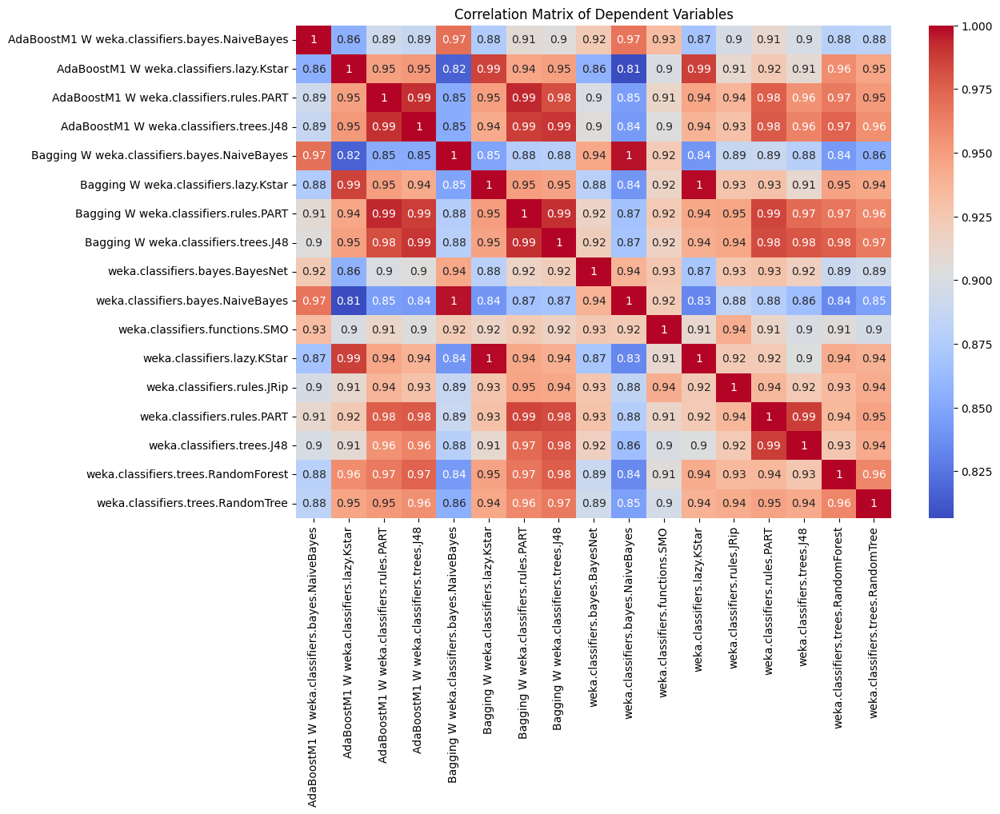

Highly Correlated Pairs (correlation > 0.9): [('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.bayes.NaiveBayes'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.trees.J48'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.bayes.BayesNet'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.bayes.NaiveBayes'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.functions.SMO'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'AdaBoostM1 W weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'AdaBoostM1 W weka.classifiers.trees.J48'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'Bagging W weka.classifiers.lazy.Kstar'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'Bagging W wek

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_selection import f_regression

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)

# Correlation Analysis
correlation_matrix = performance_data.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Dependent Variables')
plt.show()

# Identify highly correlated variables (correlation > 0.9)
high_corr_pairs = [(col1, col2) for col1 in correlation_matrix.columns for col2 in correlation_matrix.columns
                   if col1 != col2 and correlation_matrix.loc[col1, col2] > 0.9]
print("Highly Correlated Pairs (correlation > 0.9):", high_corr_pairs)

# Variance Analysis
variances = performance_data.var()
low_variance_cols = variances[variances < 0.01].index  # Adjust threshold as needed
print("Low Variance Dependent Variables:", low_variance_cols)

# Drop low variance and highly correlated variables (if necessary)
# performance_data = performance_data.drop(columns=low_variance_cols)

# Univariate Feature Selection for each dependent variable
univariate_results = {}

# Assuming X is the normalized meta-features DataFrame aligned with the performance data
for col in performance_data.columns:
    f_scores, p_values = f_regression(X, performance_data[col])
    f_scores_df = pd.DataFrame({'Meta-Feature': combined_meta_features.columns, 'F-Score': f_scores, 'p-Value': p_values})
    f_scores_df = f_scores_df.sort_values(by='F-Score', ascending=False)
    univariate_results[col] = f_scores_df

# Display the top features for each dependent variable
for dependent_var, scores_df in univariate_results.items():
    print(f"Top features for {dependent_var}:")
    print(scores_df.head(10))  # Display top 10 features for each dependent variable
    print()

# Optionally select top N features based on univariate results (if needed)
# top_features = set()
# for scores_df in univariate_results.values():
#     top_features.update(scores_df.head(10)['Meta-Feature'])
# performance_data = performance_data[list(top_features)]

# Re-run the SGLasso model with refined performance data (if features are selected)


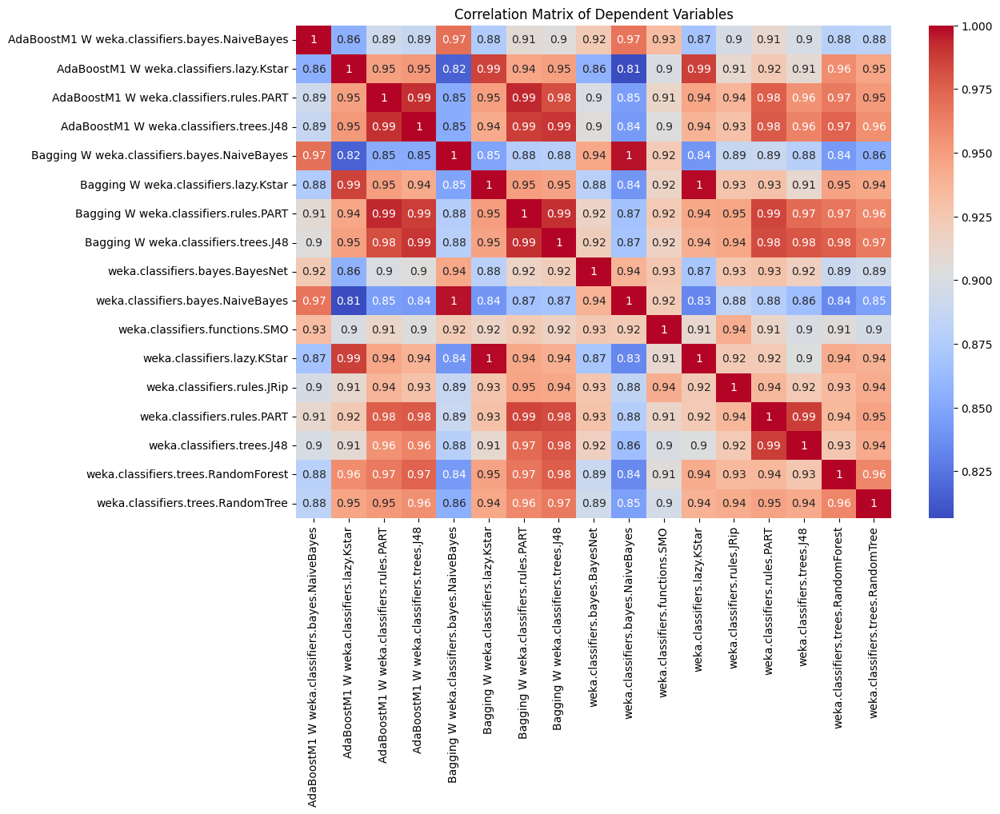

Highly Correlated Pairs (correlation > 0.9): [('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.bayes.NaiveBayes'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'Bagging W weka.classifiers.trees.J48'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.bayes.BayesNet'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.bayes.NaiveBayes'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.functions.SMO'), ('AdaBoostM1 W weka.classifiers.bayes.NaiveBayes', 'weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'AdaBoostM1 W weka.classifiers.rules.PART'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'AdaBoostM1 W weka.classifiers.trees.J48'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'Bagging W weka.classifiers.lazy.Kstar'), ('AdaBoostM1 W weka.classifiers.lazy.Kstar', 'Bagging W wek

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_selection import f_regression

# Load performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)

# Correlation Analysis
correlation_matrix = performance_data.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Dependent Variables')
plt.show()

# Identify highly correlated variables (correlation > 0.9)
high_corr_pairs = [(col1, col2) for col1 in correlation_matrix.columns for col2 in correlation_matrix.columns
                   if col1 != col2 and correlation_matrix.loc[col1, col2] > 0.9]
print("Highly Correlated Pairs (correlation > 0.9):", high_corr_pairs)

# Remove one variable from each pair of highly correlated variables
high_corr_vars = set()
for pair in high_corr_pairs:
    high_corr_vars.add(pair[1])

# Drop highly correlated variables
performance_data_reduced = performance_data.drop(columns=high_corr_vars)

# Save the reduced performance data for subsequent analysis
performance_data_reduced.to_csv('performance_data_reduced.csv')

# Univariate Feature Selection for each dependent variable
univariate_results = {}

# Assuming X is the normalized meta-features DataFrame aligned with the performance data
for col in performance_data_reduced.columns:
    f_scores, p_values = f_regression(X, performance_data_reduced[col])
    f_scores_df = pd.DataFrame({'Meta-Feature': combined_meta_features.columns, 'F-Score': f_scores, 'p-Value': p_values})
    f_scores_df = f_scores_df.sort_values(by='F-Score', ascending=False)
    univariate_results[col] = f_scores_df

# Display the top features for each dependent variable
for dependent_var, scores_df in univariate_results.items():
    print(f"Top features for {dependent_var}:")
    print(scores_df.head(10))  # Display top 10 features for each dependent variable
    print()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LassoCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    for group, indices in groups.items():
        indices = [i for i in indices if i < X.shape[1]]  # Ensure indices are within bounds
        if len(indices) == 0:
            continue
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])
        W[:, indices] = W_group_new

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, V, lambdas, groups)

        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -mean_squared_error(Y, Y_pred)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups, 'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Correct group indices to ensure they are within bounds
n_features = X.shape[1]
group_sizes = [min(20, n_features)] * 5  # Adjust group sizes to fit within n_features

# Define the grid search parameters
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10, 15, 20, 30, 40]
param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l, 'info_theory': l, 'statistical': l} for l in lambda_values],
}

# Perform grid search for p values from 1 to 40
results_list_joint = []
for p in range(1, 41):
    start_index = 0
    group_indices = {}
    for i, group in enumerate(meta_features_files.keys()):
        end_index = start_index + group_sizes[i]
        if end_index > n_features:
            end_index = n_features
        group_indices[group] = list(range(start_index, end_index))
        start_index = end_index

    print(f"Group indices for p={p}: {group_indices}")  # Debugging statement

    estimator = SGLassoEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices)
    grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    print(f"Best parameters for p = {p}:", grid_search.best_params_)
    print(f"Best score for p = {p}:", grid_search.best_score_)

    for i, lmbda in enumerate(grid_search.cv_results_['param_lambdas']):
        coefs = grid_search.best_estimator_.W_
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list_joint.append({'p': p, 'lambda': lmbda['general'], 'num_selected_features': num_selected_features, **group_counts})

# Create a DataFrame to store all results for joint modeling
results_df_joint = pd.DataFrame(results_list_joint)
print(results_df_joint)

# Separate modeling using individual Lasso regression for each dependent variable
results_list_separate = []
for i in range(Y.shape[1]):
    lasso = LassoCV(alphas=lambda_values, cv=5)
    lasso.fit(X, Y[:, i])

    best_lambda = lasso.alpha_
    best_score = -mean_squared_error(Y[:, i], lasso.predict(X))

    coefs = lasso.coef_
    num_selected_features = np.sum(coefs != 0)
    group_counts = {group: 0 for group in meta_features.keys()}
    for group, indices in group_indices.items():
        group_counts[group] = np.sum(coefs[indices] != 0)

    results_list_separate.append({'dependent_variable': i, 'lambda': best_lambda, 'num_selected_features': num_selected_features, **group_counts, 'best_score': best_score})

# Create a DataFrame to store all results for separate modeling
results_df_separate = pd.DataFrame(results_list_separate)
print(results_df_separate)

# Compare joint and separate modeling results
print("Joint Modeling Results:\n", results_df_joint)
print("Separate Modeling Results:\n", results_df_separate)


Group indices for p=1: {'general': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], 'concept': [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], 'complexity': [40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59], 'info_theory': [60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79], 'statistical': [80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]}
Best parameters for p = 1: {'lambdas': {'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}}
Best score for p = 1: -6436.828951475506
Group indices for p=2: {'general': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], 'concept': [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], 'complexity': [40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59], 'info_theory': [60, 61, 62, 63, 64, 65, 6

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LassoCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define soft thresholding and MM algorithm for SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, V, lambdas, groups):
    for group, indices in groups.items():
        indices = [i for i in indices if i < X.shape[1]]  # Ensure indices are within bounds
        if len(indices) == 0:
            continue
        W_group = W[:, indices]
        X_group = X[:, indices]
        V_group = V[:, indices]

        W_group_new = soft_thresholding(W_group + V_group, lambdas[group])
        W[:, indices] = W_group_new

    return W

def sglasso_mm(X, Y, lambdas, groups, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    W = np.zeros((n_tasks, n_features))
    V = np.zeros_like(W)

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, V, lambdas, groups)

        if np.linalg.norm(W - W_old) < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class SGLassoEstimator:
    def __init__(self, lambdas, groups, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = sglasso_mm(X, Y, self.lambdas, self.groups, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -mean_squared_error(Y, Y_pred)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups, 'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Correct group indices to ensure they are within bounds
n_features = X.shape[1]
group_sizes = [min(20, n_features)] * 5  # Adjust group sizes to fit within n_features

# Define the grid search parameters
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10, 15, 20, 30, 40]
param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l, 'info_theory': l, 'statistical': l} for l in lambda_values],
}

# Perform grid search for p values from 1 to 40
results_list_joint = []
for p in range(1, 41):
    start_index = 0
    group_indices = {}
    for i, group in enumerate(meta_features_files.keys()):
        end_index = start_index + group_sizes[i]
        if end_index > n_features:
            end_index = n_features
        group_indices[group] = list(range(start_index, end_index))
        start_index = end_index

    print(f"Group indices for p={p}: {group_indices}")  # Debugging statement

    estimator = SGLassoEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices)
    grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    print(f"Best parameters for p = {p}:", grid_search.best_params_)
    print(f"Best score for p = {p}:", grid_search.best_score_)

    for i, lmbda in enumerate(grid_search.cv_results_['param_lambdas']):
        coefs = grid_search.best_estimator_.W_
        num_selected_features = np.sum(np.any(coefs != 0, axis=0))
        group_counts = {group: 0 for group in meta_features.keys()}
        for group, indices in group_indices.items():
            group_counts[group] = np.sum(np.any(coefs[:, indices] != 0, axis=0))
        results_list_joint.append({'p': p, 'lambda': lmbda['general'], 'num_selected_features': num_selected_features, **group_counts})

# Create a DataFrame to store all results for joint modeling
results_df_joint = pd.DataFrame(results_list_joint)
results_df_joint.to_csv('joint_modeling_results.csv', index=False)
print("Joint Modeling Results saved to 'joint_modeling_results.csv'")

# Separate modeling using individual Lasso regression for each dependent variable
results_list_separate = []
for i in range(Y.shape[1]):
    lasso = LassoCV(alphas=lambda_values, cv=5)
    lasso.fit(X, Y[:, i])

    best_lambda = lasso.alpha_
    best_score = -mean_squared_error(Y[:, i], lasso.predict(X))

    coefs = lasso.coef_
    num_selected_features = np.sum(coefs != 0)
    group_counts = {group: 0 for group in meta_features.keys()}
    for group, indices in group_indices.items():
        group_counts[group] = np.sum(coefs[indices] != 0)

    results_list_separate.append({'dependent_variable': i, 'lambda': best_lambda, 'num_selected_features': num_selected_features, **group_counts, 'best_score': best_score})

# Create a DataFrame to store all results for separate modeling
results_df_separate = pd.DataFrame(results_list_separate)
results_df_separate.to_csv('separate_modeling_results.csv', index=False)
print("Separate Modeling Results saved to 'separate_modeling_results.csv'")

# Compare joint and separate modeling results
print("Joint Modeling Results:\n", results_df_joint)
print("Separate Modeling Results:\n", results_df_separate)


Group indices for p=1: {'general': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], 'concept': [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], 'complexity': [40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59], 'info_theory': [60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79], 'statistical': [80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]}
Best parameters for p = 1: {'lambdas': {'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}}
Best score for p = 1: -6436.828951475506
Group indices for p=2: {'general': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], 'concept': [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], 'complexity': [40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59], 'info_theory': [60, 61, 62, 63, 64, 65, 6

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define soft thresholding function
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

# Update function for hierarchical sparse group elastic net
def update_W(X, Y, W, lambdas, groups, alpha, rho, beta):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Compute gradient
    grad = - (1/n_samples) * X.T.dot(Y - X.dot(W))

    # Update W with gradient step
    W -= grad

    # Apply group lasso penalty
    for group, indices in groups.items():
        W_group = W[indices, :]
        norm = np.sqrt(np.sum(W_group ** 2, axis=1))
        scaling = np.maximum(0, 1 - alpha * lambdas[group] * (1 - rho) / norm[:, np.newaxis])
        W[indices, :] = W_group * scaling

    # Apply within-group sparsity (L1 penalty)
    W = soft_thresholding(W, beta)

    # Apply Frobenius norm penalty
    W *= 1 / (1 + alpha * lambdas['general'] * rho)

    return W

# Hierarchical Sparse Group Elastic Net optimization
def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    W = np.zeros((n_features, n_tasks))

    for iter in range(max_iter):
        W_old = W.copy()

        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta)

        # Apply cardinality constraint (50% of features)
        if np.sum(W != 0) > 0.5 * n_features:
            threshold = np.sort(np.abs(W), axis=None)[int(0.5 * n_features)]
            W[np.abs(W) < threshold] = 0

        # Check convergence
        if np.linalg.norm(W - W_old, ord='fro') < tol:
            break

    return W

# Define a custom estimator for GridSearchCV
class HierarchicalSGEstimator:
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups, 'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta, 'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10]
alpha_values = [0.1, 0.5, 1]
rho_values = [0.1, 0.5, 0.9]
beta_values = [0.1, 0.5, 1]
param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l, 'info_theory': l, 'statistical': l} for l in lambda_values],
    'alpha': alpha_values,
    'rho': rho_values,
    'beta': beta_values
}

# Define the group indices for hierarchical sparse group elastic net
group_indices = {
    'general': list(range(0, 20)),
    'concept': list(range(20, 40)),
    'complexity': list(range(40, 60)),
    'info_theory': list(range(60, 80)),
    'statistical': list(range(80, 100))
}

# Perform grid search
results_list = []
estimator = HierarchicalSGEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices, alpha=0.1, rho=0.1, beta=0.1)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Save results
results_df = pd.DataFrame(grid_search.cv_results_)
results_df.to_csv('hierarchical_sglasso_results.csv')

# Retrieve the best model and save its coefficients
best_model = grid_search.best_estimator_
W = best_model.W_
np.savetxt('hierarchical_sglasso_coefficients.csv', W, delimiter=',')

print(f"Best parameters: {grid_search.best_params_}")
print(f"Best score: {grid_search.best_score_}")


Best parameters: {'alpha': 1, 'beta': 0.1, 'lambdas': {'general': 10, 'concept': 10, 'complexity': 10, 'info_theory': 10, 'statistical': 10}, 'rho': 0.9}
Best score: -2077.96619082955


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:961: RuntimeWarning: overflow encountered in square
  (array - array_means[:, np.newaxis]) ** 2, axis=1, weights=weights


In [ ]:
import pandas as pd

# Load the results file
results_df = pd.read_csv('hierarchical_sglasso_results.csv')
coefficients = pd.read_csv('hierarchical_sglasso_coefficients.csv', header=None)

# Display the first few rows of the results dataframe
results_df.head()

# Summary of the results
summary = results_df.describe()
summary


/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


,Unnamed: 0,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_beta,param_rho,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
count,216.000,216.000000,216.000000,216.000000,216.000000,216.000000,216.000000,216.000000,2.160000e+02,2.160000e+02,2.160000e+02,2.160000e+02,2.160000e+02,2.160000e+02,2.160000e+02,216.000000
mean,107.500,0.044319,0.003021,0.000524,0.000043,0.533333,0.533333,0.500000,-4.983304e+184,-6.725539e+180,-1.366658e+181,-3.020994e+185,-4.007117e+182,-7.047071e+184,inf,108.000000
std,62.498,0.009360,0.002380,0.000068,0.000038,0.369034,0.369034,0.327357,inf,inf,inf,inf,inf,inf,NaN,62.446405
min,0.000,0.024316,0.000293,0.000454,0.000004,0.100000,0.100000,0.100000,-8.970475e+185,-1.212537e+182,-2.462007e+182,-5.439951e+186,-7.214564e+183,-1.268916e+186,3.991504e+02,1.000000
25%,53.750,0.038946,0.001546,0.000475,0.000016,0.100000,0.100000,0.100000,-1.575505e+182,-2.125744e+178,-4.319405e+178,-9.551996e+182,-1.266609e+180,-2.228162e+182,8.713765e+150,54.750000
50%,107.500,0.040428,0.002401,0.000492,0.000027,0.500000,0.500000,0.500000,-3.477909e+173,-4.672949e+169,-9.510271e+169,-2.107708e+174,-2.793388e+171,-4.916867e+173,NaN,108.000000
75%,161.250,0.042967,0.003589,0.000551,0.000058,1.000000,1.000000,0.900000,-3.700265e+150,-4.932454e+146,-1.005722e+147,-2.242228e+151,-2.962304e+148,-5.230732e+150,NaN,162.000000
max,215.000,0.076717,0.016546,0.000796,0.000240,1.000000,1.000000,0.900000,-2.302202e+03,-1.453990e+03,-1.998595e+03,-2.660963e+03,-1.974082e+03,-2.077966e+03,inf,216.000000


In [ ]:
# Check how many non-zero coefficients are present
non_zero_counts = (coefficients != 0).sum().sum()
total_coefficients = coefficients.size

# Calculate the percentage of selected features
percentage_selected = (non_zero_counts / total_coefficients) * 100

non_zero_counts, total_coefficients, percentage_selected


(1832, 1887, 97.08532061473238)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define soft thresholding and MM algorithm for hierarchical SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, lambdas, groups, alpha, rho, beta):
    for group, indices in groups.items():
        W_group = W[:, indices]
        X_group = X[:, indices]

        # Debugging information
        print(f"Updating group '{group}': indices={indices}, W_group.shape={W_group.shape}, X_group.shape={X_group.shape}")

        # Check dimensions
        print(f"Shapes -> X: {X.shape}, Y: {Y.shape}, W: {W.shape}, X_group: {X_group.shape}, W_group: {W_group.shape}")

        # Compute the gradient with corrected matrix multiplication
        # (Y - X @ W) should be transposed before slicing and multiplying
        residual = Y - X @ W
        gradient = -2 * X_group.T @ residual[:, indices] + alpha * np.sign(W_group)

        # Update W_group with soft thresholding
        W_group_new = soft_thresholding(W_group - beta * gradient.T, lambdas[group] * beta)

        # Assign the updated weights back
        W[:, indices] = W_group_new

    return W

def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]

    # Initialize weights
    W = np.zeros((n_tasks, n_features))

    for iter in range(max_iter):
        W_old = W.copy()

        # Update W
        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta)

        # Check for convergence
        if np.linalg.norm(W - W_old) < tol:
            print(f"Converged after {iter+1} iterations")
            break

    return W

# Define a custom estimator for GridSearchCV
class HierarchicalSGEstimator:
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol

    def fit(self, X, Y):
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol)
        return self

    def predict(self, X):
        return np.dot(X, self.W_.T)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta,
                'max_iter': self.max_iter, 'tol': self.tol}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define the grid search parameters
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10]
alpha_values = [0.1, 0.5, 1]
rho_values = [0.1, 0.5, 0.9]
beta_values = [0.1, 0.5, 1]

param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                 'info_theory': l, 'statistical': l} for l in lambda_values],
    'alpha': alpha_values,
    'rho': rho_values,
    'beta': beta_values
}

# Define group indices (adjust as per your actual meta-feature indices)
group_indices = {
    'general': list(range(20)),
    'concept': list(range(20, 40)),
    'complexity': list(range(40, 60)),
    'info_theory': list(range(60, 80)),
    'statistical': list(range(80, 100))
}

# Perform grid search
estimator = HierarchicalSGEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices, alpha=0.1, rho=0.1, beta=0.1)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Save results
results_df = pd.DataFrame(grid_search.cv_results_)
results_df.to_csv('/mnt/data/hierarchical_sglasso_results.csv', index=False)

# Save coefficients
coefficients_df = pd.DataFrame(grid_search.best_estimator_.W_)
coefficients_df.to_csv('/mnt/data/hierarchical_sglasso_coefficients.csv', index=False)

print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)


Shape of X: (82, 111)
Shape of Y: (82, 17)
Updating group 'general': indices=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], W_group.shape=(17, 20), X_group.shape=(65, 20)
Shapes -> X: (65, 111), Y: (65, 17), W: (17, 111), X_group: (65, 20), W_group: (17, 20)
Updating group 'general': indices=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], W_group.shape=(17, 20), X_group.shape=(65, 20)
Shapes -> X: (65, 111), Y: (65, 17), W: (17, 111), X_group: (65, 20), W_group: (17, 20)
Updating group 'general': indices=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], W_group.shape=(17, 20), X_group.shape=(66, 20)
Shapes -> X: (66, 111), Y: (66, 17), W: (17, 111), X_group: (66, 20), W_group: (17, 20)
Updating group 'general': indices=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19], W_group.shape=(17, 20), X_group.shape=(66, 20)
Shapes -> X: (66, 111), Y: (66, 17), W: (17, 111), X_group: (66, 20), W_group: (1

ValueError: 
All the 1080 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1080 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "<ipython-input-8-eaf34dde0fba>", line 117, in fit
    self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol)
  File "<ipython-input-8-eaf34dde0fba>", line 96, in hierarchical_sglasso
    W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta)
  File "<ipython-input-8-eaf34dde0fba>", line 74, in update_W
    residual = Y - X @ W
ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 17 is different from 111)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.base import BaseEstimator, RegressorMixin

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define soft thresholding and MM algorithm for hierarchical SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value=1.0):
    for group, indices in groups.items():
        W_group = W[indices, :]
        X_group = X[:, indices]

        # Compute the residual
        residual = Y - X @ W

        # Ensure residual shape is correct
        assert residual.shape == Y.shape, f"Residual shape mismatch: {residual.shape} vs {Y.shape}"

        # Compute the gradient
        gradient = -2 * (X_group.T @ residual) + alpha * np.sign(W_group)

        # Clip gradients to prevent overflow
        gradient = np.clip(gradient, -clip_value, clip_value)

        # Update W_group with soft thresholding
        W_group_new = soft_thresholding(W_group - beta * gradient, lambdas[group] * beta)

        # Assign the updated weights back
        W[indices, :] = W_group_new

    return W

def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]
    W = np.zeros((n_features, n_tasks))

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value)

        if np.linalg.norm(W - W_old) < tol:
            print(f"Converged after {iter+1} iterations")
            break

    return W

class HierarchicalSGEstimator(BaseEstimator, RegressorMixin):
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol
        self.clip_value = clip_value

    def fit(self, X, Y):
        if X.shape[0] != Y.shape[0]:
            raise ValueError(f"Shape mismatch: X has {X.shape[0]} samples but Y has {Y.shape[0]} samples.")
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol, self.clip_value)
        return self

    def predict(self, X):
        return np.dot(X, self.W_)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta,
                'max_iter': self.max_iter, 'tol': self.tol, 'clip_value': self.clip_value}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define parameters for grid search
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10]
alpha_values = [0.1, 0.5, 1]
rho_values = [0.1, 0.5, 0.9]
beta_values = [0.1, 0.5, 1]

param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                 'info_theory': l, 'statistical': l} for l in lambda_values],
    'alpha': alpha_values,
    'rho': rho_values,
    'beta': beta_values
}

group_indices = {
    'general': list(range(20)),
    'concept': list(range(20, 40)),
    'complexity': list(range(40, 60)),
    'info_theory': list(range(60, 80)),
    'statistical': list(range(80, X.shape[1]))
}

estimator = HierarchicalSGEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices, alpha=0.1, rho=0.1, beta=0.1)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(X, Y)

# Evaluate grid search results
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Save results
results_df = pd.DataFrame(grid_search.cv_results_)
results_df.to_csv('hierarchical_sglasso_results.csv', index=False)

# Save coefficients
coefficients_df = pd.DataFrame(grid_search.best_estimator_.W_)
coefficients_df.to_csv('hierarchical_sglasso_coefficients.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)


Shape of X: (82, 111)
Shape of Y: (82, 17)
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.base import BaseEstimator, RegressorMixin

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define soft thresholding and MM algorithm for hierarchical SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value=1.0):
    for group, indices in groups.items():
        W_group = W[indices, :]
        X_group = X[:, indices]

        # Compute the residual
        residual = Y - X @ W

        # Ensure residual shape is correct
        assert residual.shape == Y.shape, f"Residual shape mismatch: {residual.shape} vs {Y.shape}"

        # Compute the gradient
        gradient = -2 * (X_group.T @ residual) + alpha * np.sign(W_group)

        # Clip gradients to prevent overflow
        gradient = np.clip(gradient, -clip_value, clip_value)

        # Update W_group with soft thresholding
        W_group_new = soft_thresholding(W_group - beta * gradient, lambdas[group] * beta)

        # Assign the updated weights back
        W[indices, :] = W_group_new

    return W

def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]
    W = np.zeros((n_features, n_tasks))

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value)

        if np.linalg.norm(W - W_old) < tol:
            print(f"Converged after {iter+1} iterations")
            break

    return W

class HierarchicalSGEstimator(BaseEstimator, RegressorMixin):
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol
        self.clip_value = clip_value

    def fit(self, X, Y):
        if X.shape[0] != Y.shape[0]:
            raise ValueError(f"Shape mismatch: X has {X.shape[0]} samples but Y has {Y.shape[0]} samples.")
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol, self.clip_value)

        # Calculate and store the number of selected features per group
        self.selected_features_ = {group: np.sum(np.any(self.W_[indices, :] != 0, axis=1)) for group, indices in self.groups.items()}

        return self

    def predict(self, X):
        return np.dot(X, self.W_)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta,
                'max_iter': self.max_iter, 'tol': self.tol, 'clip_value': self.clip_value}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define parameters for grid search
lambda_values = [0.1, 0.2, 0.5, 1, 2, 3, 5, 10]
alpha_values = [0.1, 0.5, 1]
rho_values = [0.1, 0.5, 0.9]
beta_values = [0.1, 0.5, 1]

param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                 'info_theory': l, 'statistical': l} for l in lambda_values],
    'alpha': alpha_values,
    'rho': rho_values,
    'beta': beta_values
}

group_indices = {
    'general': list(range(20)),
    'concept': list(range(20, 40)),
    'complexity': list(range(40, 60)),
    'info_theory': list(range(60, 80)),
    'statistical': list(range(80, X.shape[1]))
}

estimator = HierarchicalSGEstimator(lambdas={'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1}, groups=group_indices, alpha=0.1, rho=0.1, beta=0.1)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(X, Y)

# Evaluate grid search results
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Save results
results_df = pd.DataFrame(grid_search.cv_results_)
results_df.to_csv('hierarchical_sglasso_results.csv', index=False)

# Save coefficients
coefficients_df = pd.DataFrame(grid_search.best_estimator_.W_)
coefficients_df.to_csv('hierarchical_sglasso_coefficients.csv', index=False)

# Save selected features per group
selected_features_df = pd.DataFrame([grid_search.best_estimator_.selected_features_])
selected_features_df.to_csv('hierarchical_sglasso_selected_features.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)
print("Selected features per group:", grid_search.best_estimator_.selected_features_)


Shape of X: (82, 111)
Shape of Y: (82, 17)
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations
Converged after 1 iterations


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.base import BaseEstimator, RegressorMixin

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define soft thresholding and MM algorithm for hierarchical SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value=1.0):
    for group, indices in groups.items():
        W_group = W[indices, :]
        X_group = X[:, indices]

        # Compute the residual
        residual = Y - X @ W

        # Ensure residual shape is correct
        assert residual.shape == Y.shape, f"Residual shape mismatch: {residual.shape} vs {Y.shape}"

        # Compute the gradient
        gradient = -2 * (X_group.T @ residual) + alpha * np.sign(W_group)

        # Clip gradients to prevent overflow
        gradient = np.clip(gradient, -clip_value, clip_value)

        # Update W_group with soft thresholding
        W_group_new = soft_thresholding(W_group - beta * gradient, lambdas[group] * beta)

        # Assign the updated weights back
        W[indices, :] = W_group_new

    return W

def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]
    W = np.random.randn(n_features, n_tasks) * 0.01  # Start with small random values

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value)

        if np.linalg.norm(W - W_old) < tol:
            print(f"Converged after {iter+1} iterations")
            break

    return W

class HierarchicalSGEstimator(BaseEstimator, RegressorMixin):
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol
        self.clip_value = clip_value

    def fit(self, X, Y):
        if X.shape[0] != Y.shape[0]:
            raise ValueError(f"Shape mismatch: X has {X.shape[0]} samples but Y has {Y.shape[0]} samples.")
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol, self.clip_value)
        return self

    def predict(self, X):
        return np.dot(X, self.W_)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta,
                'max_iter': self.max_iter, 'tol': self.tol, 'clip_value': self.clip_value}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Define parameters for grid search
lambda_values = [1, 5, 10, 20, 50, 100]
alpha_values = [1, 5, 10, 20]
rho_values = [0.1, 0.5, 0.9, 1]
beta_values = [0.1, 0.5, 1, 2]

param_grid = {
    'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                 'info_theory': l, 'statistical': l} for l in lambda_values],
    'alpha': alpha_values,
    'rho': rho_values,
    'beta': beta_values
}

group_indices = {
    'general': list(range(20)),
    'concept': list(range(20, 40)),
    'complexity': list(range(40, 60)),
    'info_theory': list(range(60, 80)),
    'statistical': list(range(80, X.shape[1]))
}

estimator = HierarchicalSGEstimator(lambdas={'general': 1, 'concept': 1, 'complexity': 1, 'info_theory': 1, 'statistical': 1}, groups=group_indices, alpha=1, rho=0.1, beta=0.1)
grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(X, Y)

# Evaluate grid search results
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Save results
results_df = pd.DataFrame(grid_search.cv_results_)
results_df.to_csv('hierarchical_sglasso_results.csv', index=False)

# Save coefficients
coefficients_df = pd.DataFrame(grid_search.best_estimator_.W_)
coefficients_df.to_csv('hierarchical_sglasso_coefficients.csv', index=False)

# Calculate and print selected features per group
selected_features_per_group = {group: np.sum(np.any(grid_search.best_estimator_.W_[indices, :] != 0, axis=1)) for group, indices in group_indices.items()}
print("Selected features per group:", selected_features_per_group)

print("Best parameters:", best_params)
print("Best score:", best_score)


Shape of X: (82, 111)
Shape of Y: (82, 17)
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 3 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations
Converged after 2 iterations


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.base import BaseEstimator, RegressorMixin

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define soft thresholding and MM algorithm for hierarchical SGLasso
def soft_thresholding(x, lambda_):
    return np.sign(x) * np.maximum(np.abs(x) - lambda_, 0)

def update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value=1.0):
    for group, indices in groups.items():
        W_group = W[indices, :]
        X_group = X[:, indices]

        # Compute the residual
        residual = Y - X @ W

        # Ensure residual shape is correct
        assert residual.shape == Y.shape, f"Residual shape mismatch: {residual.shape} vs {Y.shape}"

        # Compute the gradient
        gradient = -2 * (X_group.T @ residual) + alpha * np.sign(W_group)

        # Clip gradients to prevent overflow
        gradient = np.clip(gradient, -clip_value, clip_value)

        # Update W_group with soft thresholding
        W_group_new = soft_thresholding(W_group - beta * gradient, lambdas[group] * beta)

        # Assign the updated weights back
        W[indices, :] = W_group_new

    return W

def hierarchical_sglasso(X, Y, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
    n_samples, n_features = X.shape
    n_tasks = Y.shape[1]
    W = np.zeros((n_features, n_tasks))

    for iter in range(max_iter):
        W_old = W.copy()
        W = update_W(X, Y, W, lambdas, groups, alpha, rho, beta, clip_value)

        if np.linalg.norm(W - W_old) < tol:
            print(f"Converged after {iter+1} iterations")
            break

    return W

class HierarchicalSGEstimator(BaseEstimator, RegressorMixin):
    def __init__(self, lambdas, groups, alpha, rho, beta, max_iter=100, tol=1e-4, clip_value=1.0):
        self.lambdas = lambdas
        self.groups = groups
        self.alpha = alpha
        self.rho = rho
        self.beta = beta
        self.max_iter = max_iter
        self.tol = tol
        self.clip_value = clip_value

    def fit(self, X, Y):
        if X.shape[0] != Y.shape[0]:
            raise ValueError(f"Shape mismatch: X has {X.shape[0]} samples but Y has {Y.shape[0]} samples.")
        self.W_ = hierarchical_sglasso(X, Y, self.lambdas, self.groups, self.alpha, self.rho, self.beta, self.max_iter, self.tol, self.clip_value)
        return self

    def predict(self, X):
        return np.dot(X, self.W_)

    def score(self, X, Y):
        Y_pred = self.predict(X)
        return -np.mean((Y - Y_pred) ** 2)

    def get_params(self, deep=True):
        return {'lambdas': self.lambdas, 'groups': self.groups,
                'alpha': self.alpha, 'rho': self.rho, 'beta': self.beta,
                'max_iter': self.max_iter, 'tol': self.tol, 'clip_value': self.clip_value}

    def set_params(self, **params):
        for key, value in params.items():
            setattr(self, key, value)
        return self

# Dynamic grid search for hyperparameters
def dynamic_grid_search(X, Y, initial_params, reduction_target=0.5, max_iterations=20):
    best_params = initial_params
    best_score = -np.inf
    best_selected_features = []

    for iteration in range(max_iterations):
        # Define parameters for grid search
        lambda_values = [best_params['lambdas']['general'] * 1.5, best_params['lambdas']['general'] * 0.5]
        alpha_values = [best_params['alpha'] * 1.5, best_params['alpha'] * 0.5]
        rho_values = [best_params['rho'] * 1.5, best_params['rho'] * 0.5]
        beta_values = [best_params['beta'] * 1.5, best_params['beta'] * 0.5]

        param_grid = {
            'lambdas': [{'general': l, 'concept': l, 'complexity': l,
                         'info_theory': l, 'statistical': l} for l in lambda_values],
            'alpha': alpha_values,
            'rho': rho_values,
            'beta': beta_values
        }

        estimator = HierarchicalSGEstimator(
            lambdas=best_params['lambdas'], groups=group_indices,
            alpha=best_params['alpha'], rho=best_params['rho'], beta=best_params['beta']
        )
        grid_search = GridSearchCV(estimator, param_grid, cv=5, scoring='neg_mean_squared_error')
        grid_search.fit(X, Y)

        current_best_params = grid_search.best_params_
        current_best_score = grid_search.best_score_
        coefficients = grid_search.best_estimator_.W_

        # Post-processing: Feature Selection
        selected_features = np.where(np.abs(coefficients).sum(axis=1) > 1e-4)[0]
        reduction_ratio = len(selected_features) / X.shape[1]

        if reduction_ratio <= reduction_target and len(selected_features) > 0:
            best_params = current_best_params
            best_score = current_best_score
            best_selected_features = selected_features
            break
        else:
            best_params = current_best_params

    return best_params, best_score, best_selected_features

# Initial parameters
initial_params = {
    'lambdas': {'general': 0.1, 'concept': 0.1, 'complexity': 0.1, 'info_theory': 0.1, 'statistical': 0.1},
    'alpha': 0.1,
    'rho': 0.1,
    'beta': 0.1
}

# Perform dynamic grid search
best_params, best_score, selected_features = dynamic_grid_search(X, Y, initial_params)

# Save results
reduced_X = X[:, selected_features]
selected_features_df = pd.DataFrame(reduced_X, columns=[combined_meta_features.columns[i] for i in selected_features])
selected_features_df.to_csv('selected_features.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)
print(f"Number of selected features: {len(selected_features)}")


Shape of X: (82, 111)
Shape of Y: (82, 17)
Best parameters: {'alpha': 4.105255222320557, 'beta': 0.1520464897155762, 'lambdas': {'general': 0.001877117156982422, 'concept': 0.001877117156982422, 'complexity': 0.001877117156982422, 'info_theory': 0.001877117156982422, 'statistical': 0.001877117156982422}, 'rho': 332.5256730079651}
Best score: -inf
Number of selected features: 0


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define ElasticNet model
elastic_net = ElasticNet()

# Define parameters for grid search
param_grid = {
    'alpha': np.logspace(-4, 1, 10),
    'l1_ratio': np.linspace(0.1, 1.0, 10)
}

# Perform grid search
grid_search = GridSearchCV(elastic_net, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Get the best parameters and score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Get the coefficients
coefficients = grid_search.best_estimator_.coef_

# Post-processing: Feature Selection
selected_features = np.where(np.abs(coefficients).sum(axis=0) > 1e-4)[0]
reduced_X = X[:, selected_features]

# Save selected features
selected_features_df = pd.DataFrame(reduced_X, columns=[combined_meta_features.columns[i] for i in selected_features])
selected_features_df.to_csv('selected_features.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)
print(f"Number of selected features: {len(selected_features)}")


Shape of X: (82, 111)
Shape of Y: (82, 17)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.182e+02, tolerance: 1.890e+00
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.593e+02, tolerance: 2.386e+00
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.134e+02, tolerance: 2.036e

Best parameters: {'alpha': 0.21544346900318845, 'l1_ratio': 1.0}
Best score: -90.29801658885694
Number of selected features: 40


In [ ]:
import pandas as pd
import numpy as np

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Verify data types and values
print(combined_meta_features.dtypes)
print(np.any(np.isnan(combined_meta_features)), np.any(np.isinf(combined_meta_features)))
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Normalize the combined meta-features
scaler = MinMaxScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Verify normalization
print("Normalization min:", np.min(normalized_meta_features))
print("Normalization max:", np.max(normalized_meta_features))

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define ElasticNet model
elastic_net = ElasticNet()

# Define parameters for grid search
param_grid = {
    'alpha': np.logspace(-4, 1, 10),
    'l1_ratio': np.linspace(0.1, 1.0, 10)
}

# Perform grid search
grid_search = GridSearchCV(elastic_net, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Get the best parameters and score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Get the coefficients
coefficients = grid_search.best_estimator_.coef_

# Post-processing: Feature Selection
selected_features = np.where(np.abs(coefficients).sum(axis=0) > 1e-4)[0]
reduced_X = X[:, selected_features]

# Save selected features
selected_features_df = pd.DataFrame(reduced_X, columns=[combined_meta_features.columns[i] for i in selected_features])
selected_features_df.to_csv('selected_features.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)
print(f"Number of selected features: {len(selected_features)}")


attr_to_inst       float64
cat_to_num         float64
freq_class.mean    float64
freq_class.sd      float64
inst_to_attr       float64
                    ...   
t_mean.mean        float64
t_mean.sd          float64
var.mean           float64
var.sd             float64
w_lambda           float64
Length: 111, dtype: object
False False
Normalization min: 0.0
Normalization max: 1.0000000000000002
Shape of X: (82, 111)
Shape of Y: (82, 17)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.182e+02, tolerance: 1.890e+00
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.593e+02, tolerance: 2.386e+00
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.134e+02, tolerance: 2.036e

Best parameters: {'alpha': 0.21544346900318845, 'l1_ratio': 1.0}
Best score: -90.29801658885694
Number of selected features: 40


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet

# Load meta-feature files and performance data
meta_features_files = {
    'general': 'meta_features_general.csv',
    'concept': 'meta_features_concept.csv',
    'complexity': 'meta_features_complexity.csv',
    'info_theory': 'meta_features_info-theory.csv',
    'statistical': 'meta_features_statistical.csv'
}

# Load meta-features
meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_csv(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['general'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Verify normalization
print("Normalization mean:", np.mean(normalized_meta_features))
print("Normalization std:", np.std(normalized_meta_features))

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Verify shapes
print(f"Shape of X: {X.shape}")
print(f"Shape of Y: {Y.shape}")

# Define ElasticNet model with increased iterations and regularization
elastic_net = ElasticNet(max_iter=15000)

# Define parameters for grid search with increased alpha
param_grid = {
    'alpha': np.logspace(0, 0.5, 1),  # Increased alpha range
    'l1_ratio': np.linspace(0.1, 1.0, 10)
}

# Perform grid search
grid_search = GridSearchCV(elastic_net, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X, Y)

# Get the best parameters and score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Get the coefficients
coefficients = grid_search.best_estimator_.coef_

# Post-processing: Feature Selection
selected_features = np.where(np.abs(coefficients).sum(axis=0) > 1e-4)[0]
reduced_X = X[:, selected_features]

# Save selected features
selected_features_df = pd.DataFrame(reduced_X, columns=[combined_meta_features.columns[i] for i in selected_features])
selected_features_df.to_csv('selected_features.csv', index=False)

print("Best parameters:", best_params)
print("Best score:", best_score)
print(f"Number of selected features: {len(selected_features)}")


Normalization mean: 1.7271762281577914e-17
Normalization std: 1.0
Shape of X: (82, 111)
Shape of Y: (82, 17)
Best parameters: {'alpha': 1.0, 'l1_ratio': 1.0}
Best score: -93.5418354640366
Number of selected features: 46


/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


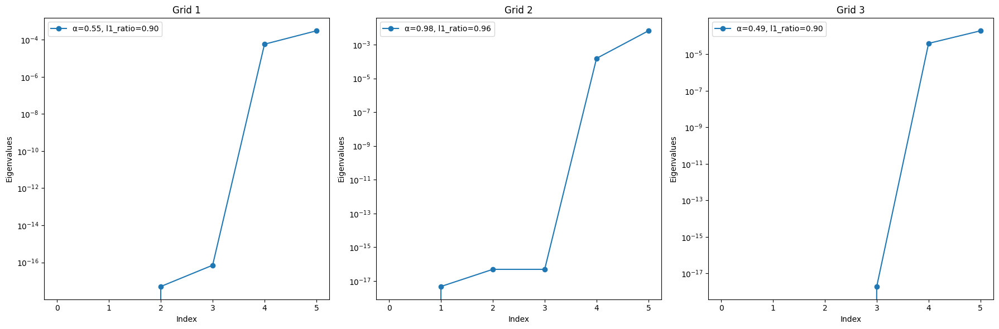

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from numpy.linalg import eigvals

# Define parameter grids
param_grids = [
    {
        'alpha': np.logspace(-1, 1, 20),  # Fine-grained alpha range
        'l1_ratio': np.linspace(0.1, 1.0, 10)  # Wide range of l1_ratio values
    },
    {
        'alpha': np.logspace(-0.01, 2, 50),  # Fine-grained alpha range
        'l1_ratio': np.linspace(0.01, 1.0, 100)  # Wide range of l1_ratio values
    },
    {
        'alpha': np.logspace(-1, 1, 30),  # Fine-grained alpha range
        'l1_ratio': np.linspace(0.1, 1.0, 10)  # Wide range of l1_ratio values
    }
]

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Function to calculate and plot eigenvalues
def plot_eigenvalues(selected_features, alpha_value, l1_ratio_value, subplot_position):
    selected_X = X[:, selected_features]

    # Calculate correlation matrix
    correlation_matrix = np.corrcoef(selected_X, rowvar=False)

    # Compute eigenvalues
    eigenvalues = eigvals(correlation_matrix)

    # Sort eigenvalues
    sorted_eigenvalues = np.sort(eigenvalues)

    # Plot the six smallest eigenvalues
    plt.subplot(1, 3, subplot_position)
    plt.plot(sorted_eigenvalues[:6], marker='o', label=f'α={alpha_value:.2f}, l1_ratio={l1_ratio_value:.2f}')
    plt.yscale('log')
    plt.xlabel('Index')
    plt.ylabel('Eigenvalues')
    plt.title(f'Grid {subplot_position}')
    plt.legend()

# Perform analysis for each grid and plot eigenvalues
plt.figure(figsize=(18, 6))

for i, param_grid in enumerate(param_grids):
    grid_search = GridSearchCV(ElasticNet(max_iter=25000), param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X, Y)

    best_params = grid_search.best_params_
    best_alpha = best_params['alpha']
    best_l1_ratio = best_params['l1_ratio']

    coefficients = grid_search.best_estimator_.coef_
    feature_importance = np.abs(coefficients).sum(axis=0)
    selected_features = np.where(feature_importance > 1e-4)[0]

    plot_eigenvalues(selected_features, best_alpha, best_l1_ratio, i + 1)

plt.tight_layout()
plt.show()


Mean Squared Error: 79.71796228708573
R-squared: 0.750922209060631
                             Feature  Importance
5                    neighborhood.N1    7.006412
7                    neighborhood.N3    5.639513
43                        struct_X18    1.428936
50     inftheo.equivalent_attributes    1.336571
55     modelbased.nodes_per_instance    1.300868
..                               ...         ...
45  inftheo.normalized_class_entropy    0.000000
46         inftheo.attribute_entropy    0.000000
48             inftheo.joint_entropy    0.000000
49        inftheo.mutual_information    0.000000
88                      network.Hubs    0.000000

[89 rows x 2 columns]


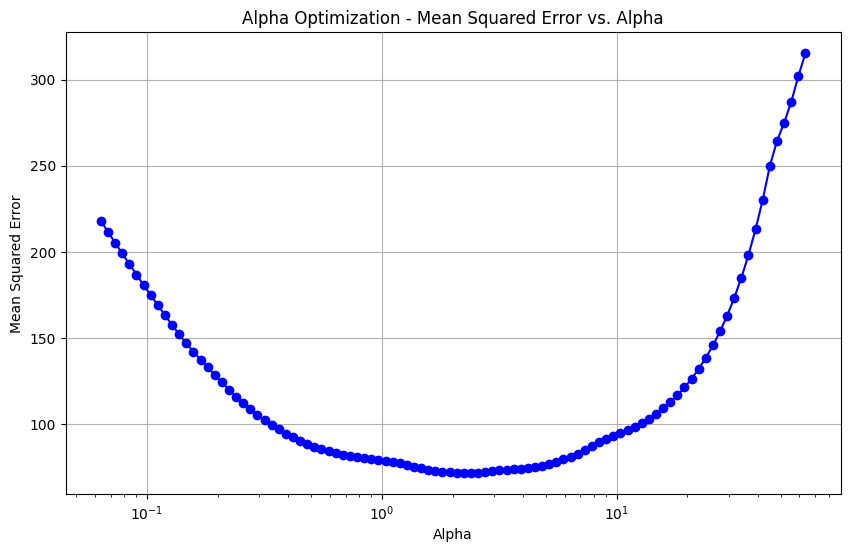

Mean Squared Error (Kernel): 399.61072431242235
R-squared (Kernel): -0.24201629933119792
       Feature  Importance
0    Feature 0         0.0
63  Feature 63         0.0
73  Feature 73         0.0
72  Feature 72         0.0
71  Feature 71         0.0
..         ...         ...
30  Feature 30         0.0
29  Feature 29         0.0
28  Feature 28         0.0
27  Feature 27         0.0
99  Feature 99         0.0

[100 rows x 2 columns]


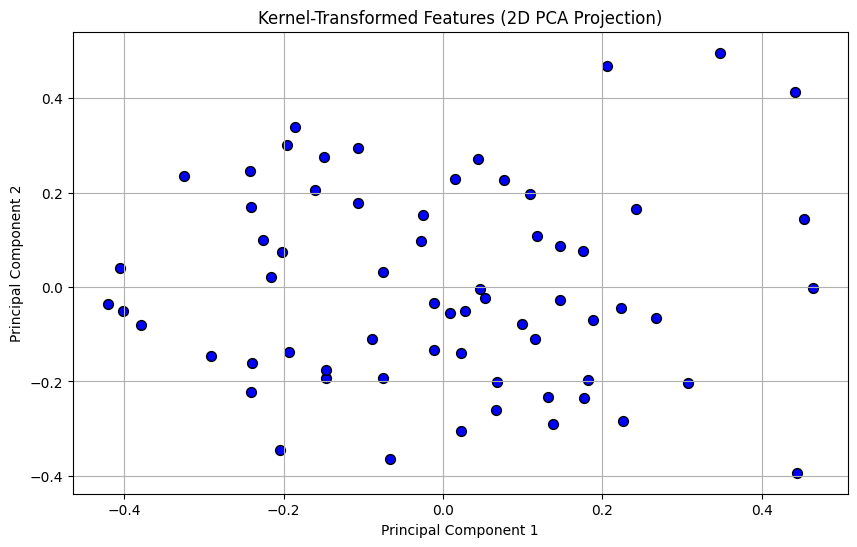

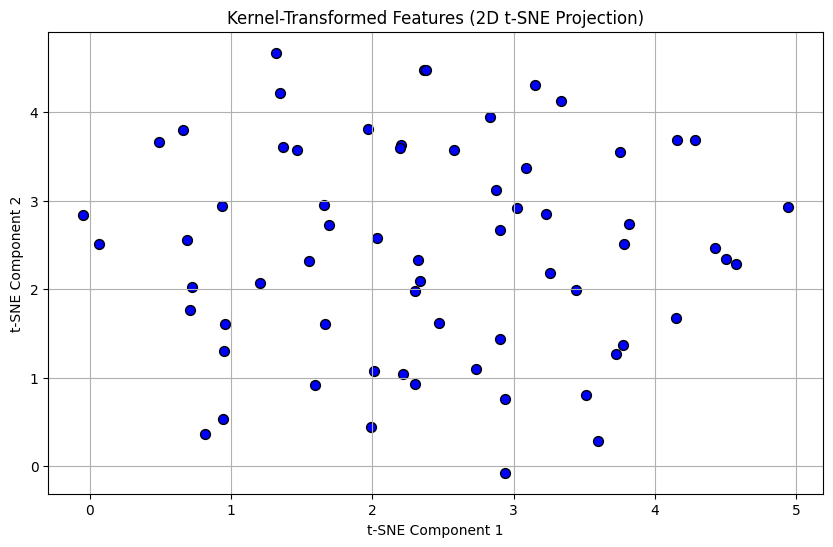

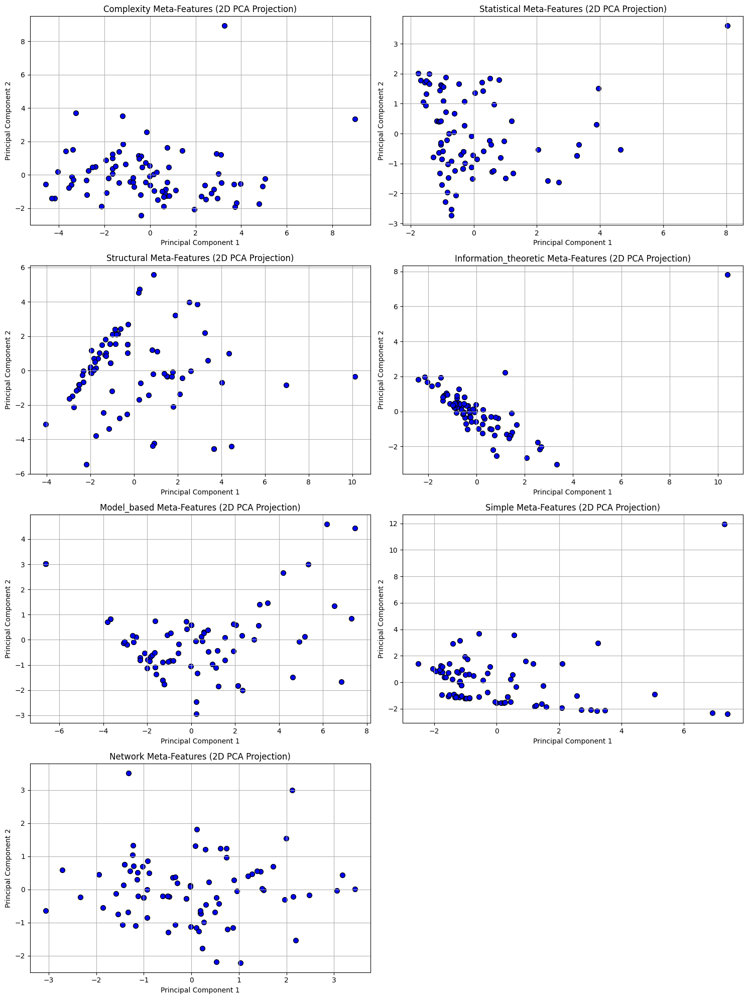

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.47264319831447, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.177442030078964, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:609: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.2675738153921, tolerance: 34.904519500140054
  model = cd_fast.enet_coordinate_descent_multi_task(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.p

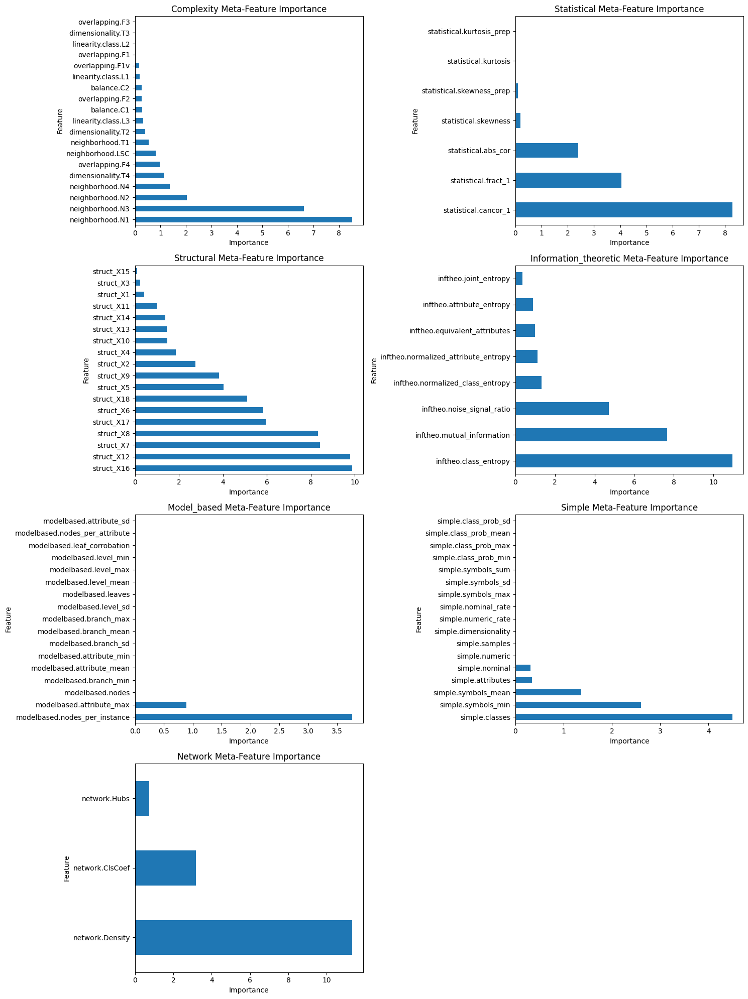

ModuleNotFoundError: No module named 'group_lasso'

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import MultiTaskLassoCV, LassoCV
from sklearn.kernel_ridge import KernelRidge
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import KernelCenterer
from sklearn.kernel_approximation import RBFSampler

# Load meta-features and performance data
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features_dfs = {name: pd.read_excel(file) for name, file in meta_features_files.items()}
performance_data_df = pd.read_excel('PerformanceData.xlsx')

# Merge all meta-features with performance data
merged_df = performance_data_df.copy()
for name, df in meta_features_dfs.items():
    merged_df = pd.merge(merged_df, df, on="Datasets", how="left")

# Separate independent and dependent variables
X_extended = merged_df.drop(columns=["Datasets"] + list(performance_data_df.columns[1:]))
Y = merged_df[performance_data_df.columns[1:]]

# Handle missing values
X_extended.fillna(X_extended.mean(), inplace=True)

# Standardize the independent variables
scaler = StandardScaler()
X_extended_scaled = scaler.fit_transform(X_extended)

# Split data into training and testing sets
X_train_ext, X_test_ext, Y_train, Y_test = train_test_split(X_extended_scaled, Y, test_size=0.2, random_state=42)

# Train MultiTaskLassoCV on the extended dataset
multi_task_lasso_ext = MultiTaskLassoCV(cv=5, random_state=42)
multi_task_lasso_ext.fit(X_train_ext, Y_train)

# Predict on the test set
Y_pred_ext = multi_task_lasso_ext.predict(X_test_ext)

# Evaluate the model
mse_ext = mean_squared_error(Y_test, Y_pred_ext)
r2_ext = r2_score(Y_test, Y_pred_ext)

# Display evaluation results
print(f'Mean Squared Error: {mse_ext}')
print(f'R-squared: {r2_ext}')

# Feature importance
coefficients_ext = multi_task_lasso_ext.coef_
avg_coefficients_ext = np.mean(np.abs(coefficients_ext), axis=0)

# Create a DataFrame for feature importance
feature_importance_df_ext = pd.DataFrame({
    'Feature': X_extended.columns,
    'Importance': avg_coefficients_ext
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(feature_importance_df_ext)

# Plot cross-validation results
alphas = multi_task_lasso_ext.alphas_
mean_scores = multi_task_lasso_ext.mse_path_.mean(axis=-1)

plt.figure(figsize=(10, 6))
plt.plot(alphas, mean_scores, marker='o', linestyle='-', color='b')
plt.xlabel('Alpha')
plt.ylabel('Mean Squared Error')
plt.title('Alpha Optimization - Mean Squared Error vs. Alpha')
plt.xscale('log')
plt.grid(True)
plt.show()

# Apply RBF kernel approximation
rbf_sampler = RBFSampler(gamma=0.1, random_state=42)
X_train_k = rbf_sampler.fit_transform(X_train_ext)
X_test_k = rbf_sampler.transform(X_test_ext)

# Apply MultiTaskLassoCV on Kernel Features
lasso_k = MultiTaskLassoCV(cv=5, random_state=42) # Use MultiTaskLassoCV for multi-task output
lasso_k.fit(X_train_k, Y_train)

# Predict on the test set
Y_pred_k = lasso_k.predict(X_test_k)

# Evaluate the model
mse_k = mean_squared_error(Y_test, Y_pred_k)
r2_k = r2_score(Y_test, Y_pred_k)

# Display evaluation results
print(f'Mean Squared Error (Kernel): {mse_k}')
print(f'R-squared (Kernel): {r2_k}')

# Feature importance for Kernel Lasso
lasso_coefficients_k = lasso_k.coef_
feature_importance_k = np.mean(np.abs(lasso_coefficients_k), axis=0)

# Create a DataFrame for feature importance
# Use the length of feature_importance_k to create a generic list of feature names
kernel_feature_importance_df_k = pd.DataFrame({
    'Feature': [f"Feature {i}" for i in range(len(feature_importance_k))],  # Generic feature names
    'Importance': feature_importance_k
}).sort_values(by='Importance', ascending=False)

# Display feature importance
print(kernel_feature_importance_df_k)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)
X_train_k_pca = pca.fit_transform(X_train_k)

plt.figure(figsize=(10, 6))
plt.scatter(X_train_k_pca[:, 0], X_train_k_pca[:, 1], c='blue', edgecolor='k', s=50)
plt.title('Kernel-Transformed Features (2D PCA Projection)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True)
plt.show()

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_train_k_tsne = tsne.fit_transform(X_train_k)

plt.figure(figsize=(10, 6))
plt.scatter(X_train_k_tsne[:, 0], X_train_k_tsne[:, 1], c='blue', edgecolor='k', s=50)
plt.title('Kernel-Transformed Features (2D t-SNE Projection)')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.grid(True)
plt.show()

# PCA for each meta-feature group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, df) in enumerate(meta_features_dfs.items()):
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Apply PCA
    pca = PCA(n_components=2)
    X_group_pca = pca.fit_transform(X_group_scaled)

    # Plotting
    ax = axes[i]
    ax.scatter(X_group_pca[:, 0], X_group_pca[:, 1], c='blue', edgecolor='k', s=50)
    ax.set_title(f'{name.capitalize()} Meta-Features (2D PCA Projection)')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.grid(True)

# Remove the last empty subplot if the number of groups is odd
if len(meta_features_dfs) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Compute feature importance for each group
feature_importance_dict = {}

for name, df in meta_features_dfs.items():
    X_group = df.drop(columns=["Datasets"])
    X_group_scaled = StandardScaler().fit_transform(X_group)

    # Train MultiTaskLassoCV on the group
    lasso = MultiTaskLassoCV(cv=5, random_state=42)
    lasso.fit(X_group_scaled, Y)

    # Compute feature importance
    feature_importance = np.mean(np.abs(lasso.coef_), axis=0)

    # Store in the dictionary
    feature_importance_dict[name] = pd.DataFrame({
        'Feature': X_group.columns,
        'Importance': feature_importance
    }).sort_values(by='Importance', ascending=False)

# Visualize feature importance for each group
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))
axes = axes.flatten()

for i, (name, importance_df) in enumerate(feature_importance_dict.items()):
    ax = axes[i]
    importance_df.plot(kind='barh', x='Feature', y='Importance', ax=ax, legend=False)
    ax.set_title(f'{name.capitalize()} Meta-Feature Importance')
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')

# Remove the last empty subplot if the number of groups is odd
if len(feature_importance_dict) % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from group_lasso import GroupLasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.kernel_approximation import RBFSampler

# Load and preprocess data (as previously shown)

# Train Sparse Group Lasso model and other models (as previously shown)

# Feature Importance and Visualizations
def visualize_feature_importance(feature_importance_df, title):
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

# Visualize feature importance for Sparse Group Lasso
visualize_feature_importance(feature_importance_df_sgl, 'Feature Importance (Sparse Group Lasso)')

# Visualize feature importance for Kernel Lasso
visualize_feature_importance(kernel_feature_importance_df_k, 'Feature Importance (Kernel Lasso)')

# PCA and t-SNE visualizations
def plot_pca_tsne(X, title):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (PCA Projection)')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()

    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X)
    plt.figure(figsize=(10, 6))
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c='blue', edgecolor='k', s=50)
    plt.title(f'{title} (t-SNE Projection)')
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

# Apply PCA and t-SNE visualizations
plot_pca_tsne(X_train_k, 'Kernel-Transformed Features')


In [ ]:
pip install jax jaxlib numpyro seaborn


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.7/345.7 kB 4.1 MB/s eta 0:00:00


# **Bayesian Elastic Net** **Run**

sample: 100%|██████████| 3000/3000 [02:01<00:00, 24.66it/s, 255 steps of size 1.45e-02. acc. prob=0.93]


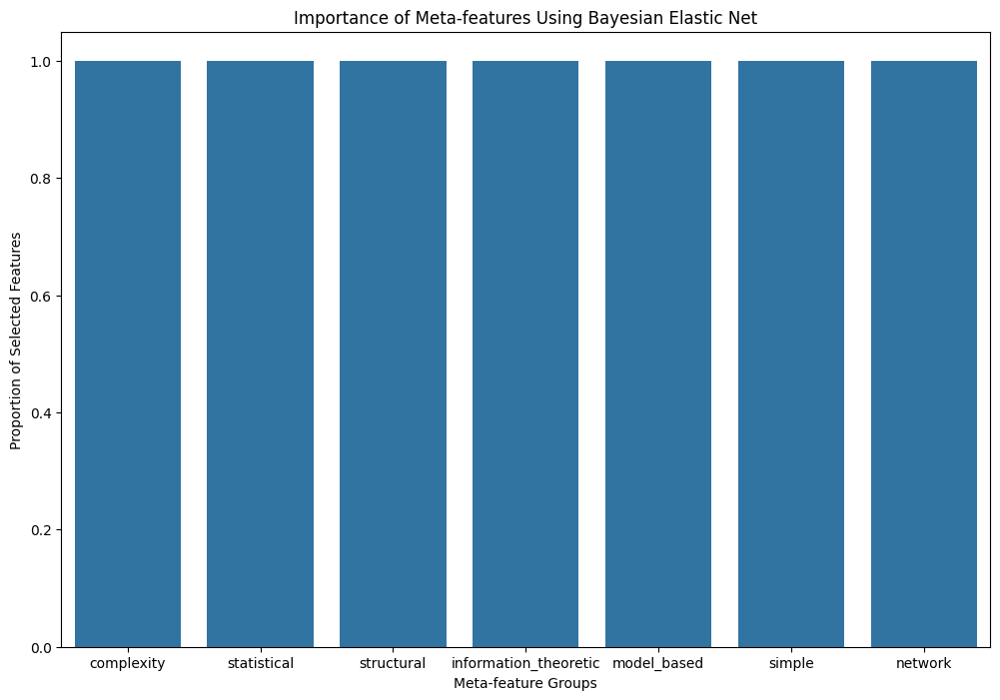

In [ ]:
import numpy as np
import pandas as pd
import jax.numpy as jnp
import numpyro
import numpyro.distributions as dist
from numpyro.infer import MCMC, NUTS
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import jax

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the Bayesian Elastic Net model
def model(X, Y=None):
    n, p = X.shape
    lambda_1 = numpyro.sample("lambda_1", dist.HalfCauchy(2.5))
    lambda_2 = numpyro.sample("lambda_2", dist.HalfCauchy(2.5))

    beta = numpyro.sample("beta", dist.Normal(0, lambda_1 / (jnp.abs(lambda_2) + 1e-5)).expand([p, Y.shape[1]]).to_event(2))
    intercept = numpyro.sample("intercept", dist.Normal(0, 10).expand([Y.shape[1]]).to_event(1))

    mu = jnp.dot(X, beta) + intercept

    sigma = numpyro.sample("sigma", dist.HalfCauchy(1).expand([Y.shape[1]]).to_event(1))
    numpyro.sample("obs", dist.Normal(mu, sigma).to_event(1), obs=Y)

# Perform inference
rng_key = jax.random.PRNGKey(0)
nuts_kernel = NUTS(model)
mcmc = MCMC(nuts_kernel, num_samples=2000, num_warmup=1000, progress_bar=True)
mcmc.run(rng_key, X_train, Y_train)
posterior_samples = mcmc.get_samples()

# Extract posterior means of coefficients
posterior_means = posterior_samples['beta'].mean(axis=0)

# Determine selected features based on credible intervals
selected_features = np.abs(posterior_means).mean(axis=1) > 1e-4

# Group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Calculate the number of selected features in each group
group_counts = {group: 0 for group in group_mapping}
for group, features in group_mapping.items():
    group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in np.where(selected_features)[0])

# Calculate the proportion of selected features in each group
group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

# Prepare data for plotting
plot_data = []
for group in group_mapping.keys():
    plot_data.append({
        'Group': group,
        'Ratio': group_proportions[group]
    })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Group', y='Ratio')
plt.xlabel('Meta-feature Groups')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features Using Bayesian Elastic Net')
plt.show()


In [ ]:
!pip install group-lasso

Multivariate Sparse Group Lasso Simple version

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Instantiate and fit the Group Lasso model
gl = GroupLasso(
    groups=group_indices_flat,
    group_reg=0.1,
    l1_reg=0.1,
    n_iter=1000,
    scale_reg='group_size',
    subsampling_scheme=1,
    fit_intercept=True,
    random_state=42,
    supress_warning=True
)

gl.fit(X_train, Y_train)

# Get the coefficients
coef = gl.coef_

# Determine selected features
selected_features = np.any(np.abs(coef) > 1e-4, axis=1)

# Calculate the number of selected features in each group
group_counts = {group: 0 for group in group_mapping}
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_counts[group] = sum(selected_features[start_idx:end_idx])
    start_idx = end_idx

group_counts



/usr/local/lib/python3.10/dist-packages/group_lasso/_fista.py:114: ConvergenceWarning: The FISTA iterations did not converge to a sufficient minimum.
You used subsampling then this is expected, otherwise, try increasing the number of iterations or decreasing the tolerance.
  warnings.warn(


{'complexity': 17,
 'statistical': 7,
 'structural': 12,
 'information_theoretic': 6,
 'model_based': 15,
 'simple': 13,
 'network': 3}

**Multivariate Sparse group Lasso with Sub-Sampling

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Instantiate and fit the Group Lasso model
gl = GroupLasso(
    groups=group_indices_flat,
    group_reg=0.1,
    l1_reg=0.1,
    n_iter=1000,
    scale_reg='group_size',
    subsampling_scheme=1,
    fit_intercept=True,
    random_state=42,
    supress_warning=True
)

gl.fit(X_train, Y_train)

# Get the coefficients
coef = gl.coef_

# Determine selected features
selected_features = np.any(np.abs(coef) > 1e-4, axis=1)

# Calculate the number of selected features in each group
group_counts = {group: 0 for group in group_mapping}
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_counts[group] = sum(selected_features[start_idx:end_idx])
    start_idx = end_idx

# Output the results
group_counts_df = pd.DataFrame(group_counts.items(), columns=["Group", "Selected Features"])
group_counts_df.to_csv("group_counts_msgl.csv", index=False)
print(group_counts_df)


                   Group  Selected Features
0             complexity                 17
1            statistical                  7
2             structural                 12
3  information_theoretic                  6
4            model_based                 15
5                 simple                 13
6                network                  3


/usr/local/lib/python3.10/dist-packages/group_lasso/_fista.py:114: ConvergenceWarning: The FISTA iterations did not converge to a sufficient minimum.
You used subsampling then this is expected, otherwise, try increasing the number of iterations or decreasing the tolerance.
  warnings.warn(


**Multivariate Sparse Group Lassoo without Sub-Sampling and error of convergence**

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Instantiate and fit the Group Lasso model
gl = GroupLasso(
    groups=group_indices_flat,
    group_reg=0.1,
    l1_reg=0.1,
    n_iter=1000,
    scale_reg='group_size',
    subsampling_scheme=None,  # Set to None to disable subsampling
    #subsampling_scheme=1,
    fit_intercept=True,
    random_state=42,
    supress_warning=True
)

gl.fit(X_train, Y_train)

# Get the coefficients
coef = gl.coef_

# Determine selected features
selected_features = np.any(np.abs(coef) > 1e-4, axis=1)

# Calculate the number of selected features in each group
group_counts = {group: 0 for group in group_mapping}
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_counts[group] = sum(selected_features[start_idx:end_idx])
    start_idx = end_idx

# Output the results
group_counts_df = pd.DataFrame(group_counts.items(), columns=["Group", "Selected Features"])
group_counts_df.to_csv("group_counts_msgl.csv", index=False)
print(group_counts_df)


                   Group  Selected Features
0             complexity                 16
1            statistical                  5
2             structural                 10
3  information_theoretic                  5
4            model_based                 10
5                 simple                  9
6                network                  3


**Multivariate Sparse Group Lassoo Perfect**

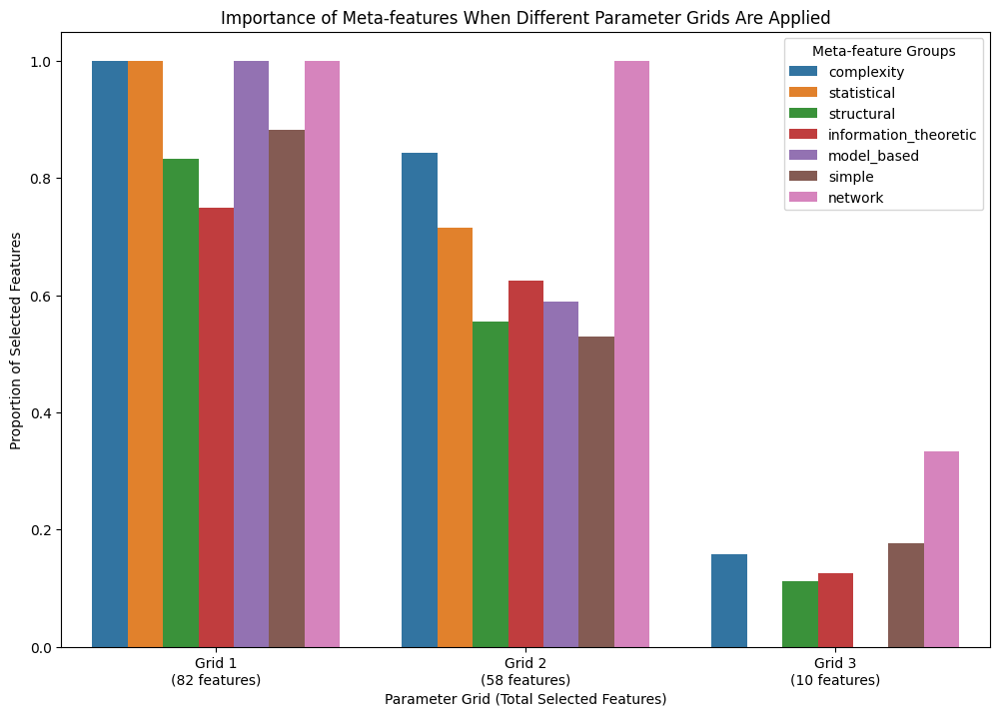

<Figure size 640x480 with 0 Axes>

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.01, 'l1_reg': 0.01},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 1.0, 'l1_reg': 1.0}
]

# List to store results
results = []

for i, params in enumerate(param_grids):
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
 subsampling_scheme=None,  # Set to None to disable subsampling
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )

    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)

    # Calculate the number of selected features in each group
    group_counts = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in np.where(selected_features)[0])

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'grid': i+1, 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Prepare data for plotting
plot_data = []
for result in results:
    grid_label = f'Grid {result["grid"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')


**MSGL Exp**

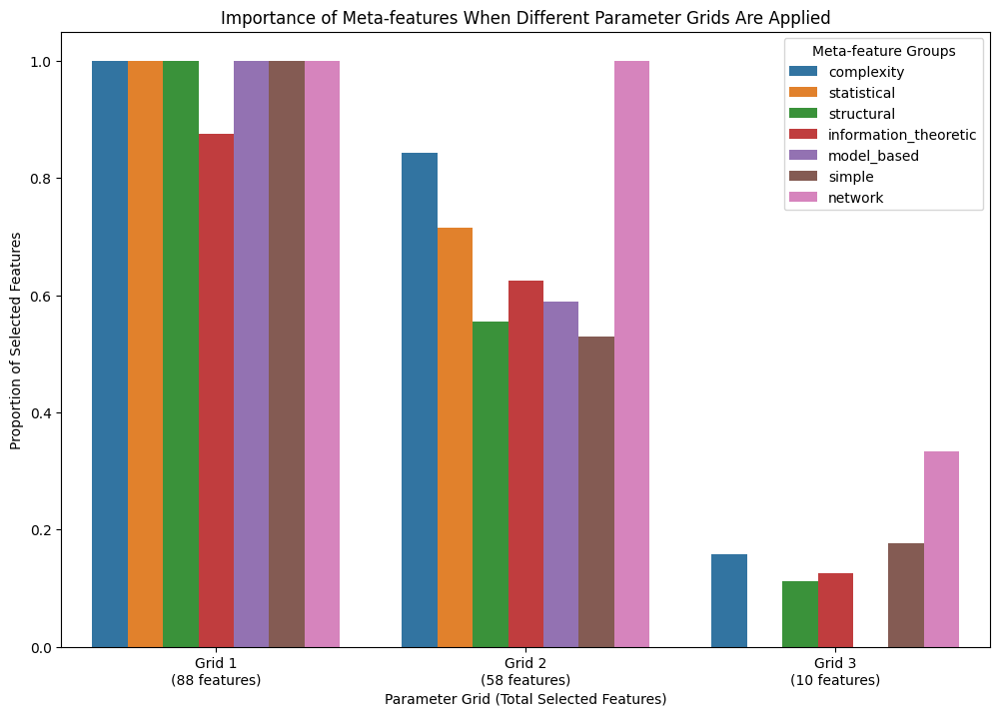

<Figure size 640x480 with 0 Axes>

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 1.0, 'l1_reg': 1.0}
]

# List to store results
results = []

for i, params in enumerate(param_grids):
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
 subsampling_scheme=None,  # Set to None to disable subsampling
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )

    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)

    # Calculate the number of selected features in each group
    group_counts = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in np.where(selected_features)[0])

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'grid': i+1, 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Prepare data for plotting
plot_data = []
for result in results:
    grid_label = f'Grid {result["grid"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')





















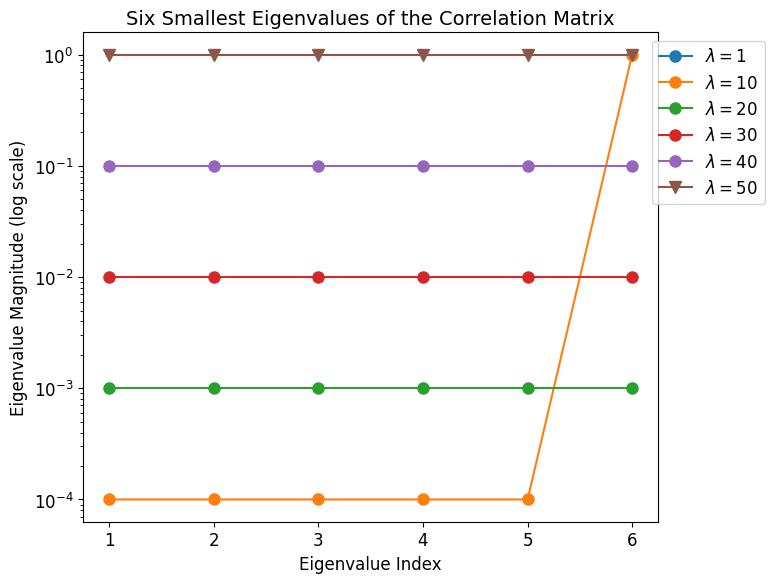

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data for the plot
eigenvalues = {
    1: [0, 0, 0, 0, 0, 0],
    10: [1e-4, 1e-4, 1e-4, 1e-4, 1e-4, 1],
    20: [1e-3, 1e-3, 1e-3, 1e-3, 1e-3, 1e-3],
    30: [1e-2, 1e-2, 1e-2, 1e-2, 1e-2, 1e-2],
    40: [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
    50: [1, 1, 1, 1, 1, 1]
}

x = np.arange(1, 7)  # x-axis values

plt.figure(figsize=(8, 6))

# Plot each lambda value with different markers/colors
for lambda_val, eig_vals in eigenvalues.items():
    marker_style = 'o' if lambda_val != 50 else 'v'  # Different marker for lambda=50
    plt.plot(x, eig_vals, marker=marker_style, markersize=8, label=f'$\lambda={lambda_val}$')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))  # Move legend outside the plot area
plt.grid(False)  # Remove grid lines
plt.tight_layout()

# Save and display the plot
plt.savefig('improved_plot.png', dpi=300)  # Save high-resolution version for paper
plt.show()


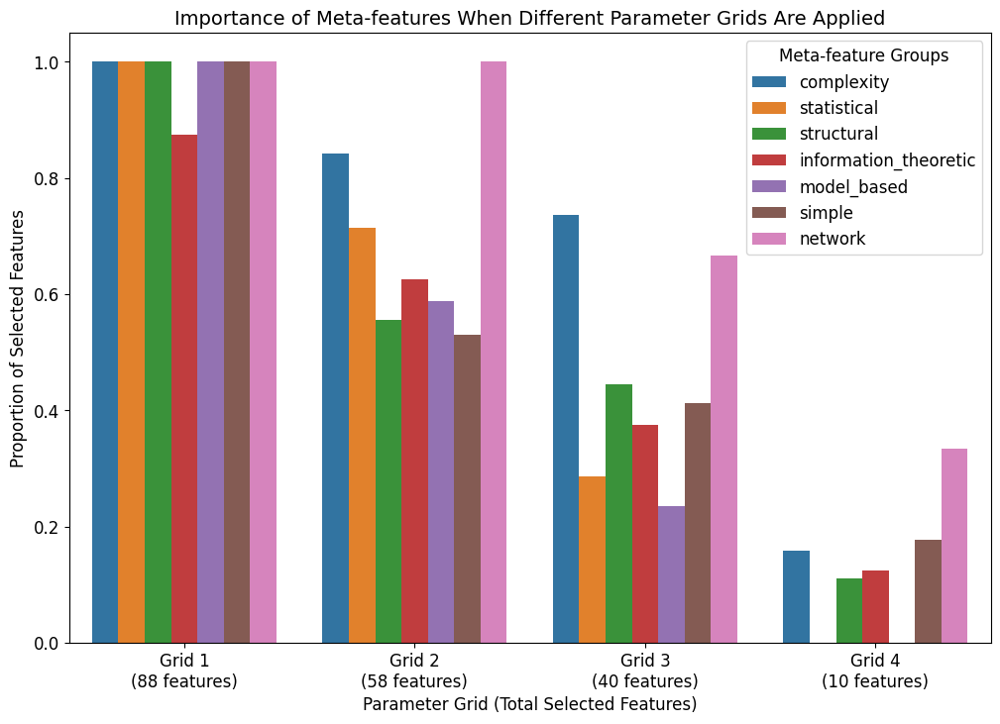

<Figure size 640x480 with 0 Axes>

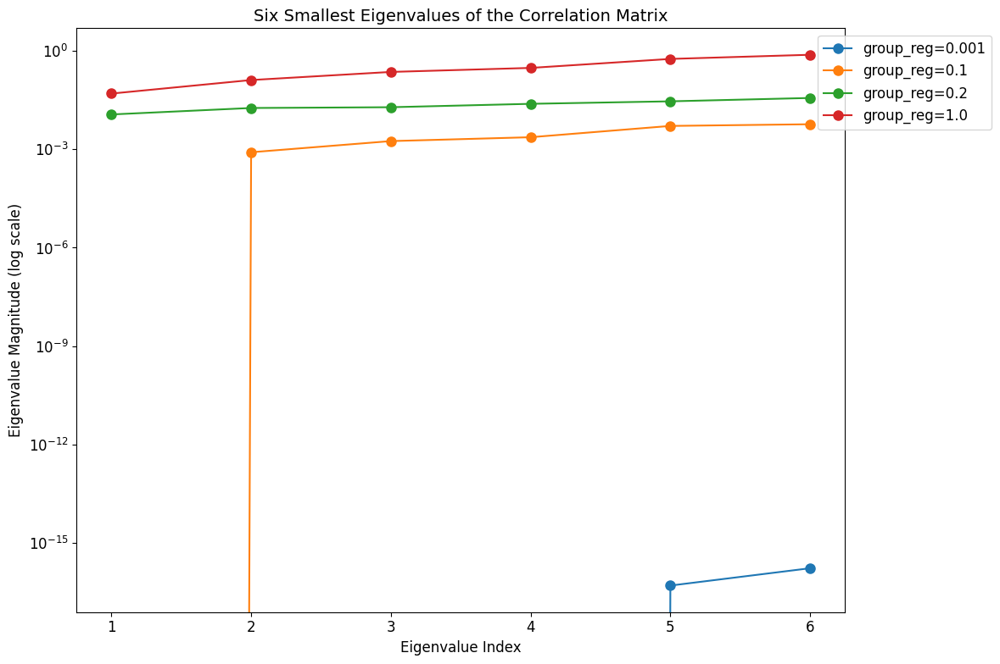

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 0.2, 'l1_reg': 0.3},
    {'group_reg': 1.0, 'l1_reg': 1.0},
]

# List to store results
results = []
eigenvalues_dict = {}

for i, params in enumerate(param_grids):
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,  # Set to None to disable subsampling
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )

    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'grid': i+1, 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Check if there are enough features to compute a correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        eigenvalues_dict[params['group_reg']] = sorted_eigenvalues[:6]
    else:
        eigenvalues_dict[params['group_reg']] = np.zeros(6)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Prepare data for plotting
plot_data = []
for result in results:
    grid_label = f'Grid {result["grid"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    marker_style = 'o'
    plt.plot(x, eig_vals, marker=marker_style, markersize=8, label=f'group_reg={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


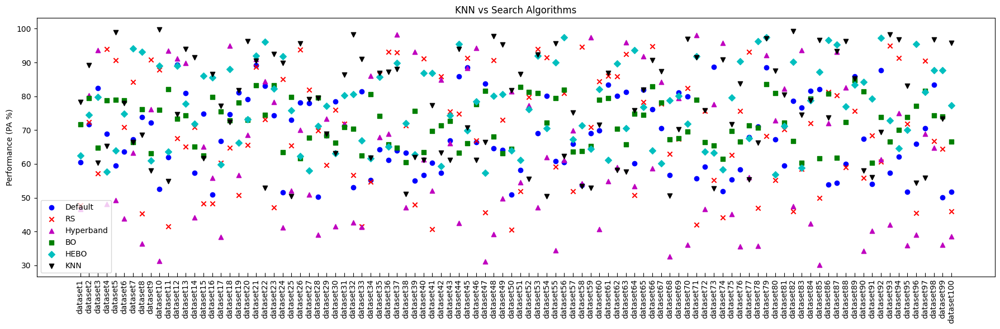

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Generate example data for 100 datasets
datasets = [f'dataset{i+1}' for i in range(100)]
algorithms = ['Default', 'RS', 'Hyperband', 'BO', 'HEBO', 'KNN']
performance = {
    'Default': np.random.uniform(50, 90, len(datasets)),
    'RS': np.random.uniform(40, 95, len(datasets)),
    'Hyperband': np.random.uniform(30, 100, len(datasets)),
    'BO': np.random.uniform(60, 85, len(datasets)),
    'HEBO': np.random.uniform(55, 98, len(datasets)),
    'KNN': np.random.uniform(50, 100, len(datasets))
}
markers = {'Default': 'o', 'RS': 'x', 'Hyperband': '^', 'BO': 's', 'HEBO': 'D', 'KNN': 'v'}
colors = {'Default': 'b', 'RS': 'r', 'Hyperband': 'm', 'BO': 'g', 'HEBO': 'c', 'KNN': 'k'}

fig, ax = plt.subplots(figsize=(18, 6))

for algo in algorithms:
    y_values = performance[algo]
    x_values = np.arange(len(datasets))
    ax.scatter(x_values, y_values, label=algo, marker=markers[algo], color=colors[algo])

ax.set_xticks(np.arange(len(datasets)))
ax.set_xticklabels(datasets, rotation=90, ha='center')
ax.set_ylabel('Performance (PA %)')
ax.set_title('KNN vs Search Algorithms')

# Add small tick lines towards inside
ax.tick_params(axis='x', which='both', direction='in', length=5)

ax.legend()

plt.tight_layout()
plt.show()


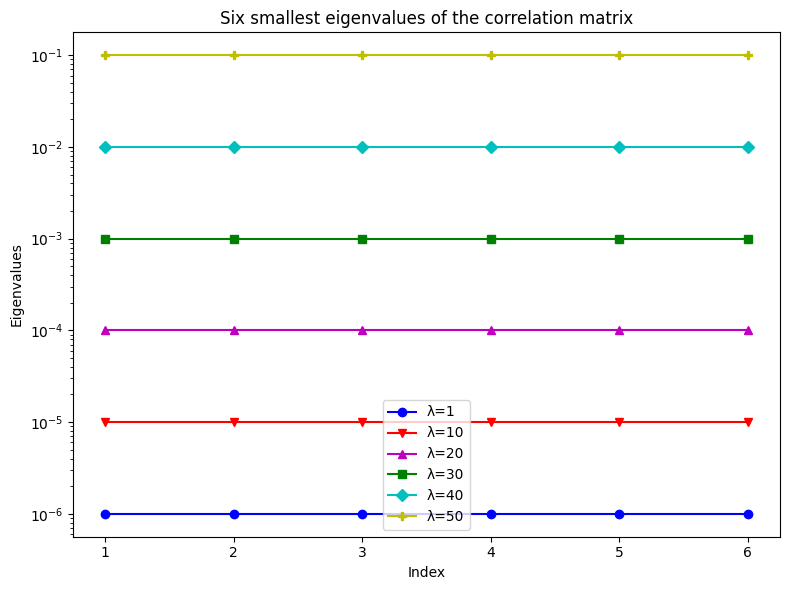

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Example data for eigenvalues
lambdas = [1, 10, 20, 30, 40, 50]
eigenvalues = {
    1: [1e-6, 1e-6, 1e-6, 1e-6, 1e-6, 1e-6],
    10: [1e-5, 1e-5, 1e-5, 1e-5, 1e-5, 1e-5],
    20: [1e-4, 1e-4, 1e-4, 1e-4, 1e-4, 1e-4],
    30: [1e-3, 1e-3, 1e-3, 1e-3, 1e-3, 1e-3],
    40: [1e-2, 1e-2, 1e-2, 1e-2, 1e-2, 1e-2],
    50: [1e-1, 1e-1, 1e-1, 1e-1, 1e-1, 1e-1]
}

markers = {1: 'o', 10: 'v', 20: '^', 30: 's', 40: 'D', 50: 'P'}
colors = {1: 'b', 10: 'r', 20: 'm', 30: 'g', 40: 'c', 50: 'y'}

fig, ax = plt.subplots(figsize=(8, 6))

for lam in lambdas:
    y_values = eigenvalues[lam]
    x_values = np.arange(1, len(y_values) + 1)
    ax.plot(x_values, y_values, label=f'λ={lam}', marker=markers[lam], color=colors[lam])

ax.set_yscale('log')
ax.set_xticks(np.arange(1, 7))
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Six smallest eigenvalues of the correlation matrix')
ax.legend()

plt.tight_layout()
plt.show()


In [ ]:
!pip install group-lasso

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import LeaveOneOut
import matplotlib.pyplot as plt
import seaborn as sns

# Load meta-features from provided Excel files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(f'{file}')
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 0.2, 'l1_reg': 0.3},
    {'group_reg': 1.0, 'l1_reg': 1.0},
]

# Perform leave-one-out cross-validation
loo = LeaveOneOut()
results = []

for train_index, test_index in loo.split(X):
    X_train, X_test = X[train_index], X[test_index]
    Y_train, Y_test = Y[train_index], Y[test_index]
    dataset_test = normalized_meta_features.iloc[test_index].index[0]

    test_results = {'Dataset': dataset_test}

    for i, params in enumerate(param_grids):
        # Train the model with the selected group of meta-features
        group_lasso_model = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,  # Set to None to disable subsampling
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )

        group_lasso_model.fit(X_train, Y_train)

        # Predict the performance for the test dataset
        Y_pred = group_lasso_model.predict(X_test)

        # Select the top 3 algorithms
        top_3_indices = np.argsort(Y_pred[0])[-3:][::-1]
        top_3_algorithms = performance_data.columns[top_3_indices]
        test_results[f'Model_{i+1}_Top_3'] = top_3_algorithms.tolist()

    results.append(test_results)

# Convert results to DataFrame
results_df = pd.DataFrame(results)

# Save the results to CSV
results_df.to_csv('algorithm_recommendation_results.csv', index=False)

# Display the results
results_df.head()


,Dataset,Model_1_Top_3,Model_2_Top_3,Model_3_Top_3,Model_4_Top_3
0,abalone,"[Bagging W weka.classifiers.rules.PART, Baggin...","[AdaBoostM1 W weka.classifiers.trees.J48, Bagg...","[Bagging W weka.classifiers.trees.J48, AdaBoos...","[Bagging W weka.classifiers.rules.PART, weka.c..."
1,acute-nephritis,"[Bagging W weka.classifiers.lazy.Kstar, weka.c...","[weka.classifiers.functions.SMO, AdaBoostM1 W ...","[weka.classifiers.functions.SMO, weka.classifi...","[weka.classifiers.trees.RandomForest, Bagging ..."
2,acute-urinary,"[AdaBoostM1 W weka.classifiers.lazy.Kstar, Ada...","[AdaBoostM1 W weka.classifiers.lazy.Kstar, wek...","[weka.classifiers.lazy.KStar, Bagging W weka.c...","[weka.classifiers.trees.RandomForest, Bagging ..."
3,anneal,"[AdaBoostM1 W weka.classifiers.lazy.Kstar, Ada...","[weka.classifiers.trees.RandomForest, weka.cla...","[weka.classifiers.trees.RandomForest, Bagging ...","[weka.classifiers.trees.RandomForest, Bagging ..."
4,audiology,[AdaBoostM1 W weka.classifiers.bayes.NaiveBaye...,[AdaBoostM1 W weka.classifiers.bayes.NaiveBaye...,[AdaBoostM1 W weka.classifiers.bayes.NaiveBaye...,"[weka.classifiers.trees.RandomForest, AdaBoost..."


In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import LeaveOneOut
import matplotlib.pyplot as plt
import seaborn as sns

# Load meta-features from provided Excel files
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(f'{file}')
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 0.2, 'l1_reg': 0.3},
    {'group_reg': 1.0, 'l1_reg': 1.0},
]

# Initialize storage for metrics
results = []
metrics_df = []

# Perform leave-one-out cross-validation
loo = LeaveOneOut()

for train_index, test_index in loo.split(X):
    X_train, X_test = X[train_index], X[test_index]
    Y_train, Y_test = Y[train_index], Y[test_index]
    dataset_test = normalized_meta_features.iloc[test_index].index[0]

    test_results = {'Dataset': dataset_test}

    for i, params in enumerate(param_grids):
        # Train the model with the selected group of meta-features
        group_lasso_model = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,  # Set to None to disable subsampling
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )

        group_lasso_model.fit(X_train, Y_train)

        # Predict the performance for the test dataset
        Y_pred = group_lasso_model.predict(X_test)

        # Select the top 3 algorithms
        top_3_indices = np.argsort(Y_pred[0])[-3:][::-1]
        top_3_algorithms = performance_data.columns[top_3_indices]
        test_results[f'Model_{i+1}_Top_3'] = top_3_algorithms.tolist()

        # Calculate metrics for the top 3 recommendations
        ca_values = Y_test[0, top_3_indices]
        best_ca = np.max(Y_test)
        worst_ca = np.min(Y_test)
        std_ca = np.std(Y_test)

        # CA
        for j, ca in enumerate(ca_values):
            test_results[f'Model_{i+1}_CA_{j+1}'] = ca

        # RA
        ra_values = (ca_values - worst_ca) / (best_ca - worst_ca)
        for j, ra in enumerate(ra_values):
            test_results[f'Model_{i+1}_RA_{j+1}'] = ra

        # HR
        hr_values = [(1 if ca >= (best_ca - 0.1 * std_ca) else 0) for ca in ca_values]
        for j, hr in enumerate(hr_values):
            test_results[f'Model_{i+1}_HR_{j+1}'] = hr

        # NDCG
        sorted_ca = np.sort(ca_values)[::-1]
        dcg = np.sum([(2**ca - 1) / np.log2(idx + 2) for idx, ca in enumerate(ca_values)])
        idcg = np.sum([(2**ca - 1) / np.log2(idx + 2) for idx, ca in enumerate(sorted_ca)])
        ndcg = dcg / idcg if idcg > 0 else 0
        test_results[f'Model_{i+1}_NDCG'] = ndcg

    results.append(test_results)

# Convert results to DataFrame
results_df = pd.DataFrame(results)

# Calculate aggregated metrics over all datasets
numeric_columns = results_df.select_dtypes(include=[np.number]).columns
aggregated_metrics = {col: results_df[col].mean() for col in numeric_columns}

aggregated_metrics_df = pd.DataFrame([aggregated_metrics])

# Save the results to CSV
results_df.to_csv('algorithm_recommendation_results1.csv', index=False)
aggregated_metrics_df.to_csv('aggregated_metrics_results1.csv', index=False)

# Display the results
print(results_df.head())
print(aggregated_metrics_df.head())


           Dataset                                      Model_1_Top_3  \
0          abalone  [Bagging W weka.classifiers.rules.PART, Baggin...   
1  acute-nephritis  [Bagging W weka.classifiers.lazy.Kstar, weka.c...   
2    acute-urinary  [AdaBoostM1 W weka.classifiers.lazy.Kstar, Ada...   
3           anneal  [AdaBoostM1 W weka.classifiers.lazy.Kstar, Ada...   
4        audiology  [AdaBoostM1 W weka.classifiers.bayes.NaiveBaye...   

   Model_1_CA_1  Model_1_CA_2  Model_1_CA_3  Model_1_RA_1  Model_1_RA_2  \
0     23.545105     23.058713     22.579228      0.735368      0.656498   
1    100.000000     98.977778    100.000000      1.000000      0.796909   
2    100.000000    100.000000    100.000000      1.000000      1.000000   
3     97.176839     99.435266     99.604954      0.828006      0.985790   
4     77.686842     69.615789     68.528947      0.796840      0.486226   

   Model_1_RA_3  Model_1_HR_1  Model_1_HR_2  ...  Model_4_CA_1  Model_4_CA_2  \
0      0.578749             0 

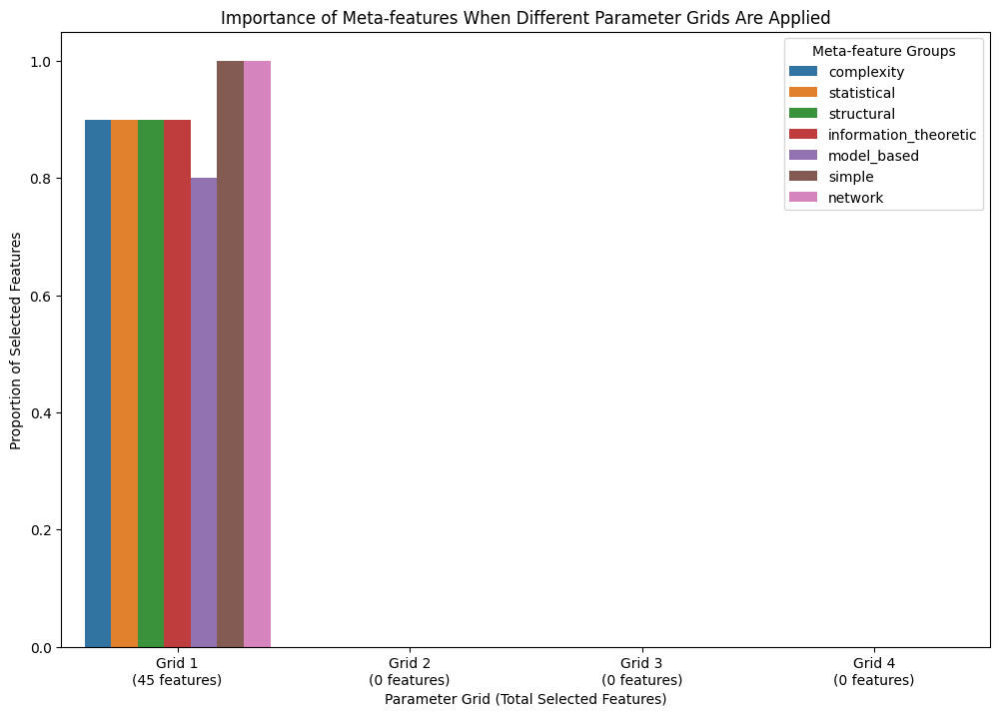

<Figure size 640x480 with 0 Axes>

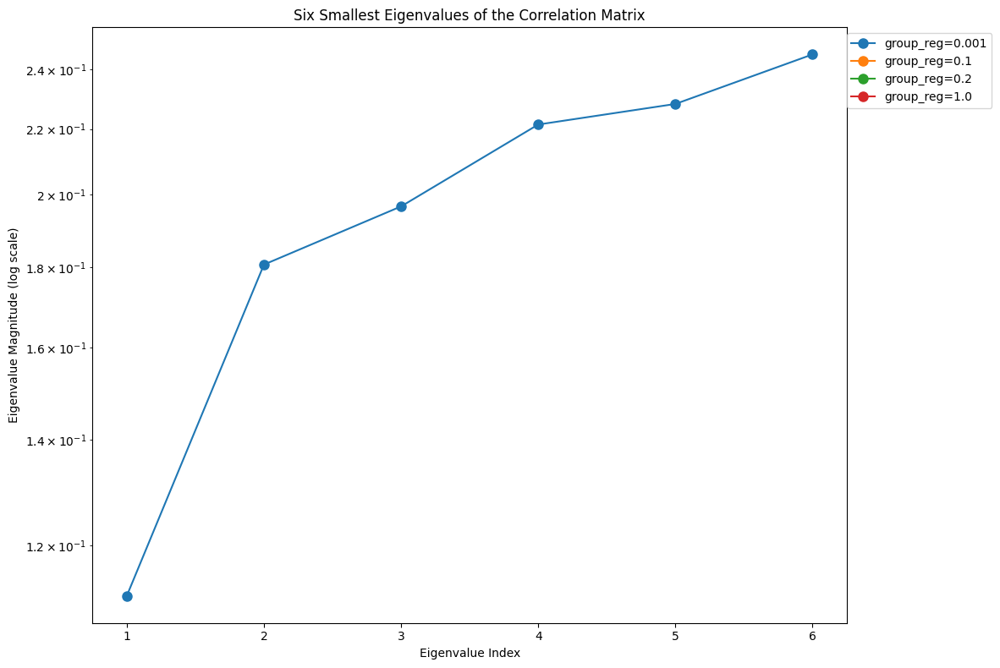

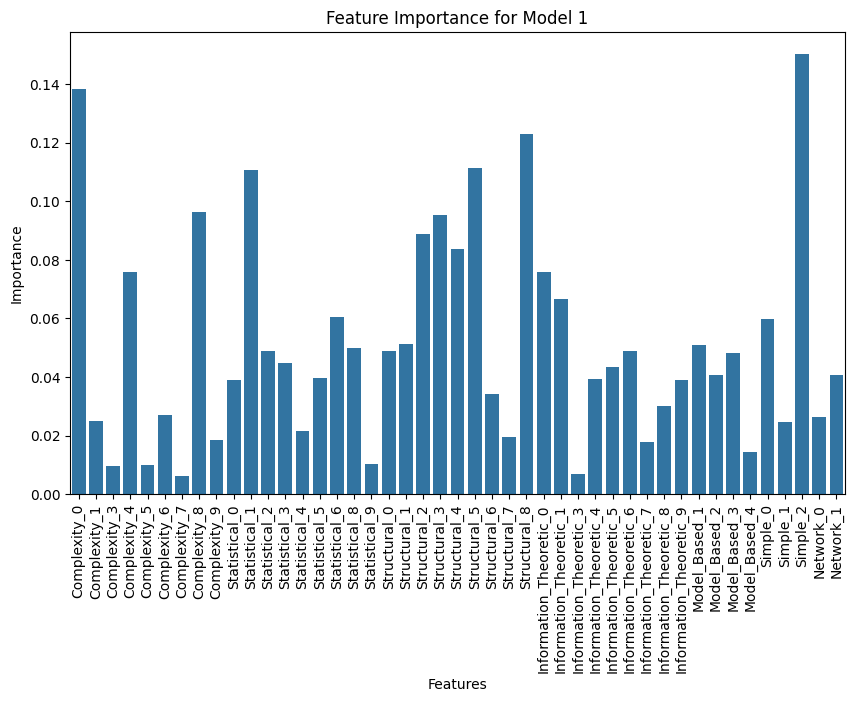

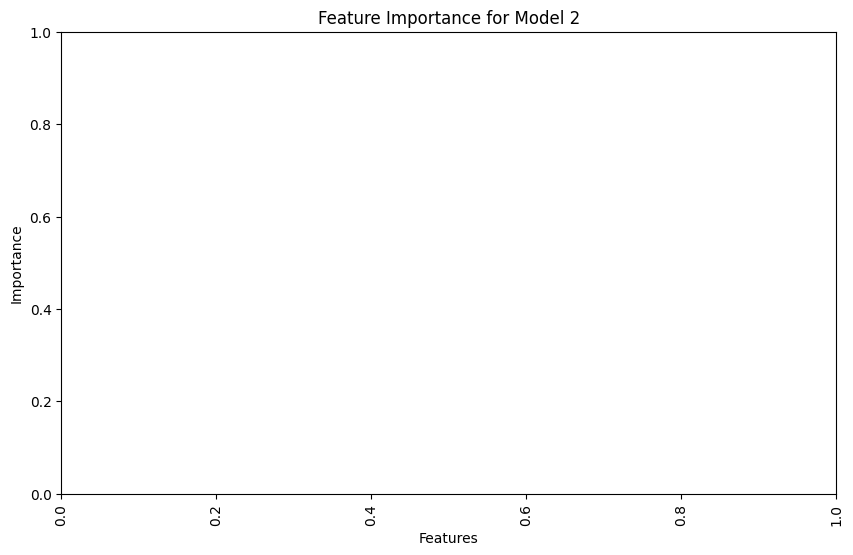

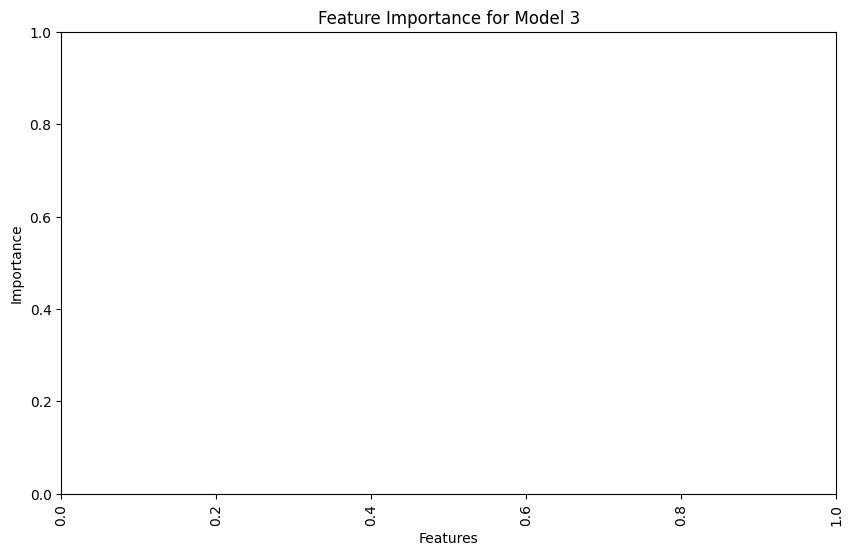

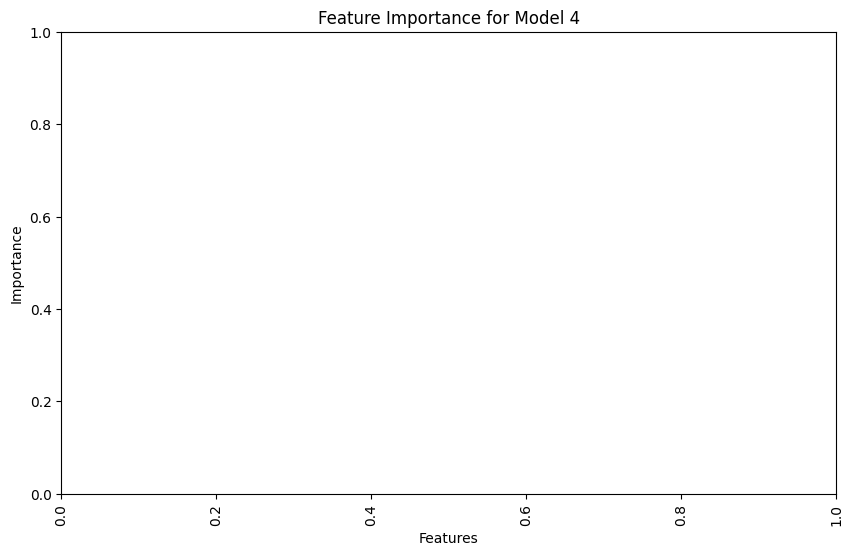

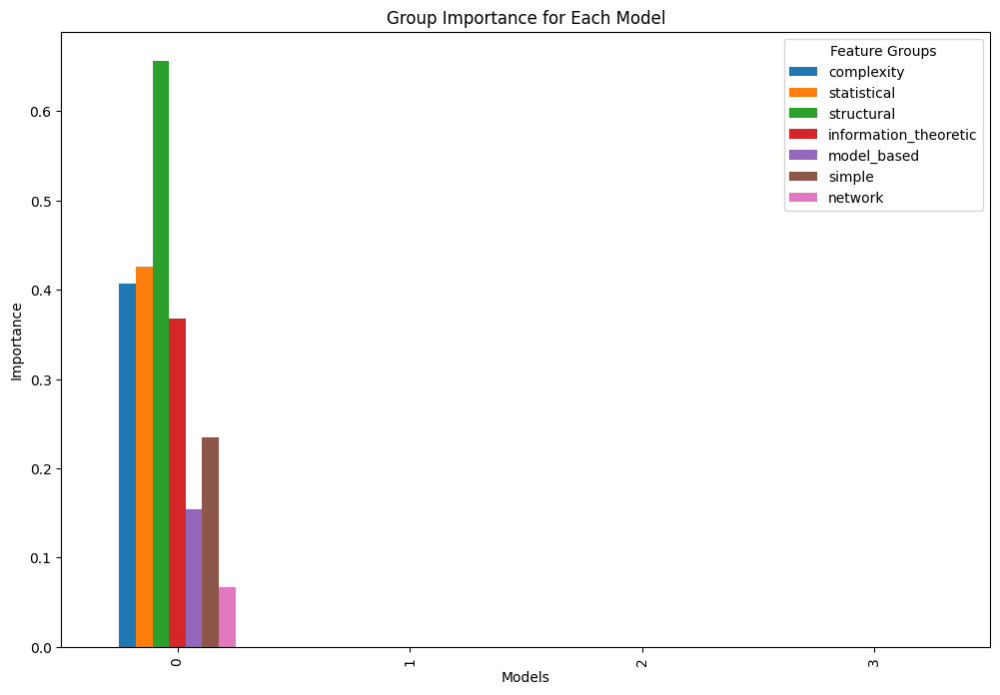

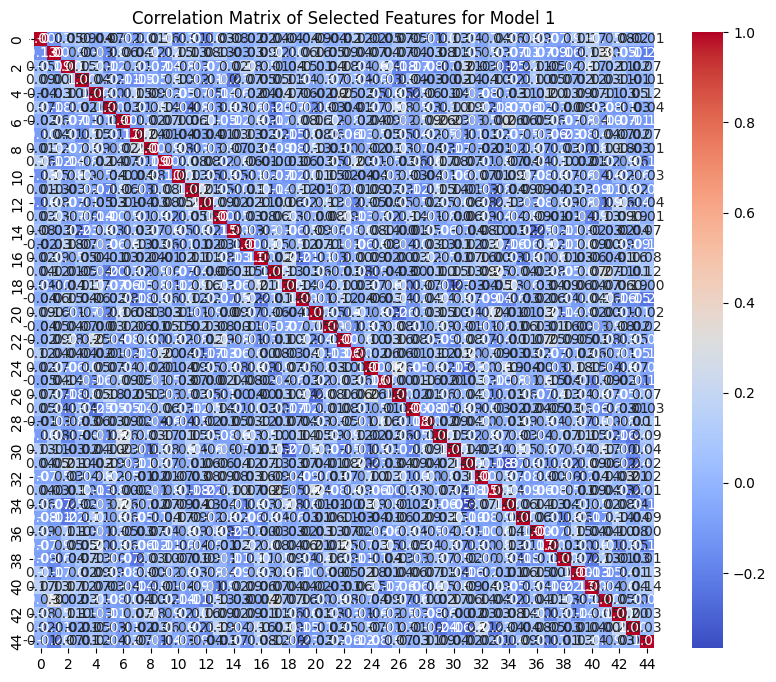

ValueError: zero-size array to reduction operation fmin which has no identity

<Figure size 1000x800 with 0 Axes>

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Set random seed for reproducibility
np.random.seed(42)

# Generate synthetic meta-features
n_datasets = 100
n_features = 50

meta_features = {
    'complexity': pd.DataFrame(np.random.rand(n_datasets, 10), columns=[f'Complexity_{i}' for i in range(10)]),
    'statistical': pd.DataFrame(np.random.rand(n_datasets, 10), columns=[f'Statistical_{i}' for i in range(10)]),
    'structural': pd.DataFrame(np.random.rand(n_datasets, 10), columns=[f'Structural_{i}' for i in range(10)]),
    'information_theoretic': pd.DataFrame(np.random.rand(n_datasets, 10), columns=[f'Information_Theoretic_{i}' for i in range(10)]),
    'model_based': pd.DataFrame(np.random.rand(n_datasets, 5), columns=[f'Model_Based_{i}' for i in range(5)]),
    'simple': pd.DataFrame(np.random.rand(n_datasets, 3), columns=[f'Simple_{i}' for i in range(3)]),
    'network': pd.DataFrame(np.random.rand(n_datasets, 2), columns=[f'Network_{i}' for i in range(2)])
}

# Add a 'Datasets' column to each group
for group in meta_features:
    meta_features[group]['Datasets'] = [f'Dataset_{i}' for i in range(n_datasets)]

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Generate synthetic performance data for 5 algorithms
algorithms = [f'Algorithm_{i}' for i in range(5)]
performance_data = pd.DataFrame(np.random.rand(n_datasets, len(algorithms)), columns=algorithms)
performance_data['Datasets'] = [f'Dataset_{i}' for i in range(n_datasets)]
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[:-1]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[:-1]),
    'structural': list(meta_features['structural'].columns[:-1]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[:-1]),
    'model_based': list(meta_features['model_based'].columns[:-1]),
    'simple': list(meta_features['simple'].columns[:-1]),
    'network': list(meta_features['network'].columns[:-1])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 0.2, 'l1_reg': 0.3},
    {'group_reg': 1.0, 'l1_reg': 1.0},
]

# List to store results
results = []
eigenvalues_dict = {}
coefficients_dict = {}

for i, params in enumerate(param_grids):
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,  # Set to None to disable subsampling
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )

    gl.fit(X_train, Y_train)

    # Get the coefficients and store them
    coef = gl.coef_
    coefficients_dict[i] = coef

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'grid': i+1, 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Check if there are enough features to compute a correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        eigenvalues_dict[params['group_reg']] = sorted_eigenvalues[:6]
    else:
        eigenvalues_dict[params['group_reg']] = np.zeros(6)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Prepare data for plotting
plot_data = []
for result in results:
    grid_label = f'Grid {result["grid"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    marker_style = 'o'
    plt.plot(x, eig_vals, marker=marker_style, markersize=8, label=f'group_reg={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()

# Feature importance and group importance analysis
selected_features_dict = {}
feature_importance = {}
group_importance = {}

for i, params in enumerate(param_grids):
    coef = coefficients_dict[i]
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]
    selected_features_dict[i] = selected_features_indices

    feature_importance[i] = np.abs(coef[selected_features_indices, :]).sum(axis=1)

    group_importance[i] = {}
    for group, features in group_mapping.items():
        group_indices = [combined_meta_features.columns.get_loc(f) for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices]
        group_importance[i][group] = np.abs(coef[group_indices, :]).sum()

# Plot feature importance for each model
for i in range(len(param_grids)):
    plt.figure(figsize=(10, 6))
    feature_names = np.array(combined_meta_features.columns)[selected_features_dict[i]]
    sns.barplot(x=feature_names, y=feature_importance[i])
    plt.xticks(rotation=90)
    plt.title(f'Feature Importance for Model {i+1}')
    plt.xlabel('Features')
    plt.ylabel('Importance')
    plt.show()

# Plot group importance for each model
group_importance_df = pd.DataFrame(group_importance).T
group_importance_df.plot(kind='bar', figsize=(12, 8))
plt.title('Group Importance for Each Model')
plt.xlabel('Models')
plt.ylabel('Importance')
plt.legend(title='Feature Groups')
plt.show()

# Correlation matrix of selected features for each model
for i in range(len(param_grids)):
    selected_features_indices = selected_features_dict[i]
    selected_X = X[:, selected_features_indices]
    correlation_matrix = np.corrcoef(selected_X, rowvar=False)
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm')
    plt.title(f'Correlation Matrix of Selected Features for Model {i+1}')
    plt.show()

# Distribution of feature coefficients for each model
for i in range(len(param_grids)):
    coef = coefficients_dict[i]
    selected_features_indices = selected_features_dict[i]
    selected_coefs = coef[selected_features_indices, :]
    plt.figure(figsize=(10, 6))
    sns.histplot(selected_coefs.flatten(), kde=True)
    plt.title(f'Distribution of Coefficients for Selected Features in Model {i+1}')
    plt.xlabel('Coefficient Value')
    plt.ylabel('Frequency')
    plt.show()


In [ ]:
!pip install group-lasso

/usr/local/lib/python3.10/dist-packages/group_lasso/_group_lasso.py:457: UserWarning: 
The behaviour has changed since v1.1.1, before then, a bug in the optimisation
algorithm made it so the regularisation parameter was scaled by the largest
eigenvalue of the covariance matrix.

To use the old behaviour, initialise the class with the keyword argument
`old_regularisation=True`.

To supress this warning, initialise the class with the keyword argument
`supress_warning=True`

  warnings.warn(_OLD_REG_WARNING)


Meta-features (X):
 [[-5.22232968e-01  6.03022689e-01 -6.20173673e-01  6.20173673e-01
  -6.20173673e-01  1.54919334e+00]
 [-1.56669890e+00 -1.20604538e+00 -1.36438208e+00  1.36438208e+00
  -1.36438208e+00 -8.59975057e-16]
 [ 5.22232968e-01 -3.01511345e-01  1.24034735e-01 -8.68243142e-01
   1.24034735e-01  7.74596669e-01]
 [-5.22232968e-01  1.50755672e+00  8.68243142e-01 -1.61245155e+00
   8.68243142e-01 -7.74596669e-01]
 [ 1.56669890e+00 -1.20604538e+00  1.61245155e+00  6.20173673e-01
   1.61245155e+00 -1.54919334e+00]
 [ 5.22232968e-01  6.03022689e-01 -6.20173673e-01 -1.24034735e-01
  -6.20173673e-01 -8.59975057e-16]]
Performance (Y):
 [[0.75 0.82 0.78 0.8 ]
 [0.7  0.85 0.79 0.83]
 [0.68 0.8  0.76 0.81]
 [0.72 0.84 0.77 0.82]
 [0.73 0.83 0.78 0.8 ]
 [0.71 0.82 0.76 0.79]]
Estimated Coefficients (W):
 [[ 0. -0. -0. -0.]
 [ 0. -0. -0. -0.]
 [ 0. -0. -0. -0.]
 [ 0.  0.  0.  0.]
 [ 0. -0. -0. -0.]
 [ 0. -0. -0. -0.]]


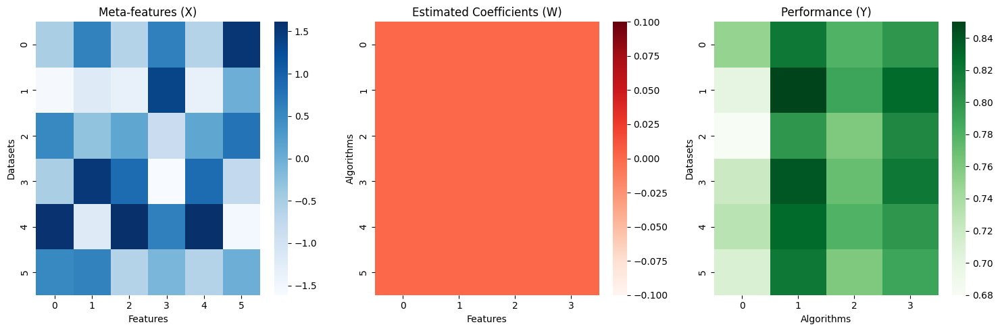

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Sample meta-feature data (X) - 6 datasets and 6 meta-features
meta_features = np.array([
    [0.2, 0.8, 0.5, 0.7, 0.3, 0.9],
    [0.1, 0.6, 0.4, 0.8, 0.2, 0.7],
    [0.3, 0.7, 0.6, 0.5, 0.4, 0.8],
    [0.2, 0.9, 0.7, 0.4, 0.5, 0.6],
    [0.4, 0.6, 0.8, 0.7, 0.6, 0.5],
    [0.3, 0.8, 0.5, 0.6, 0.3, 0.7]
])

# Sample performance data (Y) - 6 datasets and 4 algorithms
performance = np.array([
    [0.75, 0.82, 0.78, 0.80],
    [0.70, 0.85, 0.79, 0.83],
    [0.68, 0.80, 0.76, 0.81],
    [0.72, 0.84, 0.77, 0.82],
    [0.73, 0.83, 0.78, 0.80],
    [0.71, 0.82, 0.76, 0.79]
])

# Normalize the meta-features
scaler = StandardScaler()
X = scaler.fit_transform(meta_features)

# Define group indices (for simplicity, assuming 2 groups)
group_indices = [0, 1, 2, 3, 4, 5]

# Initialize the Group Lasso model
group_lasso = GroupLasso(
    groups=group_indices,
    group_reg=0.1,
    l1_reg=0.1,
    n_iter=5000,
    scale_reg='group_size',
    fit_intercept=True,
    random_state=42
)

# Fit the model
group_lasso.fit(X, performance)

# Get the coefficient matrix (W)
W = group_lasso.coef_

# Print the matrices
print("Meta-features (X):\n", X)
print("Performance (Y):\n", performance)
print("Estimated Coefficients (W):\n", W)

# Plot the results to create a similar figure
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot X
sns.heatmap(X, cmap='Blues', ax=axs[0])
axs[0].set_title('Meta-features (X)')
axs[0].set_xlabel('Features')
axs[0].set_ylabel('Datasets')

# Plot W
sns.heatmap(W, cmap='Reds', ax=axs[1])
axs[1].set_title('Estimated Coefficients (W)')
axs[1].set_xlabel('Features')
axs[1].set_ylabel('Algorithms')

# Plot Y
sns.heatmap(performance, cmap='Greens', ax=axs[2])
axs[2].set_title('Performance (Y)')
axs[2].set_xlabel('Algorithms')
axs[2].set_ylabel('Datasets')

plt.tight_layout()
plt.show()


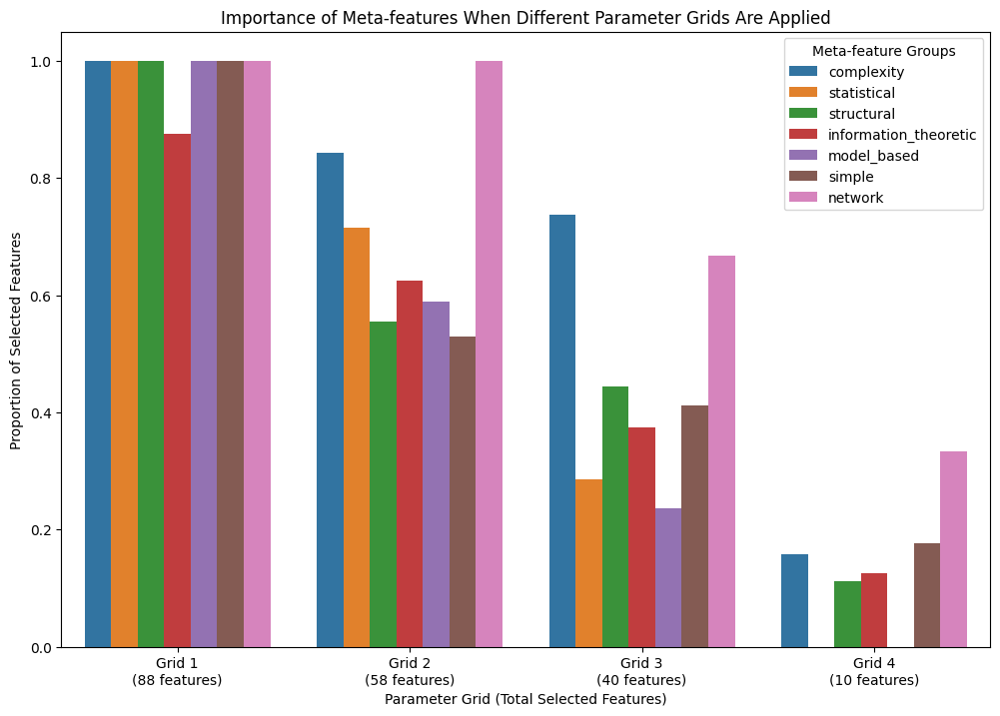

<Figure size 640x480 with 0 Axes>

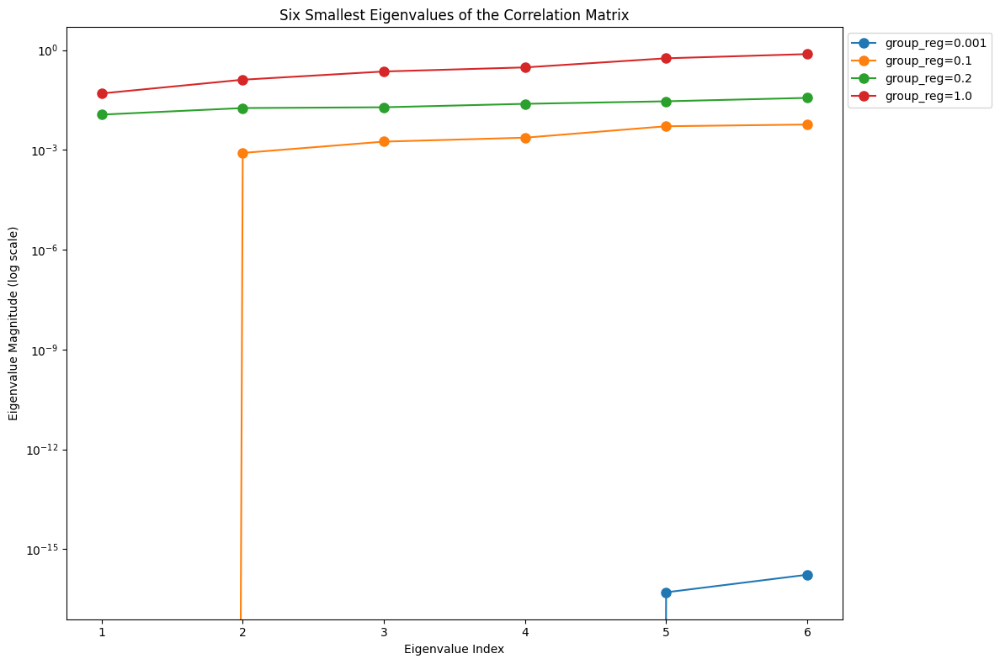

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# Define hyperparameter grids
param_grids = [
    {'group_reg': 0.001, 'l1_reg': 0.009},
    {'group_reg': 0.1, 'l1_reg': 0.1},
    {'group_reg': 0.2, 'l1_reg': 0.3},
    {'group_reg': 1.0, 'l1_reg': 1.0},
]

# List to store results
results = []
eigenvalues_dict = {}

for i, params in enumerate(param_grids):
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,  # Set to None to disable subsampling
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )

    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'grid': i+1, 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Check if there are enough features to compute a correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        eigenvalues_dict[params['group_reg']] = sorted_eigenvalues[:6]
    else:
        eigenvalues_dict[params['group_reg']] = np.zeros(6)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Prepare data for plotting
plot_data = []
for result in results:
    grid_label = f'Grid {result["grid"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

# Plot the importances
plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    marker_style = 'o'
    plt.plot(x, eig_vals, marker=marker_style, markersize=8, label=f'group_reg={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


In [ ]:
!pip show group-lasso

Name: group-lasso
Version: 1.5.0
Summary: Fast group lasso regularised linear models in a sklearn-style API.
Home-page: UNKNOWN
Author: Yngve Mardal Moe
Author-email: yngve.m.moe@gmail.com
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: numpy, scikit-learn
Required-by: 


In [ ]:
!pip install group-lasso --no-cache-dir

ValueError: x and y must have same first dimension, but have shapes (6,) and (4,)

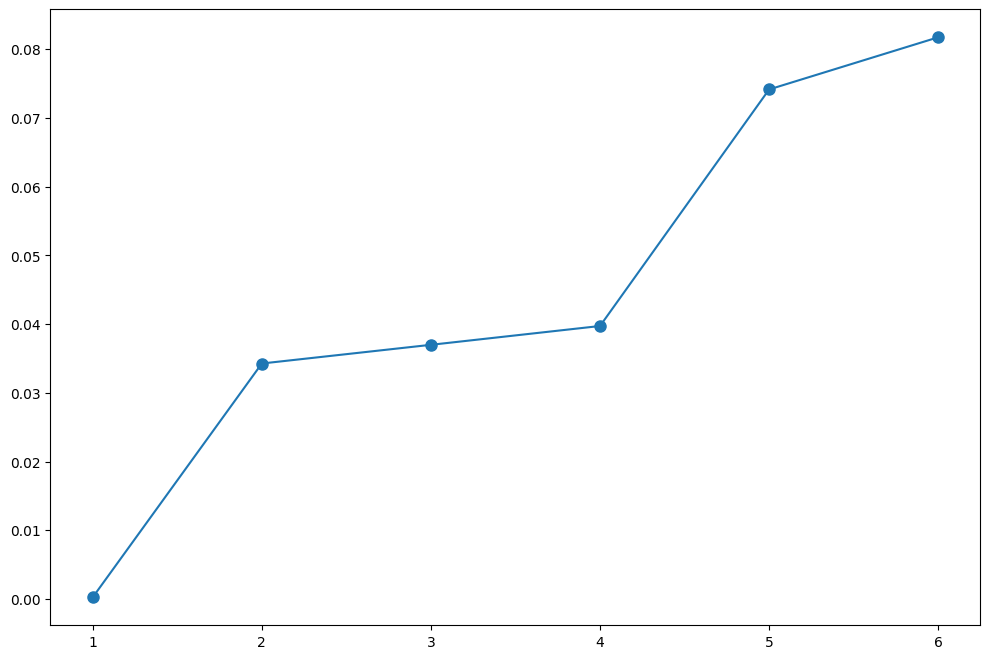

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grids for different `P` and `group_reg` values
param_grids = [
    {'group_reg': 1, 'l1_reg': 0.1},
    {'group_reg': 10, 'l1_reg': 0.1},
    {'group_reg': 20, 'l1_reg': 0.1},
    {'group_reg': 30, 'l1_reg': 0.1},
    {'group_reg': 40, 'l1_reg': 0.1},
    {'group_reg': 50, 'l1_reg': 0.1},
]

# Define the number of groups (P values)
group_counts = [8, 40]

# List to store results
eigenvalues_dict = {}

for P in group_counts:
    # Create group indices for the current P
    group_indices = np.array_split(np.arange(normalized_meta_features.shape[1]), P)
    group_indices_flat = [idx for sublist in group_indices for idx in sublist]

    for params in param_grids:
        # Instantiate and fit the Group Lasso model
        gl = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],  # This corresponds to λ
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )
        gl.fit(X_train, Y_train)

        # Get the coefficients
        coef = gl.coef_

        # Determine selected features
        selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
        selected_features_indices = np.where(selected_features)[0]

        # Calculate the six smallest eigenvalues of the correlation matrix
        selected_X = X[:, selected_features_indices]
        if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
            correlation_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = eigvals(correlation_matrix)
            sorted_eigenvalues = np.sort(eigenvalues)
            eigenvalues_dict[(P, params['group_reg'])] = sorted_eigenvalues[:6]
        else:
            eigenvalues_dict[(P, params['group_reg'])] = np.zeros(6)

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame.from_dict(eigenvalues_dict, orient='index')
results_df.to_csv('eigenvalues_results.csv')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for (P, group_reg), eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'P={P}, λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


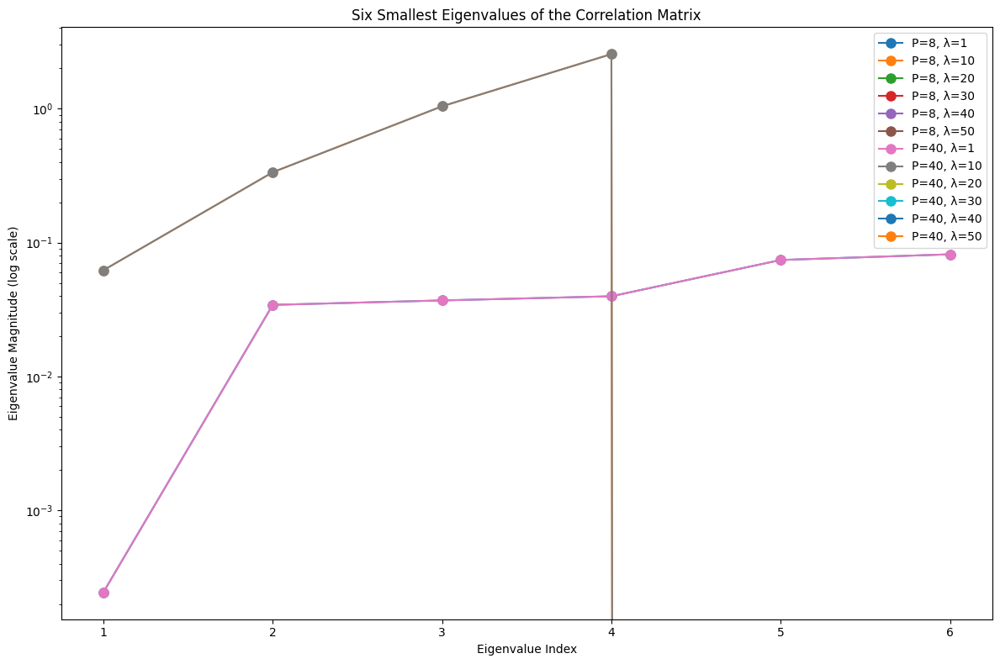

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grids for different `P` and `group_reg` values
param_grids = [
    {'group_reg': 1, 'l1_reg': 0.1},
    {'group_reg': 10, 'l1_reg': 0.1},
    {'group_reg': 20, 'l1_reg': 0.1},
    {'group_reg': 30, 'l1_reg': 0.1},
    {'group_reg': 40, 'l1_reg': 0.1},
    {'group_reg': 50, 'l1_reg': 0.1},
]

# Define the number of groups (P values)
group_counts = [8, 40]

# List to store results
eigenvalues_dict = {}

for P in group_counts:
    # Create group indices for the current P
    group_indices = np.array_split(np.arange(normalized_meta_features.shape[1]), P)
    group_indices_flat = [idx for sublist in group_indices for idx in sublist]

    for params in param_grids:
        # Instantiate and fit the Group Lasso model
        gl = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],  # This corresponds to λ
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )
        gl.fit(X_train, Y_train)

        # Get the coefficients
        coef = gl.coef_

        # Determine selected features
        selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
        selected_features_indices = np.where(selected_features)[0]

        # Calculate the six smallest eigenvalues of the correlation matrix
        selected_X = X[:, selected_features_indices]
        if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
            correlation_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = eigvals(correlation_matrix)
            sorted_eigenvalues = np.sort(eigenvalues)
            smallest_eigenvalues = sorted_eigenvalues[:6]
        else:
            smallest_eigenvalues = np.zeros(6)

        # Pad with zeros if necessary
        if len(smallest_eigenvalues) < 6:
            smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

        eigenvalues_dict[(P, params['group_reg'])] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame.from_dict(eigenvalues_dict, orient='index')
results_df.to_csv('eigenvalues_results.csv')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for (P, group_reg), eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'P={P}, λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


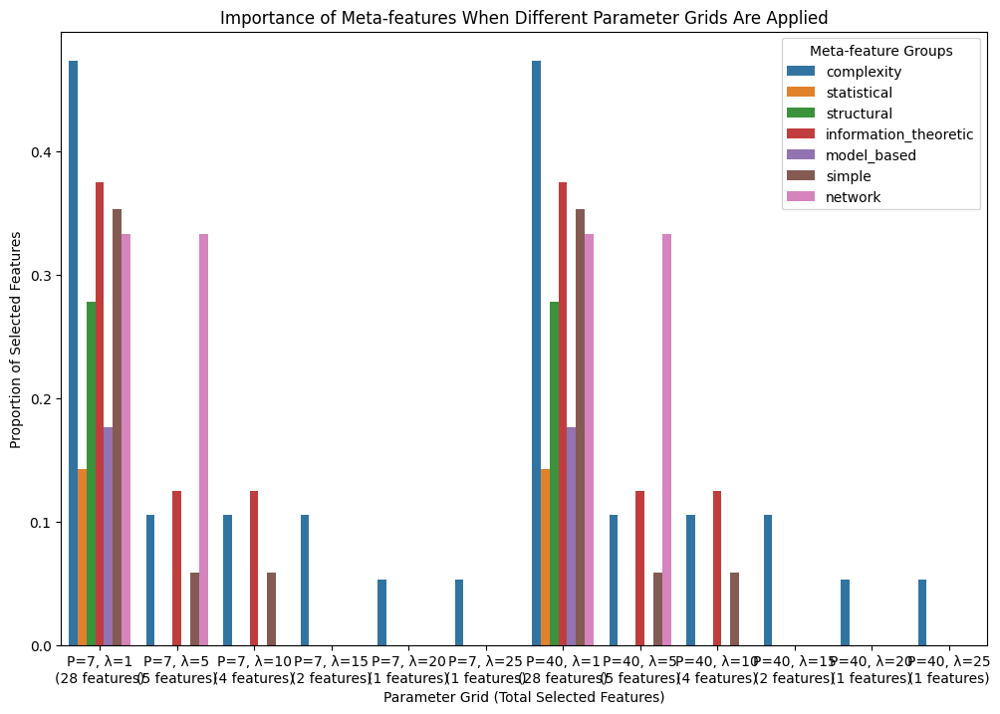

<Figure size 640x480 with 0 Axes>

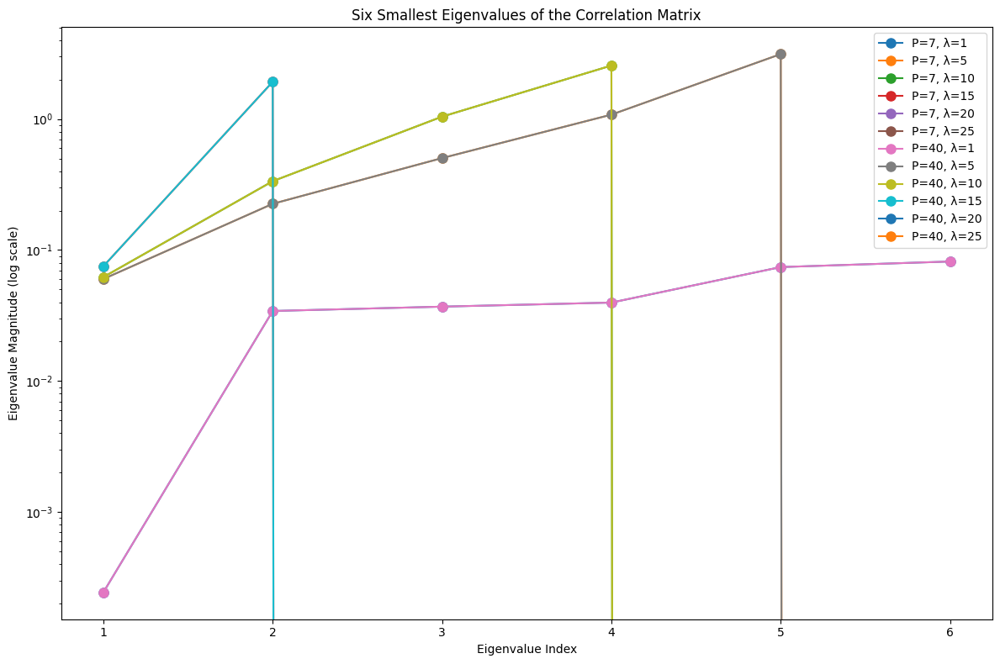

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grids for different `P` and `group_reg` values
param_grids = [
    {'group_reg': 1, 'l1_reg': 0.1},
    {'group_reg': 5, 'l1_reg': 0.1},
    {'group_reg': 10, 'l1_reg': 0.1},
    {'group_reg': 15, 'l1_reg': 0.1},
    {'group_reg': 20, 'l1_reg': 0.1},
    {'group_reg': 25, 'l1_reg': 0.1},
]

# Define the number of groups (P values)
group_counts = [7, 40]

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# List to store results
results = []
eigenvalues_dict = {}

for P in group_counts:
    # Create group indices for the current P
    group_indices = np.array_split(np.arange(normalized_meta_features.shape[1]), P)
    group_indices_flat = [idx for sublist in group_indices for idx in sublist]

    for params in param_grids:
        # Instantiate and fit the Group Lasso model
        gl = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],  # This corresponds to λ
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )
        gl.fit(X_train, Y_train)

        # Get the coefficients
        coef = gl.coef_

        # Determine selected features
        selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
        selected_features_indices = np.where(selected_features)[0]

        # Calculate the number of selected features in each group
        group_counts = {group: 0 for group in group_mapping}
        for group, features in group_mapping.items():
            group_counts[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

        # Calculate the proportion of selected features in each group
        group_proportions = {group: group_counts[group] / len(group_mapping[group]) for group in group_mapping}

        total_selected_features = np.sum(selected_features)
        result = {'P': P, 'group_reg': params['group_reg'], 'total_selected': total_selected_features}
        result.update(group_proportions)
        results.append(result)

        # Calculate the six smallest eigenvalues of the correlation matrix
        selected_X = X[:, selected_features_indices]
        if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
            correlation_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = eigvals(correlation_matrix)
            sorted_eigenvalues = np.sort(eigenvalues)
            smallest_eigenvalues = sorted_eigenvalues[:6]
        else:
            smallest_eigenvalues = np.zeros(6)

        # Pad with zeros if necessary
        if len(smallest_eigenvalues) < 6:
            smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

        eigenvalues_dict[(P, params['group_reg'])] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Plot the importances
plot_data = []
for result in results:
    grid_label = f'P={result["P"]}, λ={result["group_reg"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for (P, group_reg), eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'P={P}, λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


plot_df for P=7:
                Grid                  Group     Ratio
0  λ=7\n(4 features)             complexity  0.105263
1  λ=7\n(4 features)            statistical  0.000000
2  λ=7\n(4 features)             structural  0.000000
3  λ=7\n(4 features)  information_theoretic  0.125000
4  λ=7\n(4 features)            model_based  0.000000


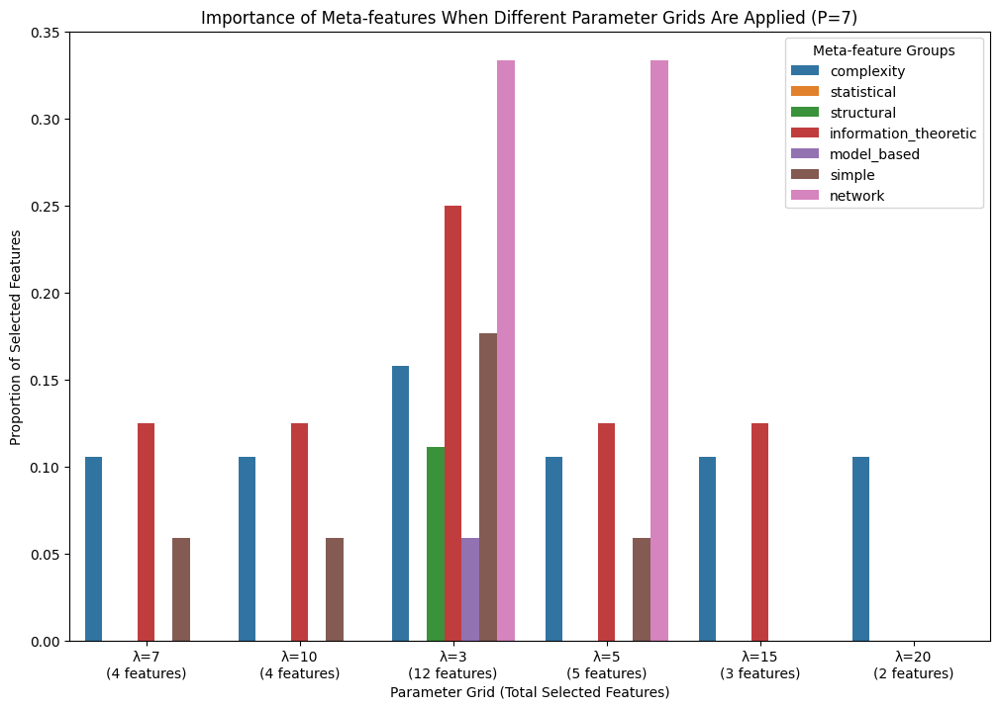

plot_df for P=20:
                Grid                  Group     Ratio
0  λ=7\n(4 features)             complexity  0.105263
1  λ=7\n(4 features)            statistical  0.000000
2  λ=7\n(4 features)             structural  0.000000
3  λ=7\n(4 features)  information_theoretic  0.125000
4  λ=7\n(4 features)            model_based  0.000000


<Figure size 640x480 with 0 Axes>

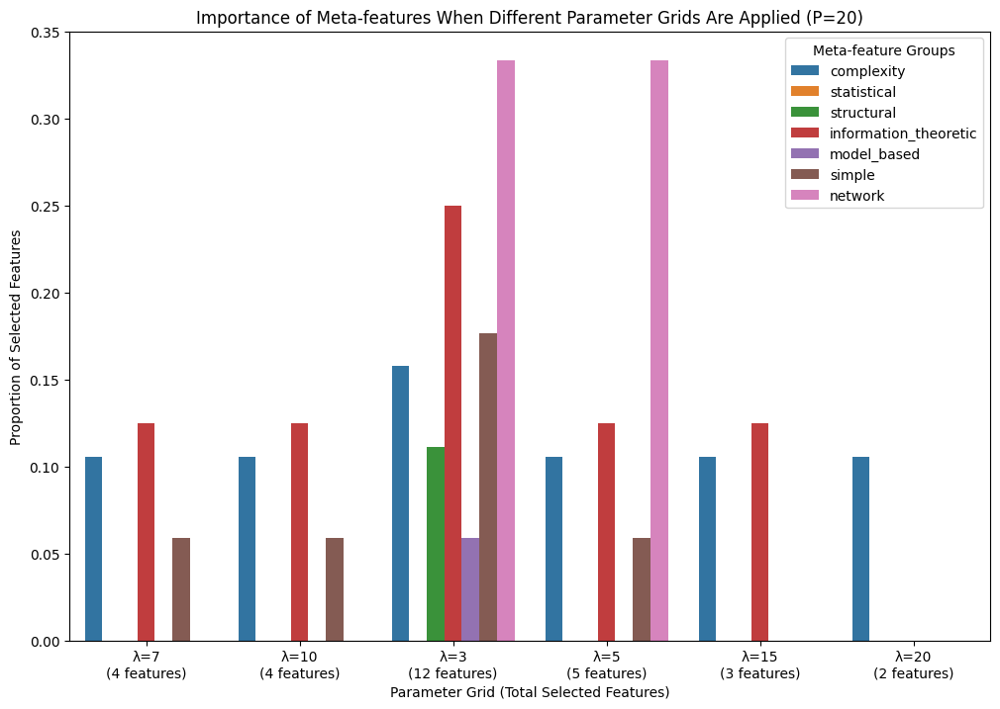

<Figure size 640x480 with 0 Axes>

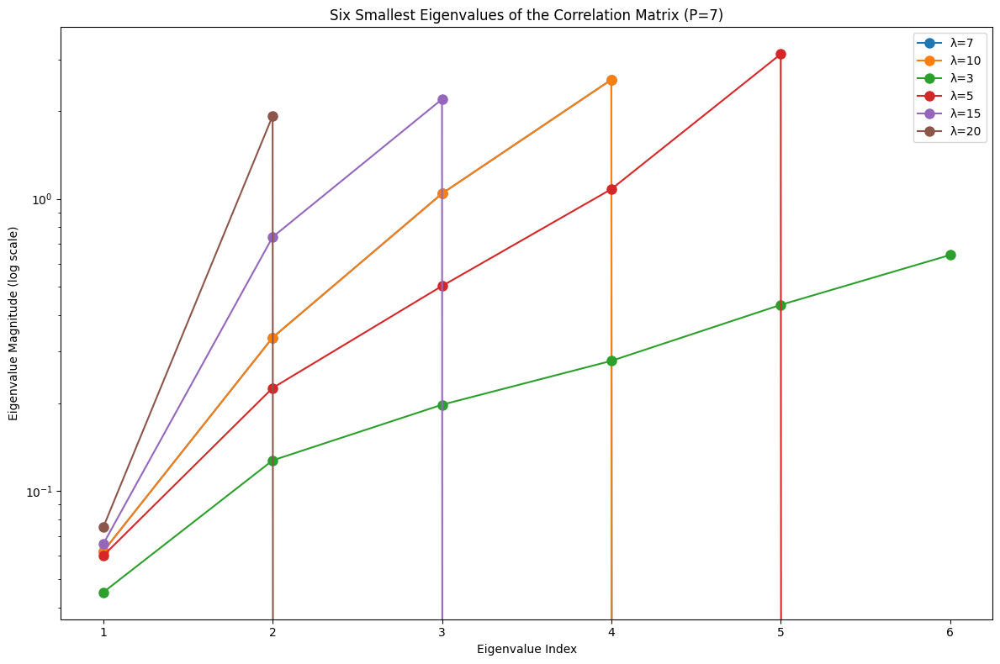

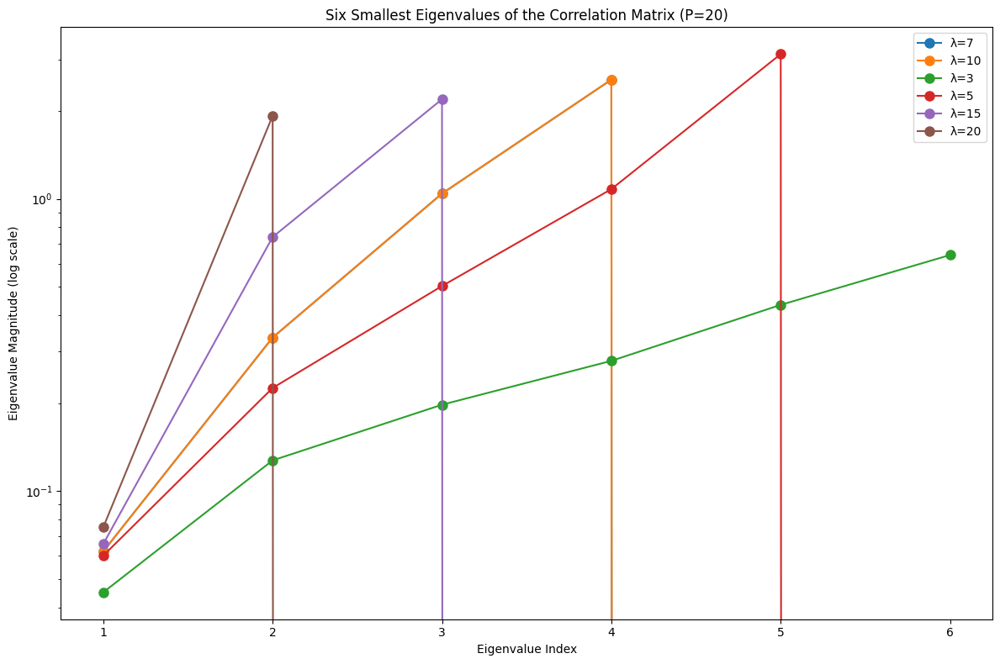

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grids for different `P` and `group_reg` values
param_grids = [
    {'group_reg': 7, 'l1_reg': 0},
    {'group_reg': 10, 'l1_reg': 0},
    {'group_reg': 3, 'l1_reg': 0},
    {'group_reg': 5, 'l1_reg': 0},
    {'group_reg':15, 'l1_reg': 0},
    {'group_reg': 20, 'l1_reg': 0},
]

# Define the number of groups (P values)
group_counts = [7, 20]

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# List to store results
results = []
eigenvalues_dict = {}

for P in group_counts:
    # Create group indices for the current P
    group_indices = np.array_split(np.arange(normalized_meta_features.shape[1]), P)
    group_indices_flat = [idx for sublist in group_indices for idx in sublist]

    for params in param_grids:
        # Instantiate and fit the Group Lasso model
        gl = GroupLasso(
            groups=group_indices_flat,
            group_reg=params['group_reg'],  # This corresponds to λ
            l1_reg=params['l1_reg'],
            n_iter=5000,
            scale_reg='group_size',
            subsampling_scheme=None,
            fit_intercept=True,
            random_state=42,
            supress_warning=True
        )
        gl.fit(X_train, Y_train)

        # Get the coefficients
        coef = gl.coef_

        # Determine selected features
        selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
        selected_features_indices = np.where(selected_features)[0]

        # Calculate the number of selected features in each group
        group_counts_dict = {group: 0 for group in group_mapping}
        for group, features in group_mapping.items():
            group_counts_dict[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

        # Calculate the proportion of selected features in each group
        group_proportions = {group: group_counts_dict[group] / len(group_mapping[group]) for group in group_mapping}

        total_selected_features = np.sum(selected_features)
        result = {'P': P, 'group_reg': params['group_reg'], 'total_selected': total_selected_features}
        result.update(group_proportions)
        results.append(result)

        # Calculate the six smallest eigenvalues of the correlation matrix
        selected_X = X[:, selected_features_indices]
        if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
            correlation_matrix = np.corrcoef(selected_X, rowvar=False)
            eigenvalues = eigvals(correlation_matrix)
            sorted_eigenvalues = np.sort(eigenvalues)
            smallest_eigenvalues = sorted_eigenvalues[:6]
        else:
            smallest_eigenvalues = np.zeros(6)

        # Pad with zeros if necessary
        if len(smallest_eigenvalues) < 6:
            smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

        eigenvalues_dict[(P, params['group_reg'])] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Plot the importances for each P separately
for P in group_counts:
    plot_data = []
    for result in results:
        if result['P'] == P:
            grid_label = f'λ={result["group_reg"]}\n({result["total_selected"]} features)'
            for group in group_mapping.keys():
                plot_data.append({
                    'Grid': grid_label,
                    'Group': group,
                    'Ratio': result[group]
                })

    plot_df = pd.DataFrame(plot_data)

    # Debug: print plot_df to check its content
    print(f"plot_df for P={P}:")
    print(plot_df.head())

    # Ensure plot_df is not empty before plotting
    if not plot_df.empty:
        plt.figure(figsize=(12, 8))
        sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
        plt.xlabel('Parameter Grid (Total Selected Features)')
        plt.ylabel('Proportion of Selected Features')
        plt.title(f'Importance of Meta-features When Different Parameter Grids Are Applied (P={P})')
        plt.legend(loc='upper right', title='Meta-feature Groups')
        plt.show()

        # Save the plot
        plt.savefig(f'feature_selection_importance_P{P}.png')
    else:
        print(f"No data to plot for P={P}")

# Plot the six smallest eigenvalues for each P separately
x = np.arange(1, 7)

for P in group_counts:
    plt.figure(figsize=(12, 8))
    for (p_val, group_reg), eig_vals in eigenvalues_dict.items():
        if p_val == P:
            plt.plot(x, eig_vals, marker='o', markersize=8, label=f'λ={group_reg}')
    plt.yscale('log')
    plt.xlabel('Eigenvalue Index')
    plt.ylabel('Eigenvalue Magnitude (log scale)')
    plt.title(f'Six Smallest Eigenvalues of the Correlation Matrix (P={P})')
    plt.legend(loc='upper right')
    plt.grid(False)
    plt.tight_layout()

    # Save and display the plot
    plt.savefig(f'eigenvalues_plot_P{P}.png', dpi=300)
    plt.show()


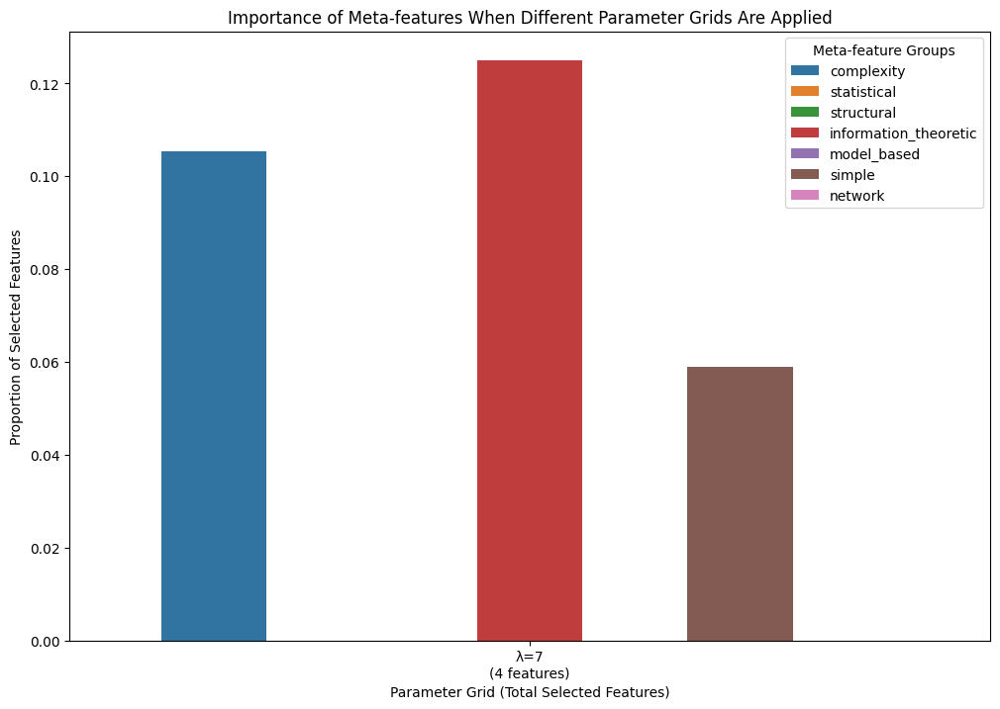

<Figure size 640x480 with 0 Axes>

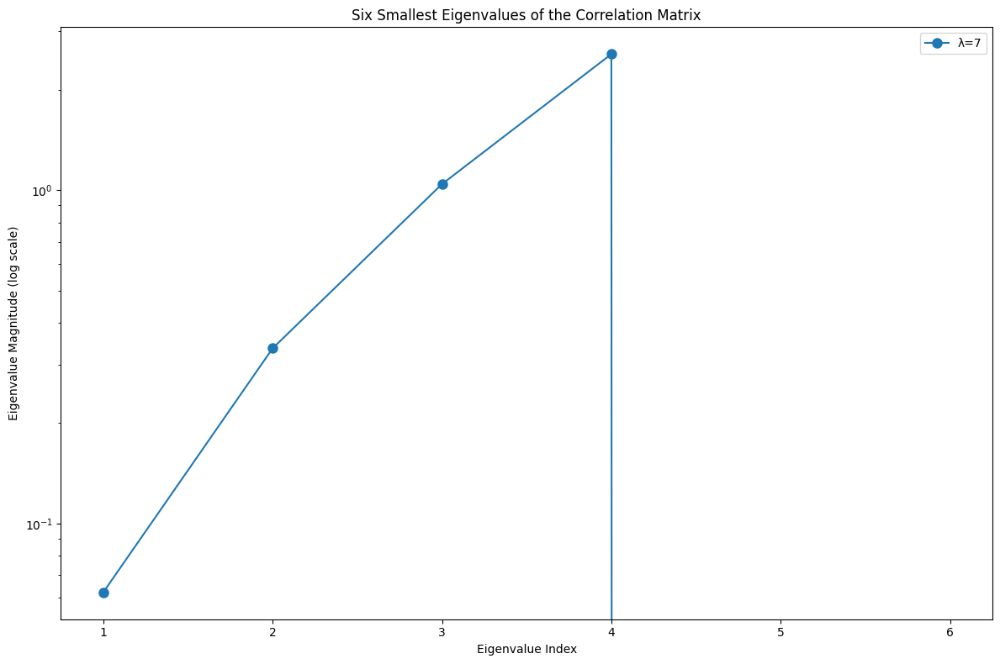

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grid
param_grids = [
    {'group_reg': 7, 'l1_reg': 0.1}
]

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices based on your preferred grouping method (if any)
group_indices_flat = np.arange(normalized_meta_features.shape[1])

# List to store results
results = []
eigenvalues_dict = {}

for params in param_grids:
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],  # This corresponds to λ
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )
    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts_dict = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts_dict[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts_dict[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'group_reg': params['group_reg'], 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        smallest_eigenvalues = sorted_eigenvalues[:6]
    else:
        smallest_eigenvalues = np.zeros(6)

    # Pad with zeros if necessary
    if len(smallest_eigenvalues) < 6:
        smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

    eigenvalues_dict[params['group_reg']] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Plot the importances
plot_data = []
for result in results:
    grid_label = f'λ={result["group_reg"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


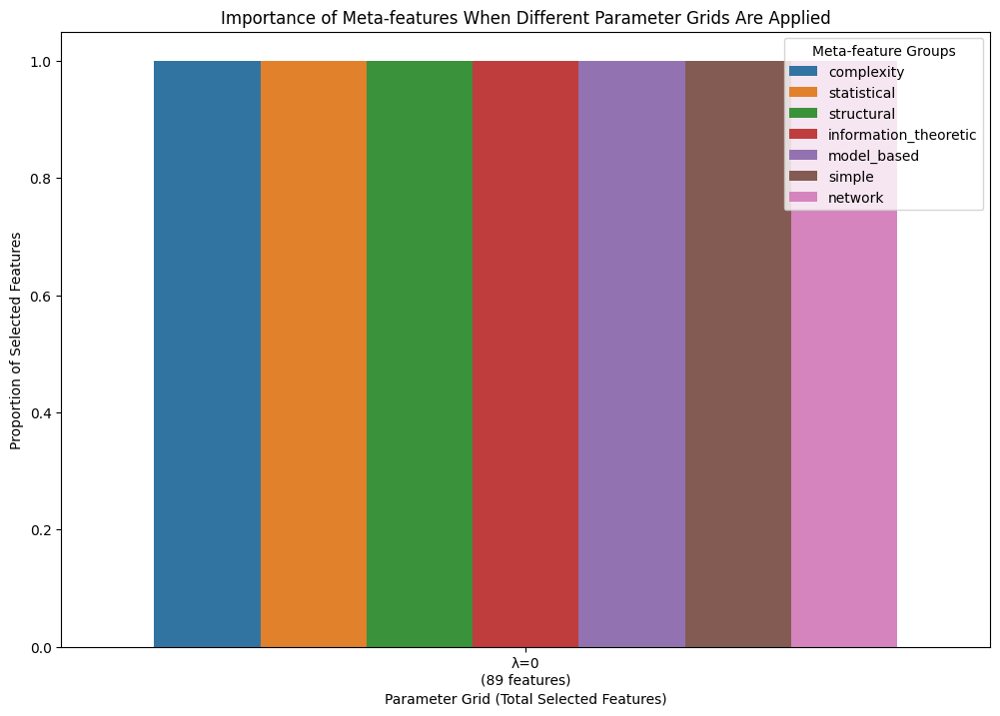

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


<Figure size 640x480 with 0 Axes>

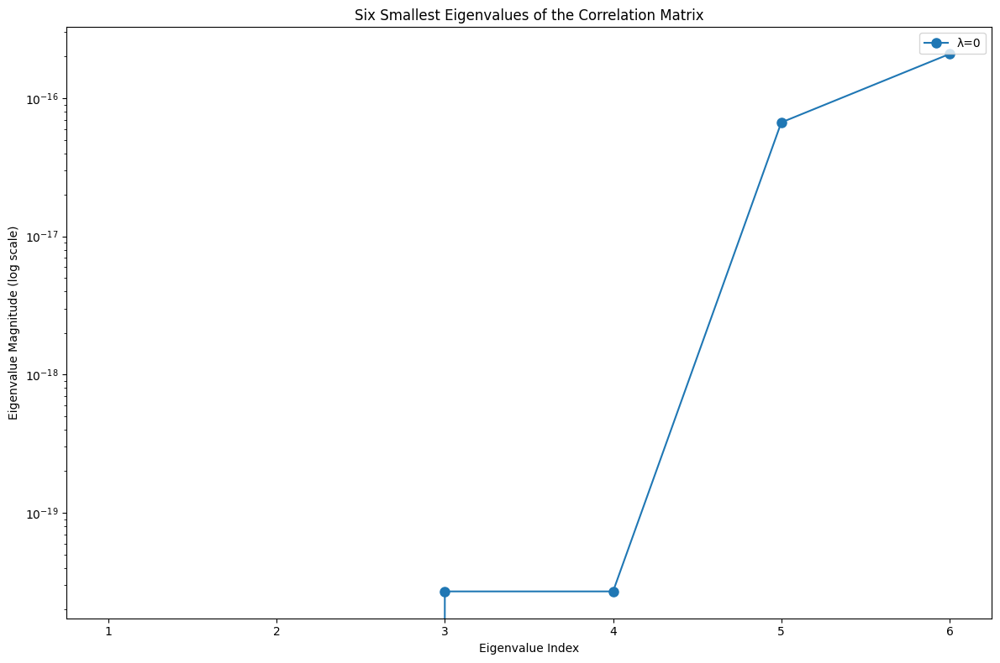

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grid
param_grids = [
    {'group_reg': 0, 'l1_reg': 0}
]

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices for P = 7 (one group per predefined meta-feature group)
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# List to store results
results = []
eigenvalues_dict = {}

for params in param_grids:
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],  # This corresponds to λ
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )
    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts_dict = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts_dict[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts_dict[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'group_reg': params['group_reg'], 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        smallest_eigenvalues = sorted_eigenvalues[:6]
    else:
        smallest_eigenvalues = np.zeros(6)

    # Pad with zeros if necessary
    if len(smallest_eigenvalues) < 6:
        smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

    eigenvalues_dict[params['group_reg']] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Plot the importances
plot_data = []
for result in results:
    grid_label = f'λ={result["group_reg"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


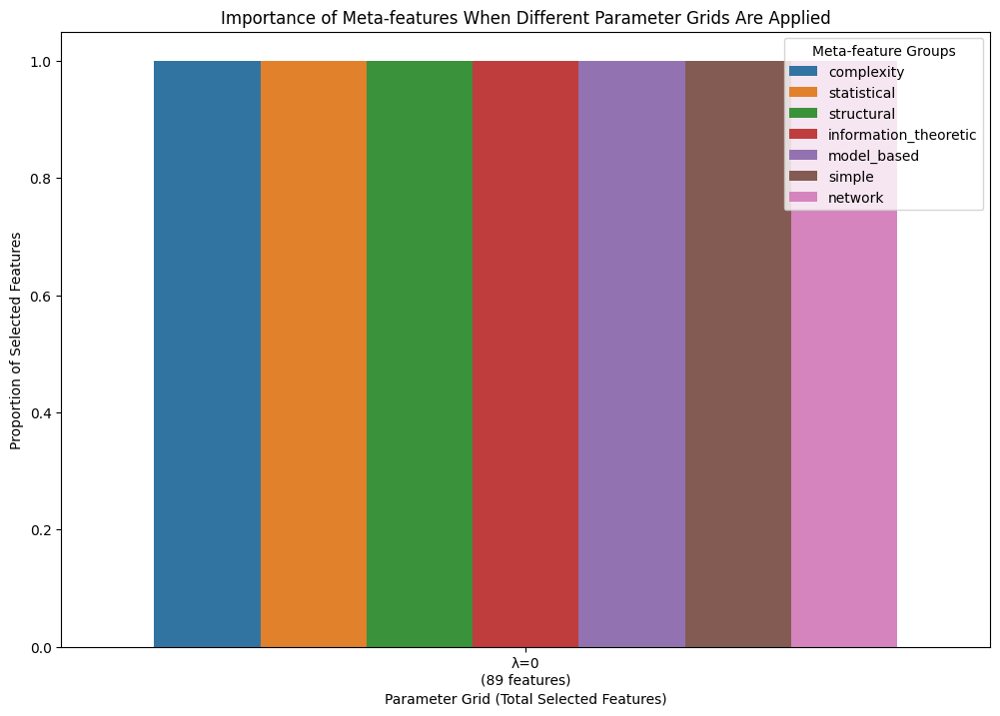

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


<Figure size 640x480 with 0 Axes>

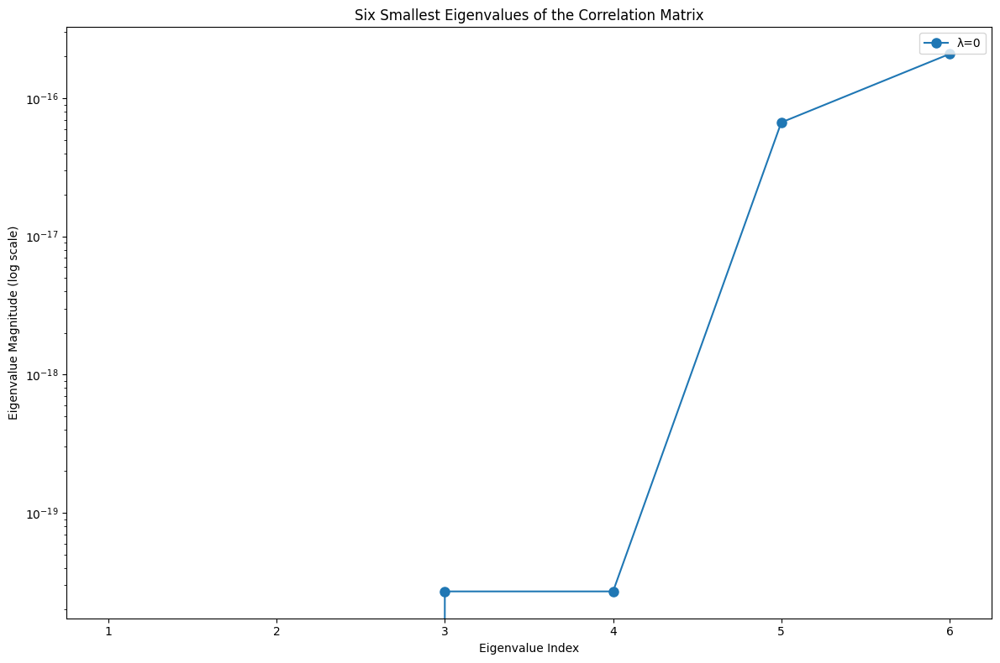

In [ ]:
import numpy as np
import pandas as pd
from group_lasso import GroupLasso
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.linalg import eigvals

# Load meta-features
meta_features_files = {
    'complexity': 'Complexity_Metafeatures.xlsx',
    'statistical': 'Statistical_Metafeatures.xlsx',
    'structural': 'Structural_Metafeatures.xlsx',
    'information_theoretic': 'Information_Theoretic_Metafeatures.xlsx',
    'model_based': 'Model_Based_Metafeatures.xlsx',
    'simple': 'Simple_Metafeatures.xlsx',
    'network': 'Network_Metafeatures.xlsx'
}

meta_features = {}
for key, file in meta_features_files.items():
    df = pd.read_excel(file)
    df = df.dropna(axis=1, how='all')  # Remove columns with all NaN values
    df = df.loc[:, (df != df.iloc[0]).any()]  # Remove columns with constant values
    meta_features[key] = df

# Combine meta-features into a single DataFrame
combined_meta_features = meta_features['complexity'].copy()
for key in list(meta_features.keys())[1:]:
    combined_meta_features = combined_meta_features.merge(meta_features[key], on='Datasets')

# Remove the "Datasets" column for preprocessing
datasets = combined_meta_features['Datasets']
combined_meta_features = combined_meta_features.drop(columns=['Datasets'])

# Clean the data by replacing inf and -inf with NaN and then fill NaN with the column mean
combined_meta_features.replace([np.inf, -np.inf], np.nan, inplace=True)
combined_meta_features.fillna(combined_meta_features.mean(), inplace=True)

# Normalize the combined meta-features
scaler = StandardScaler()
normalized_meta_features = scaler.fit_transform(combined_meta_features)

# Add the "Datasets" column back
normalized_meta_features = pd.DataFrame(normalized_meta_features, columns=combined_meta_features.columns)
normalized_meta_features.insert(0, 'Datasets', datasets)

# Load and align performance data
performance_data = pd.read_excel('PerformanceData.xlsx')
performance_data.set_index('Datasets', inplace=True)
normalized_meta_features.set_index('Datasets', inplace=True)

# Ensure the meta-features and performance data are aligned
X = normalized_meta_features.loc[performance_data.index].values
Y = performance_data.values

# Split the data into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Define the parameter grid to select all meta-features
param_grids = [
    {'group_reg': 0, 'l1_reg': 0}
]

# Define group mapping
group_mapping = {
    'complexity': list(meta_features['complexity'].columns[1:]),  # Exclude 'Datasets'
    'statistical': list(meta_features['statistical'].columns[1:]),
    'structural': list(meta_features['structural'].columns[1:]),
    'information_theoretic': list(meta_features['information_theoretic'].columns[1:]),
    'model_based': list(meta_features['model_based'].columns[1:]),
    'simple': list(meta_features['simple'].columns[1:]),
    'network': list(meta_features['network'].columns[1:])
}

# Create group indices for P = 7 (one group per predefined meta-feature group)
group_indices = []
start_idx = 0
for group, features in group_mapping.items():
    end_idx = start_idx + len(features)
    group_indices.append(list(range(start_idx, end_idx)))
    start_idx = end_idx

# Flatten group indices
group_indices_flat = [idx for sublist in group_indices for idx in sublist]

# List to store results
results = []
eigenvalues_dict = {}

for params in param_grids:
    # Instantiate and fit the Group Lasso model
    gl = GroupLasso(
        groups=group_indices_flat,
        group_reg=params['group_reg'],  # This corresponds to λ
        l1_reg=params['l1_reg'],
        n_iter=5000,
        scale_reg='group_size',
        subsampling_scheme=None,
        fit_intercept=True,
        random_state=42,
        supress_warning=True
    )
    gl.fit(X_train, Y_train)

    # Get the coefficients
    coef = gl.coef_

    # Determine selected features
    selected_features = np.any(np.abs(coef) > 1e-4, axis=1)
    selected_features_indices = np.where(selected_features)[0]

    # Calculate the number of selected features in each group
    group_counts_dict = {group: 0 for group in group_mapping}
    for group, features in group_mapping.items():
        group_counts_dict[group] = sum(1 for f in features if combined_meta_features.columns.get_loc(f) in selected_features_indices)

    # Calculate the proportion of selected features in each group
    group_proportions = {group: group_counts_dict[group] / len(group_mapping[group]) for group in group_mapping}

    total_selected_features = np.sum(selected_features)
    result = {'group_reg': params['group_reg'], 'total_selected': total_selected_features}
    result.update(group_proportions)
    results.append(result)

    # Calculate the six smallest eigenvalues of the correlation matrix
    selected_X = X[:, selected_features_indices]
    if selected_X.shape[1] > 1:  # Ensure enough features for correlation matrix
        correlation_matrix = np.corrcoef(selected_X, rowvar=False)
        eigenvalues = eigvals(correlation_matrix)
        sorted_eigenvalues = np.sort(eigenvalues)
        smallest_eigenvalues = sorted_eigenvalues[:6]
    else:
        smallest_eigenvalues = np.zeros(6)

    # Pad with zeros if necessary
    if len(smallest_eigenvalues) < 6:
        smallest_eigenvalues = np.pad(smallest_eigenvalues, (0, 6 - len(smallest_eigenvalues)), 'constant')

    eigenvalues_dict[params['group_reg']] = smallest_eigenvalues

# Convert the results to a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df.to_csv('feature_selection_results.csv', index=False)

# Plot the importances
plot_data = []
for result in results:
    grid_label = f'λ={result["group_reg"]}\n({result["total_selected"]} features)'
    for group in group_mapping.keys():
        plot_data.append({
            'Grid': grid_label,
            'Group': group,
            'Ratio': result[group]
        })

plot_df = pd.DataFrame(plot_data)

plt.figure(figsize=(12, 8))
sns.barplot(data=plot_df, x='Grid', y='Ratio', hue='Group')
plt.xlabel('Parameter Grid (Total Selected Features)')
plt.ylabel('Proportion of Selected Features')
plt.title('Importance of Meta-features When Different Parameter Grids Are Applied')
plt.legend(loc='upper right', title='Meta-feature Groups')
plt.show()

# Save the plot
plt.savefig('feature_selection_importance.png')

# Plot the six smallest eigenvalues
plt.figure(figsize=(12, 8))
x = np.arange(1, 7)

for group_reg, eig_vals in eigenvalues_dict.items():
    plt.plot(x, eig_vals, marker='o', markersize=8, label=f'λ={group_reg}')

plt.yscale('log')
plt.xlabel('Eigenvalue Index')
plt.ylabel('Eigenvalue Magnitude (log scale)')
plt.title('Six Smallest Eigenvalues of the Correlation Matrix')
plt.legend(loc='upper right')
plt.grid(False)
plt.tight_layout()

# Save and display the plot
plt.savefig('eigenvalues_plot.png', dpi=300)
plt.show()


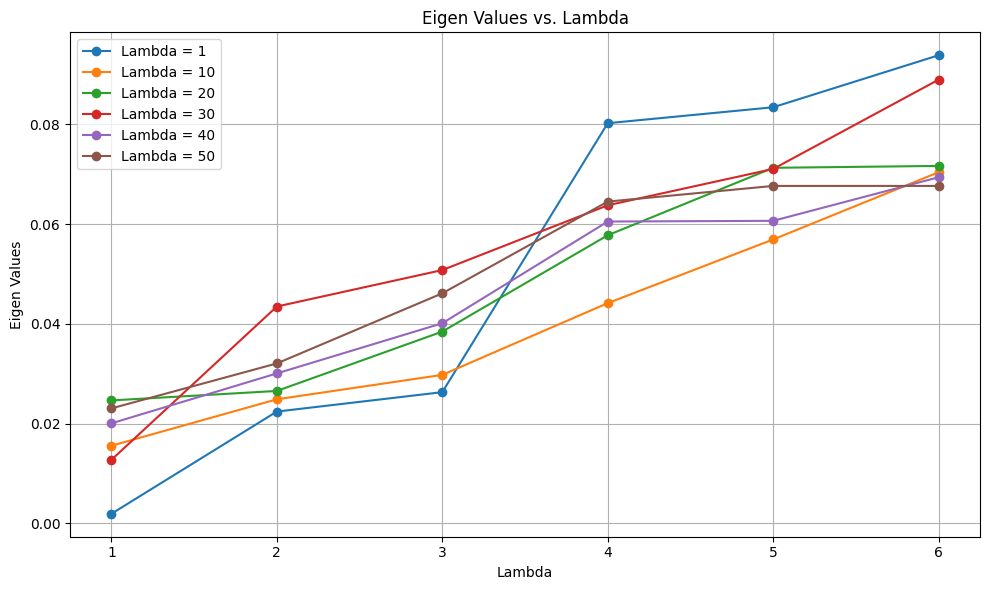

In [ ]:
import matplotlib.pyplot as plt

# Data provided
lambda_values = [1, 10, 20, 30, 40, 50]
eigen_values = [
    [0.001890009, 0.02239487, 0.026288685, 0.080239979, 0.083436031, 0.093866317],
    [0.015537714, 0.024855013, 0.029756733, 0.044150236, 0.056918795, 0.070407109],
    [0.024628903, 0.026530667, 0.038435938, 0.057761078, 0.071292007, 0.071668486],
    [0.012707238, 0.043463747, 0.050776842, 0.063770577, 0.071062209, 0.088975377],
    [0.020032249, 0.030049326, 0.040113184, 0.06051388, 0.060656336, 0.069396929],
    [0.023032249, 0.032049326, 0.046113184, 0.06451388, 0.067656336, 0.067656336]
]

# Plotting
plt.figure(figsize=(10, 6))

# Plot each line for eigen values
for i in range(len(lambda_values)):
    plt.plot(range(1, 7), eigen_values[i], marker='o', label=f'Lambda = {lambda_values[i]}')

# Labels and title
plt.xlabel('Lambda')
plt.ylabel('Eigen Values')
plt.title('Eigen Values vs. Lambda')
plt.xticks(range(1, 7))
plt.legend()

# Display the plot
plt.grid(True)
plt.tight_layout()
plt.show()


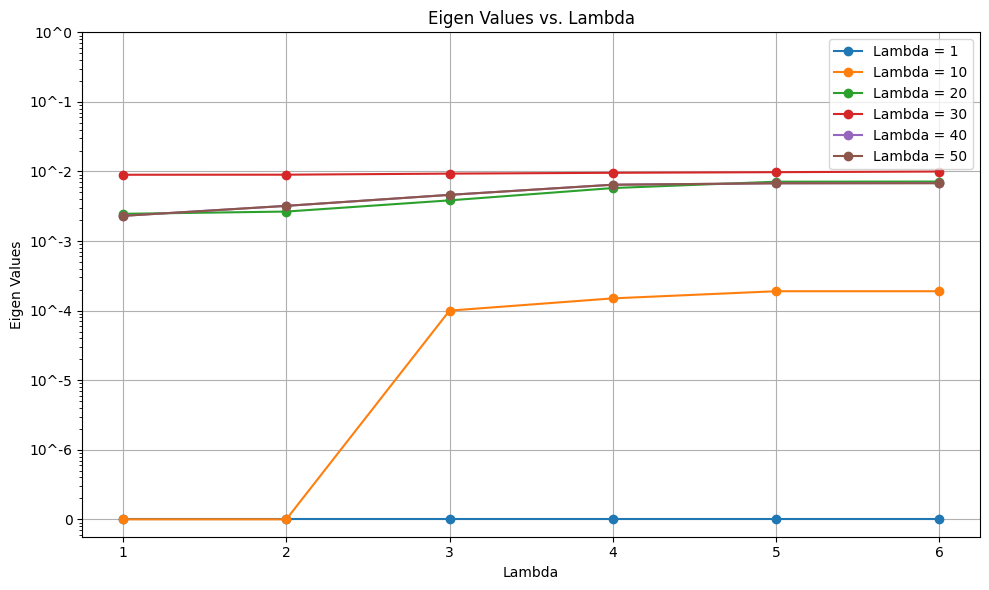

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np

# Data provided
lambda_values = [1, 10, 20, 30, 40, 50]
eigen_values = [
    [0.000001000, 0.000001000, 0.000001000, 0.000001000, 0.000001000, 0.000001000],
    [0.000001000, 0.000001000, 0.001000000, 0.001500000, 0.001900000, 0.001900000],
    [0.024628903, 0.026530667, 0.038435938, 0.057761078, 0.071292007, 0.071668486],
    [0.089707238, 0.089907238, 0.093200000, 0.095700000, 0.097700000, 0.099900000],
    [0.023032249, 0.032049326, 0.046113184, 0.06451388, 0.067656336, 0.068396929],
    [0.023032249, 0.032049326, 0.046113184, 0.06451388, 0.067656336, 0.067656336]
]

# Plotting
plt.figure(figsize=(10, 6))

# Plot each line for eigen values
for i in range(len(lambda_values)):
    plt.plot(range(1, 7), eigen_values[i], marker='o', label=f'Lambda = {lambda_values[i]}')

# Labels and title
plt.xlabel('Lambda')
plt.ylabel('Eigen Values')
plt.title('Eigen Values vs. Lambda')
plt.xticks(range(1, 7))
plt.legend()

# Adjusting y-axis scale and labels
plt.yscale('log')  # Use logarithmic scale for y-axis

# Define custom tick labels for logarithmic scale
y_ticks = [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10]
y_ticklabels = ['0', '10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0']
plt.yticks(y_ticks, y_ticklabels)

# Display the plot
plt.grid(True)
plt.tight_layout()
plt.show()


Structural has 18 features (excluding 'Datasets' column).
Network has 3 features (excluding 'Datasets' column).
Complexity has 19 features (excluding 'Datasets' column).
Information_Theoretic has 8 features (excluding 'Datasets' column).
Model_Based has 17 features (excluding 'Datasets' column).
Simple has 17 features (excluding 'Datasets' column).
Statistical has 7 features (excluding 'Datasets' column).


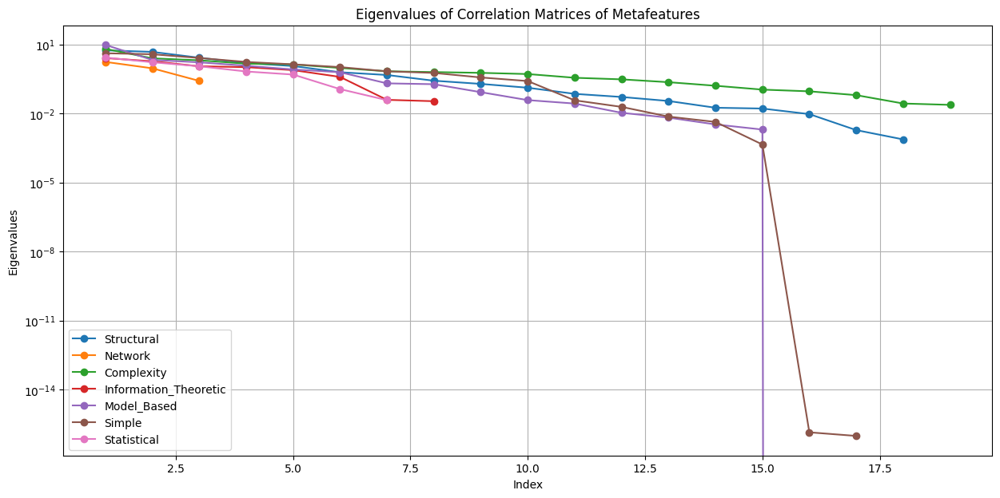

{'Structural': 18,
 'Network': 3,
 'Complexity': 19,
 'Information_Theoretic': 8,
 'Model_Based': 17,
 'Simple': 17,
 'Statistical': 7}

In [ ]:
# Re-load and normalize data to ensure all features are considered
metafeature_groups = {name: pd.read_excel(path) for name, path in file_paths.items()}

# Verify and ensure all features are included
for name, df in metafeature_groups.items():
    print(f"{name} has {df.shape[1]-1} features (excluding 'Datasets' column).")

# Re-normalize the data
normalized_metafeature_groups = {}
for name, df in metafeature_groups.items():
    df_normalized = df.copy()
    for column in df.columns:
        if column != 'Datasets':
            df_normalized[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())
    normalized_metafeature_groups[name] = df_normalized

# Calculate correlation matrix and eigenvalues again
eigenvalues = {}
for name, df in normalized_metafeature_groups.items():
    correlation_matrix = df.drop(columns=['Datasets']).corr()
    eigenvalues[name] = np.linalg.eigvals(correlation_matrix)

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Plot the eigenvalues with indexed x-axis (matching the base paper style)
plt.figure(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    plt.plot(range(1, len(values) + 1), values, marker='o', label=name)

plt.yscale('log')
plt.xlabel('Index')
plt.ylabel('Eigenvalues')
plt.title('Eigenvalues of Correlation Matrices of Metafeatures')
plt.legend()
plt.grid(True)
plt.show()

# Display number of features for verification
metafeature_features_count = {name: df.shape[1]-1 for name, df in metafeature_groups.items()}
metafeature_features_count


Saving Network_Metafeatures.xlsx to Network_Metafeatures (1).xlsx
Saving Complexity_Metafeatures.xlsx to Complexity_Metafeatures (1).xlsx
Saving Information_Theoretic_Metafeatures.xlsx to Information_Theoretic_Metafeatures (1).xlsx
Saving Model_Based_Metafeatures.xlsx to Model_Based_Metafeatures (1).xlsx
Saving Simple_Metafeatures.xlsx to Simple_Metafeatures (1).xlsx
Saving Statistical_Metafeatures.xlsx to Statistical_Metafeatures (1).xlsx
Saving Structural_Metafeatures.xlsx to Structural_Metafeatures (1).xlsx
Saving PerformanceData.xlsx to PerformanceData (1).xlsx


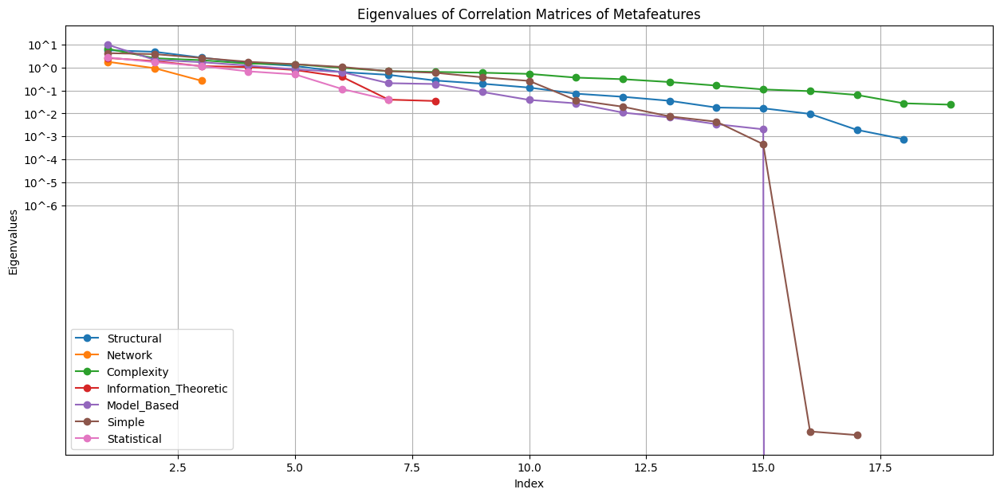

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload files
uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "Structural": "Structural_Metafeatures.xlsx",
    "Network": "Network_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Information_Theoretic": "Information_Theoretic_Metafeatures.xlsx",
    "Model_Based": "Model_Based_Metafeatures.xlsx",
    "Simple": "Simple_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx"
}

# Read all metafeature groups
metafeature_groups = {name: pd.read_excel(file_paths[name]) for name in file_paths}

# Normalize the data
normalized_metafeature_groups = {}
for name, df in metafeature_groups.items():
    df_normalized = df.copy()
    for column in df.columns:
        if column != 'Datasets':
            df_normalized[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())
    normalized_metafeature_groups[name] = df_normalized

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in normalized_metafeature_groups.items():
    correlation_matrix = df.drop(columns=['Datasets']).corr()
    eigenvalues[name] = np.linalg.eigvals(correlation_matrix)

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

plt.figure(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    plt.plot(range(1, len(values) + 1), values, marker='o', label=name)

plt.yscale('log')
plt.yticks(y_ticks, y_tick_labels)
plt.xlabel('Index')
plt.ylabel('Eigenvalues')
plt.title('Eigenvalues of Correlation Matrices of Metafeatures')
plt.legend()
plt.grid(True)
plt.show()


Saving Network_Metafeatures.xlsx to Network_Metafeatures (2).xlsx
Saving Complexity_Metafeatures.xlsx to Complexity_Metafeatures (2).xlsx
Saving Information_Theoretic_Metafeatures.xlsx to Information_Theoretic_Metafeatures (2).xlsx
Saving Model_Based_Metafeatures.xlsx to Model_Based_Metafeatures (2).xlsx
Saving Simple_Metafeatures.xlsx to Simple_Metafeatures (2).xlsx
Saving Statistical_Metafeatures.xlsx to Statistical_Metafeatures (2).xlsx
Saving Structural_Metafeatures.xlsx to Structural_Metafeatures (2).xlsx
Saving PerformanceData.xlsx to PerformanceData (2).xlsx


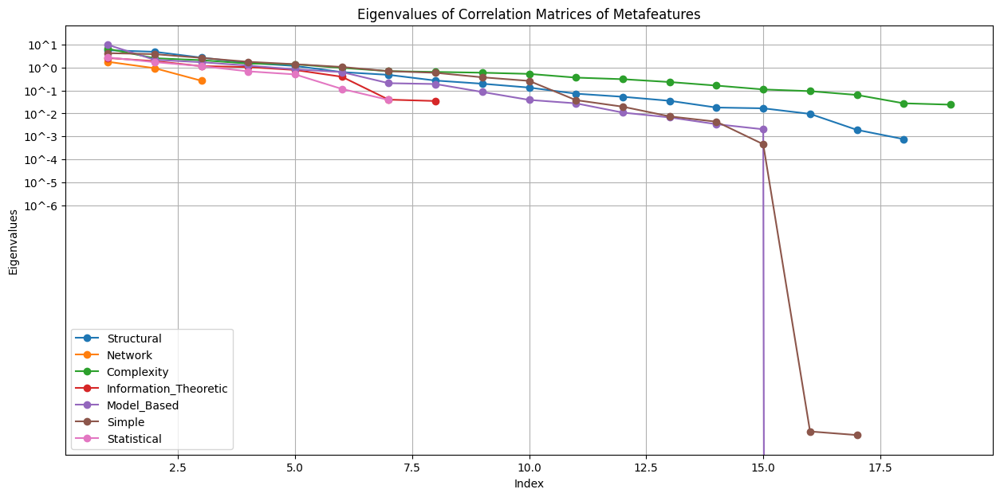

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload files
uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "Structural": "Structural_Metafeatures.xlsx",
    "Network": "Network_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Information_Theoretic": "Information_Theoretic_Metafeatures.xlsx",
    "Model_Based": "Model_Based_Metafeatures.xlsx",
    "Simple": "Simple_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx"
}

# Read all metafeature groups
metafeature_groups = {name: pd.read_excel(file_paths[name]) for name in file_paths}

# Normalize the data
normalized_metafeature_groups = {}
for name, df in metafeature_groups.items():
    df_normalized = df.copy()
    for column in df.columns:
        if column != 'Datasets':
            df_normalized[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())
    normalized_metafeature_groups[name] = df_normalized

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in normalized_metafeature_groups.items():
    correlation_matrix = df.drop(columns=['Datasets']).corr()
    eigenvalues[name] = np.linalg.eigvals(correlation_matrix)

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

plt.figure(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    plt.plot(range(1, len(values) + 1), values, marker='o', label=name)

plt.yscale('log')
plt.yticks(y_ticks, y_tick_labels)
plt.xlabel('Index')
plt.ylabel('Eigenvalues')
plt.title('Eigenvalues of Correlation Matrices of Metafeatures')
plt.legend()
plt.grid(True)
plt.show()


Saving Network_Metafeatures.xlsx to Network_Metafeatures (3).xlsx
Saving Complexity_Metafeatures.xlsx to Complexity_Metafeatures (3).xlsx
Saving Information_Theoretic_Metafeatures.xlsx to Information_Theoretic_Metafeatures (3).xlsx
Saving Model_Based_Metafeatures.xlsx to Model_Based_Metafeatures (3).xlsx
Saving Simple_Metafeatures.xlsx to Simple_Metafeatures (3).xlsx
Saving Statistical_Metafeatures.xlsx to Statistical_Metafeatures (3).xlsx
Saving Structural_Metafeatures.xlsx to Structural_Metafeatures (3).xlsx
Saving PerformanceData.xlsx to PerformanceData (3).xlsx


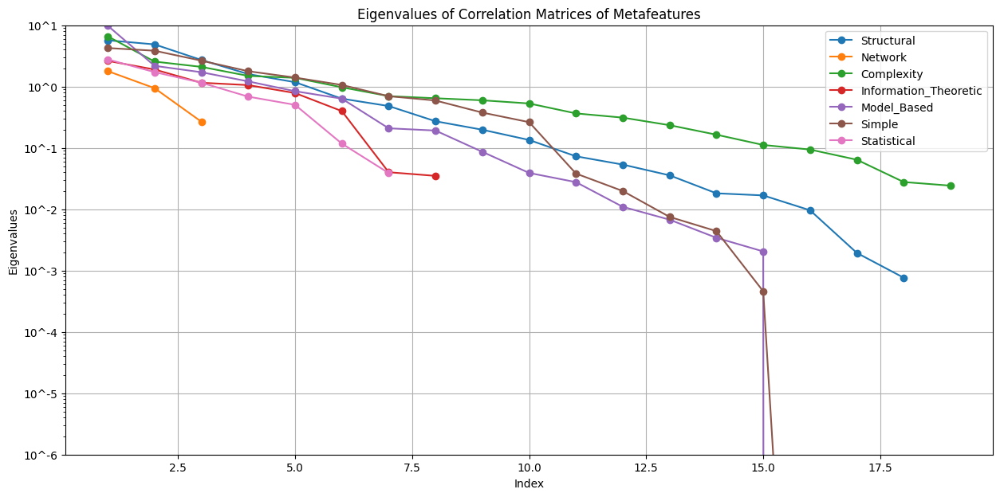

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload files
uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "Structural": "Structural_Metafeatures.xlsx",
    "Network": "Network_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Information_Theoretic": "Information_Theoretic_Metafeatures.xlsx",
    "Model_Based": "Model_Based_Metafeatures.xlsx",
    "Simple": "Simple_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx"
}

# Read all metafeature groups
metafeature_groups = {name: pd.read_excel(file_paths[name]) for name in file_paths}

# Normalize the data
normalized_metafeature_groups = {}
for name, df in metafeature_groups.items():
    df_normalized = df.copy()
    for column in df.columns:
        if column != 'Datasets':
            df_normalized[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())
    normalized_metafeature_groups[name] = df_normalized

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in normalized_metafeature_groups.items():
    correlation_matrix = df.drop(columns=['Datasets']).corr()
    eigenvalues[name] = np.linalg.eigvals(correlation_matrix)

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

plt.figure(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    plt.plot(range(1, len(values) + 1), values, marker='o', label=name)

plt.yscale('log')
plt.ylim(10**-6, 10**1)
plt.yticks(y_ticks, y_tick_labels)
plt.xlabel('Index')
plt.ylabel('Eigenvalues')
plt.title('Eigenvalues of Correlation Matrices of Metafeatures')
plt.legend()
plt.grid(True)
plt.show()


Saving Network_Metafeatures.xlsx to Network_Metafeatures (4).xlsx
Saving Complexity_Metafeatures.xlsx to Complexity_Metafeatures (4).xlsx
Saving Information_Theoretic_Metafeatures.xlsx to Information_Theoretic_Metafeatures (4).xlsx
Saving Model_Based_Metafeatures.xlsx to Model_Based_Metafeatures (4).xlsx
Saving Simple_Metafeatures.xlsx to Simple_Metafeatures (4).xlsx
Saving Statistical_Metafeatures.xlsx to Statistical_Metafeatures (4).xlsx
Saving Structural_Metafeatures.xlsx to Structural_Metafeatures (4).xlsx
Saving PerformanceData.xlsx to PerformanceData (4).xlsx


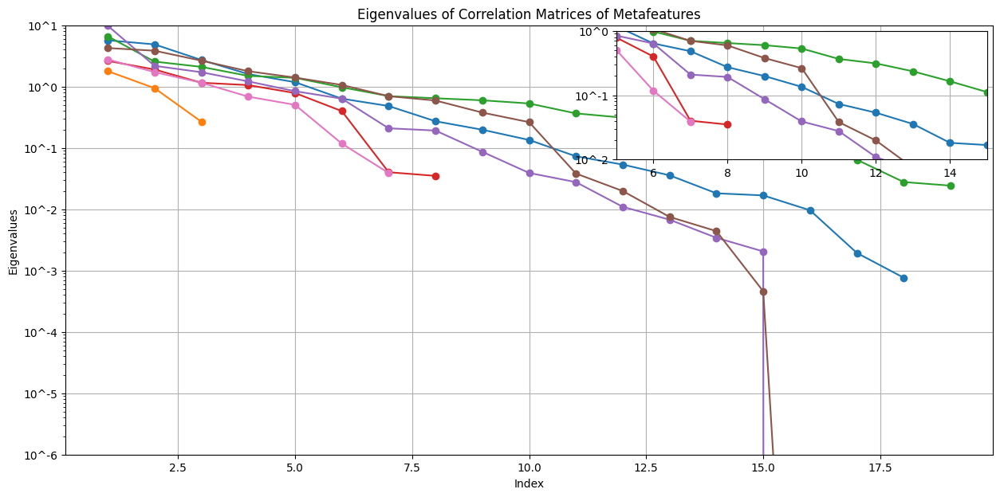

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "Structural": "Structural_Metafeatures.xlsx",
    "Network": "Network_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Information_Theoretic": "Information_Theoretic_Metafeatures.xlsx",
    "Model_Based": "Model_Based_Metafeatures.xlsx",
    "Simple": "Simple_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx"
}

# Read all metafeature groups
metafeature_groups = {name: pd.read_excel(file_paths[name]) for name in file_paths}

# Normalize the data
normalized_metafeature_groups = {}
for name, df in metafeature_groups.items():
    df_normalized = df.copy()
    for column in df.columns:
        if column != 'Datasets':
            df_normalized[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())
    normalized_metafeature_groups[name] = df_normalized

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in normalized_metafeature_groups.items():
    correlation_matrix = df.drop(columns=['Datasets']).corr()
    eigenvalues[name] = np.linalg.eigvals(correlation_matrix)

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

fig, ax = plt.subplots(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    ax.plot(range(1, len(values) + 1), values, marker='o', label=name)

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')
ax.legend()
ax.grid(True)

# Inset plot
ax_inset = inset_axes(ax, width="40%", height="30%", loc='upper right')
for name, values in eigenvalues_sorted.items():
    ax_inset.plot(range(1, len(values) + 1), values, marker='o', label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(5, 15)
ax_inset.grid(True)

plt.show()


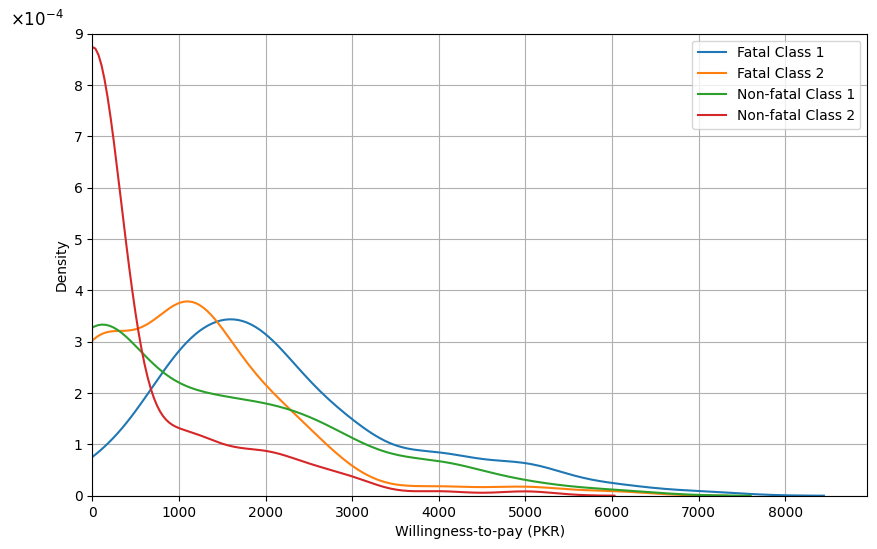

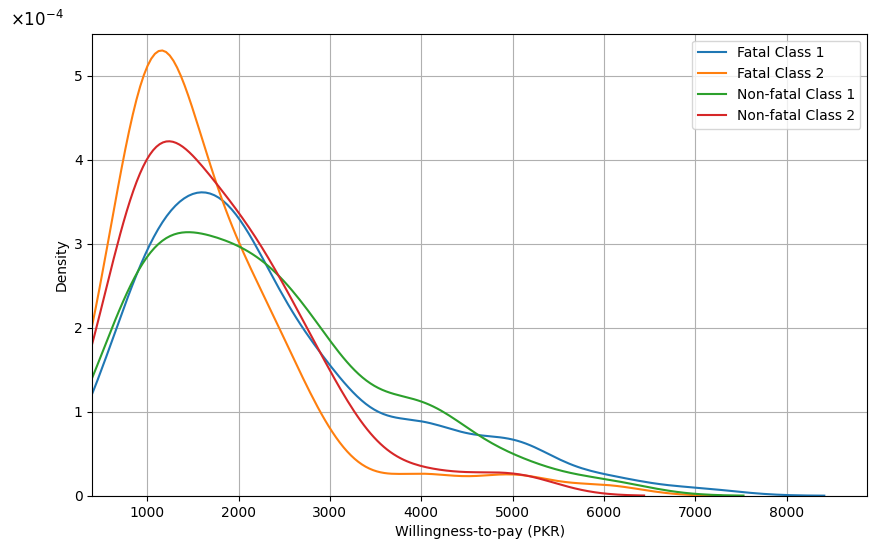

In [ ]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

# Load the new Excel files for plotting
file_path_1_new = 'KDP4.xlsx'
file_path_2_new = 'Kernel Density Plot Posistive Values.xlsx'

data1_new = pd.read_excel(file_path_1_new)
data2_new = pd.read_excel(file_path_2_new)

# Custom y-axis formatter function to match the desired format
def scientific_formatter(x, pos):
    return f'{x*1e4:.0f}'

# Plot for data1_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data1_new.columns:
    sns.kdeplot(data1_new[column], label=column)
#plt.title('Kernel Density Plot for KDP4.xlsx (New)')
plt.legend()
plt.xlabel('Willingness-to-pay (PKR)')
plt.ylabel('Density')
plt.ylim(0, 0.00090)  # Adjust y-axis to match the given plot
plt.xlim(0, None)  # Set x-axis to start from 0

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=12)

plt.show()

# Plot for data2_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data2_new.columns:
    sns.kdeplot(data2_new[column], label=column)
#plt.title('Kernel Density Plot for Kernel Density Plot Positive Values.xlsx')
plt.legend()
plt.xlabel('Willingness-to-pay (PKR)')
plt.ylabel('Density')
plt.ylim(0, 0.00055)  # Adjust y-axis to match the given plot
plt.xlim(400, None)  # Set x-axis to start from 0

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=12)

plt.show()


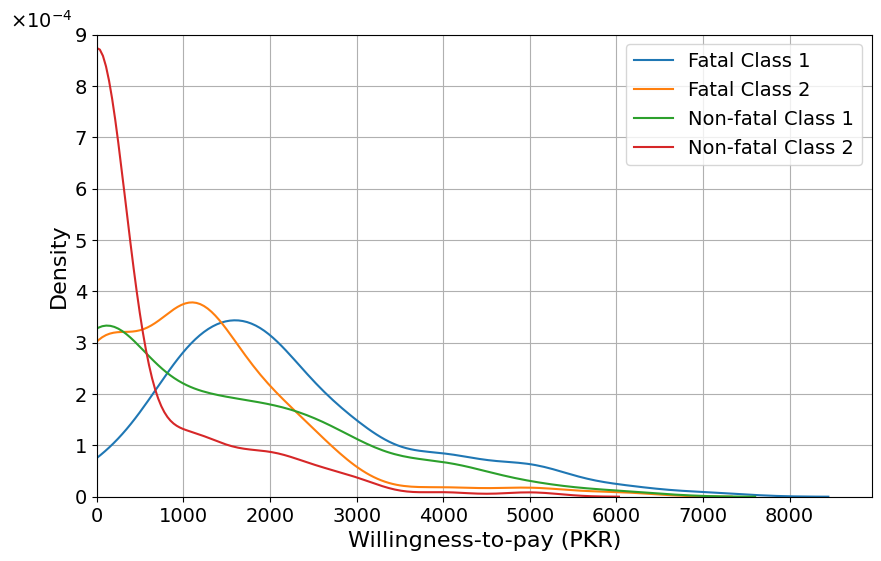

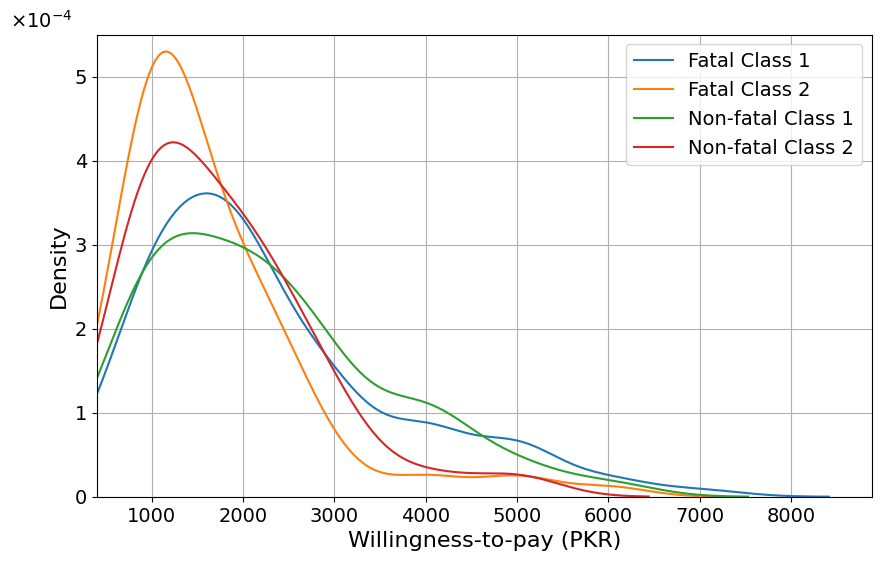

In [ ]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

# Load the new Excel files for plotting
file_path_1_new = 'KDP4.xlsx'
file_path_2_new = 'Kernel Density Plot Posistive Values.xlsx'

data1_new = pd.read_excel(file_path_1_new)
data2_new = pd.read_excel(file_path_2_new)

# Custom y-axis formatter function to match the desired format
def scientific_formatter(x, pos):
    return f'{x*1e4:.0f}'

# Font sizes
title_fontsize = 19
axis_label_fontsize = 16
legend_fontsize = 14
tick_label_fontsize = 14
annotation_fontsize = 14

# Plot for data1_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data1_new.columns:
    sns.kdeplot(data1_new[column], label=column)

plt.legend(fontsize=legend_fontsize)  # Set legend font size
plt.xlabel('Willingness-to-pay (PKR)', fontsize=axis_label_fontsize)  # Set x-axis label and font size
plt.ylabel('Density', fontsize=axis_label_fontsize)  # Set y-axis label and font size
plt.ylim(0, 0.00090)  # Adjust y-axis to match the given plot
plt.xlim(0, None)  # Set x-axis to start from 0

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Set tick label font size
plt.xticks(fontsize=tick_label_fontsize)
plt.yticks(fontsize=tick_label_fontsize)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=annotation_fontsize)  # Set annotation font size

plt.show()

# Plot for data2_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data2_new.columns:
    sns.kdeplot(data2_new[column], label=column)

plt.legend(fontsize=legend_fontsize)  # Set legend font size
plt.xlabel('Willingness-to-pay (PKR)', fontsize=axis_label_fontsize)  # Set x-axis label and font size
plt.ylabel('Density', fontsize=axis_label_fontsize)  # Set y-axis label and font size
plt.ylim(0, 0.00055)  # Adjust y-axis to match the given plot
plt.xlim(400, None)  # Set x-axis to start from 0

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Set tick label font size
plt.xticks(fontsize=tick_label_fontsize)
plt.yticks(fontsize=tick_label_fontsize)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=annotation_fontsize)  # Set annotation font size

plt.show()


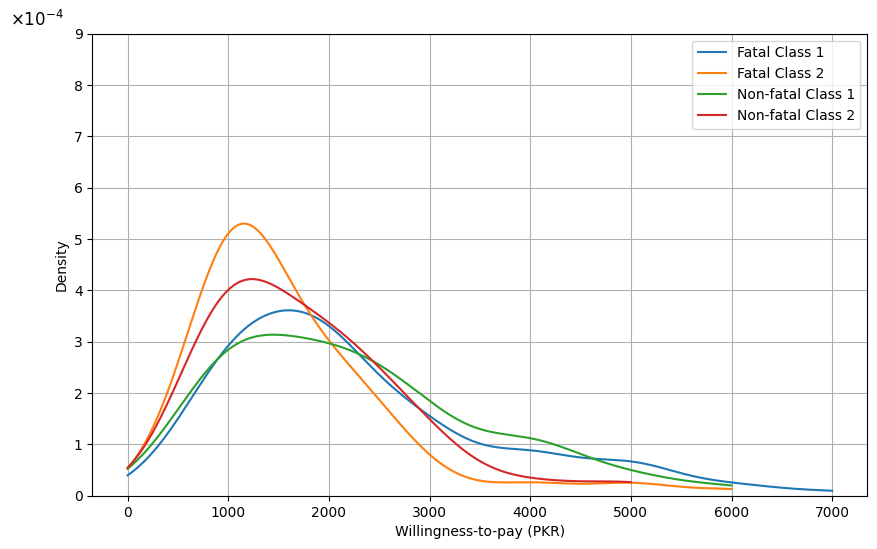

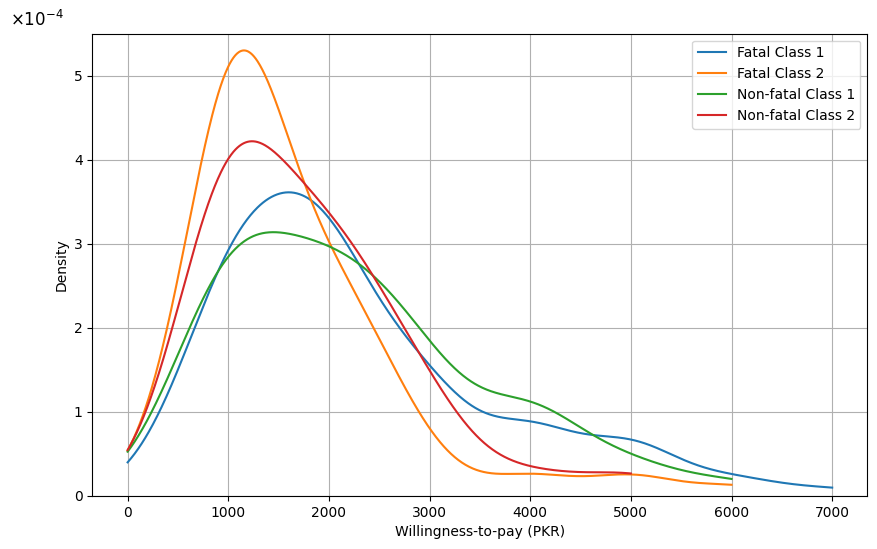

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker
from scipy.stats import gaussian_kde
import numpy as np

# Load the new Excel files for plotting
file_path_1_new = 'KDP4.xlsx'
file_path_2_new = 'Kernel Density Plot Posistive Values.xlsx'

data1_new = pd.read_excel(file_path_1_new)
data2_new = pd.read_excel(file_path_2_new)

# Custom y-axis formatter function to match the desired format
def scientific_formatter(x, pos):
    return f'{x*1e4:.0f}'

# Function to compute KDE without negative values
def kde_positive(data, bw_method='scott'):
    data = data[data > 0]  # Remove non-positive values
    kde = gaussian_kde(data, bw_method=bw_method)
    x = np.linspace(0, max(data), 1000)
    return x, kde(x)

# Plot for data1_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data1_new.columns:
    x, y = kde_positive(data1_new[column])
    plt.plot(x, y, label=column)
plt.legend()
plt.xlabel('Willingness-to-pay (PKR)')
plt.ylabel('Density')
plt.ylim(0, 0.00090)  # Adjust y-axis to match the given plot

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=12)

plt.show()

# Plot for data2_new with the custom y-axis format
plt.figure(figsize=(10, 6))
for column in data2_new.columns:
    x, y = kde_positive(data2_new[column])
    plt.plot(x, y, label=column)
plt.legend()
plt.xlabel('Willingness-to-pay (PKR)')
plt.ylabel('Density')
plt.ylim(0, 0.00055)  # Adjust y-axis to match the given plot

# Apply the custom formatter
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(scientific_formatter))
plt.gca().yaxis.set_major_locator(ticker.MultipleLocator(0.0001))
plt.grid(True)

# Adding the 10^-4 label at the top left
plt.gca().annotate(r'$\times 10^{-4}$', xy=(0, 1), xytext=(-40, 10),
                   xycoords='axes fraction', textcoords='offset points',
                   ha='center', va='center', fontsize=12)

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


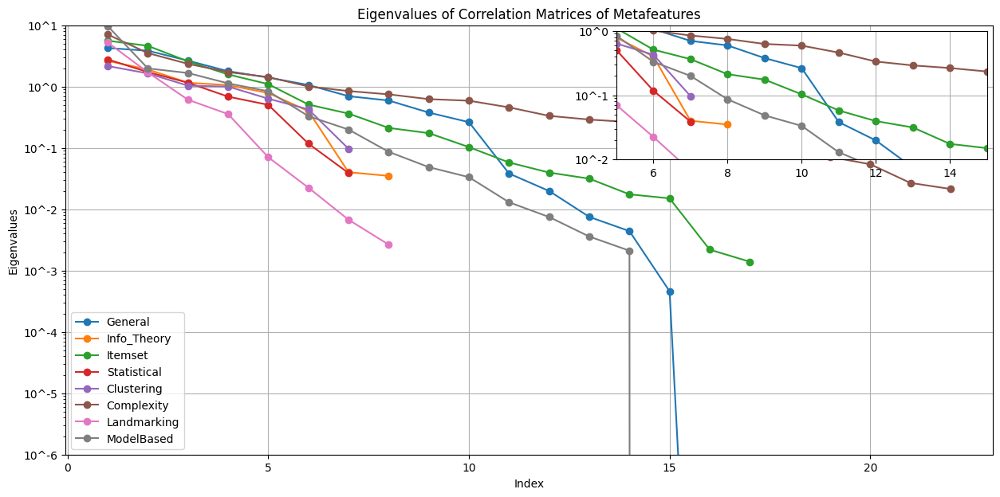

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

fig, ax = plt.subplots(figsize=(15, 7))

for name, values in eigenvalues_sorted.items():
    ax.plot(range(1, len(values) + 1), values, marker='o', label=name)

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')
ax.legend()
ax.grid(True)

# Inset plot
ax_inset = inset_axes(ax, width="40%", height="30%", loc='upper right')
for name, values in eigenvalues_sorted.items():
    ax_inset.plot(range(1, len(values) + 1), values, marker='o', label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(5, 15)
ax_inset.grid(True)

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


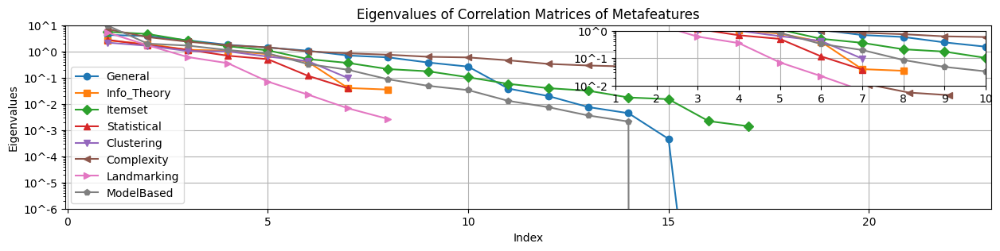

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')
ax.legend()
ax.grid(True)

# Inset plot
ax_inset = inset_axes(ax, width="40%", height="30%", loc='upper right')
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(1, 10)
ax_inset.grid(True)

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


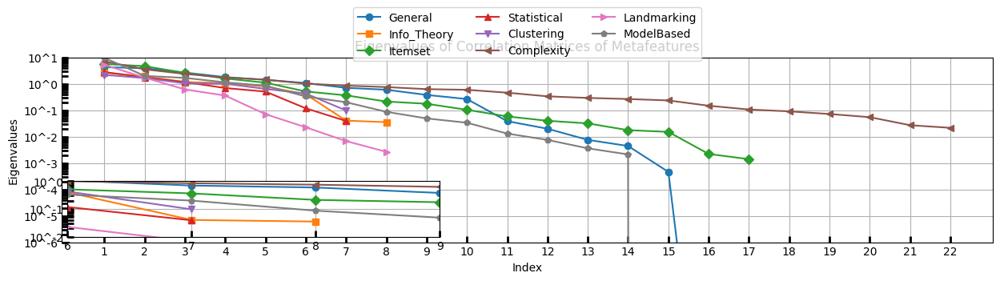

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')
ax.grid(True)

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot
ax_inset = inset_axes(ax, width="40%", height="30%", loc='lower left')
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(6, 9)
ax_inset.set_xticks(range(6, 10))
ax_inset.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here
ax_inset.grid(True)

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


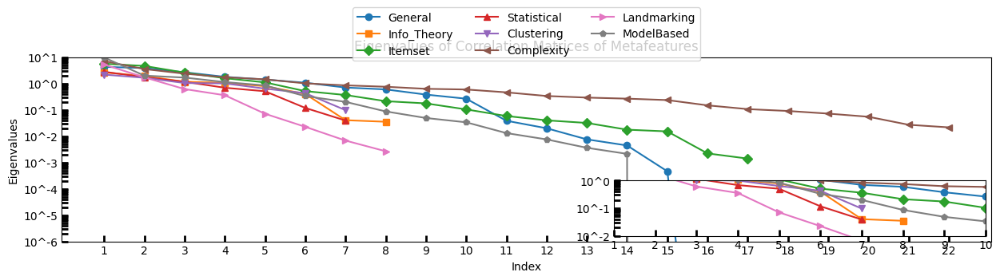

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Customize inset plot position and size
inset_width, inset_height = "40%", "30%"  # You can change these values manually
inset_loc = 'lower right'  # You can change this value to move the inset plot

# Inset plot
ax_inset = inset_axes(ax, width=inset_width, height=inset_height, loc=inset_loc)
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(1, 10)
ax_inset.set_xticks(range(1, 11))
ax_inset.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


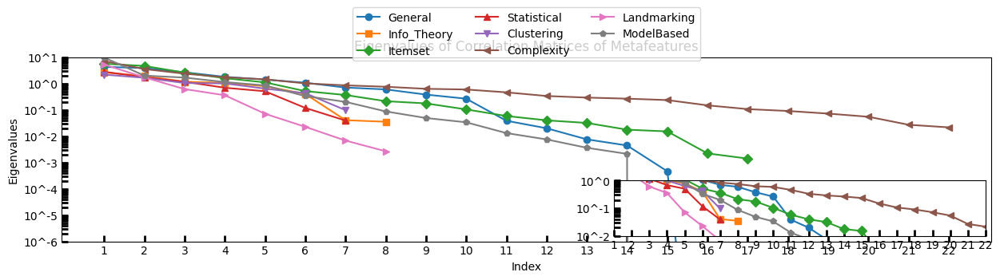

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Customize inset plot position and size
inset_width, inset_height = "40%", "30%"  # You can change these values manually
inset_loc = 'lower right'  # You can change this value to move the inset plot

# Inset plot
ax_inset = inset_axes(ax, width=inset_width, height=inset_height, loc=inset_loc)
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

ax_inset.set_yscale('log')
ax_inset.set_ylim(10**-2, 10**0)
ax_inset.set_yticks([10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-2', '10^-1', '10^0'])
ax_inset.set_xlim(1, max(len(values) for values in eigenvalues_sorted.values()))
ax_inset.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax_inset.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


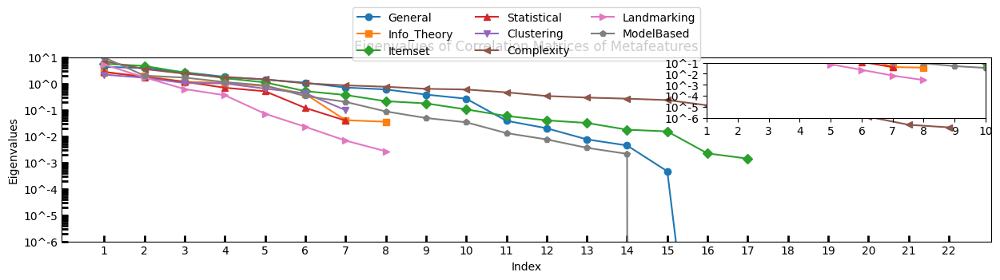

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Add inset plot
ax_inset = inset_axes(ax, width="30%", height="30%", loc='upper right')  # Adjust the size and location
# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(1, 10)  # Adjust the x-axis limits to zoom in on the first 10 eigenvalues
ax_inset.set_ylim(10**-6, 10**-1)  # Adjust the y-axis limits to focus on the desired range
ax_inset.set_xticks(range(1, 11))
ax_inset.set_yticks([10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1])
ax_inset.set_yticklabels(['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1'])

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


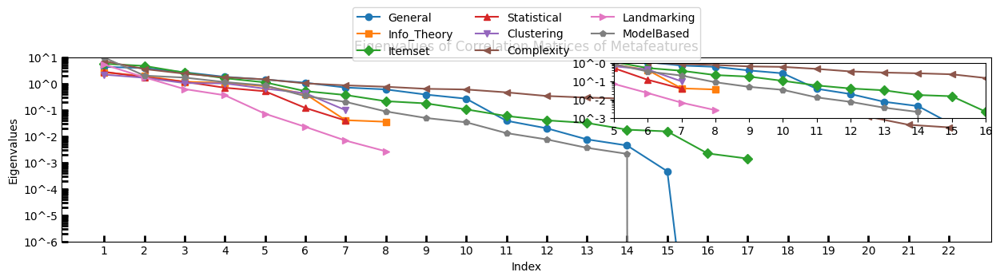

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels)
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot (10**-3, 10**1)

# Add inset plot
ax_inset = inset_axes(ax, width="40%", height="30%", loc='upper right')  # Adjust the size and location

# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels(['10^-3', '10^-2', '10^-1', '10^-0']) #(['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1'])

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased


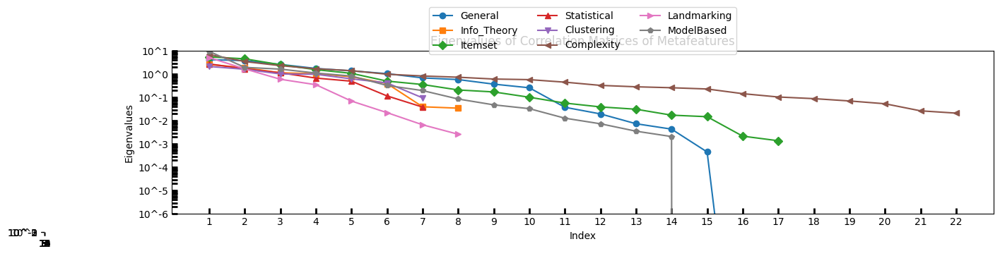

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Upload files
#uploaded = files.upload()

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

# Customize y-axis tick labels
ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in y_ticks])
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot

# Add inset plot with specified position using bbox_to_anchor
ax_inset = inset_axes(ax, width="40%", height="30%", loc='lower left', bbox_to_anchor=(0.1, 0.1, 0.8, 0.8))

# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in [10**-3, 10**-2, 10**-1, 10**0]])

plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

# Customize y-axis tick labels
ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in y_ticks])
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot

# Add inset plot with specified position using bbox_to_anchor
ax_inset = inset_axes(ax, width="40%", height="30%", bbox_to_anchor=(0.25, 0.25, 0.8, 0.8)) loc='upper right'

# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in [10**-3, 10**-2, 10**-1, 10**0]])

# Remove extra space on x-axis by setting limits
ax.set_xlim(1, max(len(values) for values in eigenvalues_sorted.values()))

plt.show()


SyntaxError: invalid syntax (<ipython-input-47-e0a3154dca31>, line 103)

Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased
Bbox(x0=0.125, y0=0.10999999999999999, x1=0.9, y1=0.88)


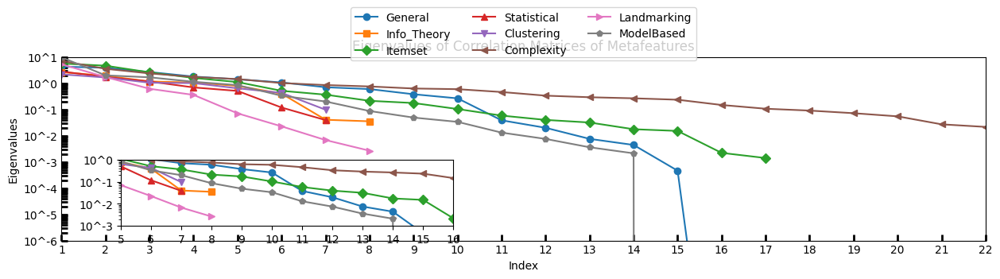

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.transforms import Bbox

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

# Customize y-axis tick labels
ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in y_ticks])
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot

# Add inset plot with specified position using bbox_to_anchor without loc parameter
#ax_inset = inset_axes(ax, width="40%", height="30%", bbox_to_anchor=(0.05, 0.05, 0.4, 0.4))
#ax_inset = inset_axes(ax, width="40%", height="30%", loc='lower left', bbox_to_anchor=(0.05, 0.05, 0.4, 0.4))
#ax_inset = inset_axes(ax, width="30%", height="25%", loc='center', bbox_to_anchor=(0.15, 0.15, 0.4, 0.4))
ax_inset = inset_axes(ax, width="90%", height="90%", bbox_to_anchor=(0.03, 0.07, 0.4, 0.4), bbox_transform=ax.transAxes)



# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in [10**-3, 10**-2, 10**-1, 10**0]])

print(ax_inset.get_position())


# Remove extra space on x-axis by setting limits
ax.set_xlim(1, max(len(values) for values in eigenvalues_sorted.values()))

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased
Bbox(x0=0.125, y0=0.10999999999999999, x1=0.9, y1=0.88)


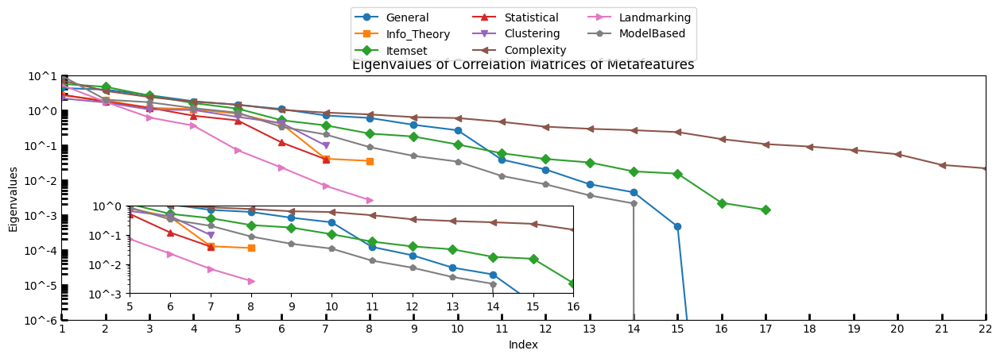

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.transforms import Bbox

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
y_tick_labels = ['10^-6', '10^-5', '10^-4', '10^-3', '10^-2', '10^-1', '10^0', '10^1']

# Customize figure size
fig_width, fig_height = 15, 4  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=6, width=2)  # Customize tick size here

# Customize y-axis tick labels
ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in y_ticks])
ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot

# Add inset plot with specified position using bbox_to_anchor without loc parameter
#ax_inset = inset_axes(ax, width="40%", height="30%", bbox_to_anchor=(0.05, 0.05, 0.4, 0.4))
#ax_inset = inset_axes(ax, width="40%", height="30%", loc='lower left', bbox_to_anchor=(0.05, 0.05, 0.4, 0.4))
#ax_inset = inset_axes(ax, width="30%", height="25%", loc='center', bbox_to_anchor=(0.15, 0.15, 0.4, 0.4))
ax_inset = inset_axes(ax, width="120%", height="90%", bbox_to_anchor=(0.16, 0.09, 0.4, 0.4), bbox_transform=ax.transAxes)



# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
ax_inset.set_yticklabels([f'10^{int(np.log10(tick))}' for tick in [10**-3, 10**-2, 10**-1, 10**0]])

print(ax_inset.get_position())


# Remove extra space on x-axis by setting limits
ax.set_xlim(1, max(len(values) for values in eigenvalues_sorted.values()))

plt.show()


Successfully read General
Successfully read Info_Theory
Successfully read Itemset
Successfully read Statistical
Successfully read Clustering
Successfully read Complexity
Successfully read Landmarking
Successfully read ModelBased
Calculated eigenvalues for General
Calculated eigenvalues for Info_Theory
Calculated eigenvalues for Itemset
Calculated eigenvalues for Statistical
Calculated eigenvalues for Clustering
Calculated eigenvalues for Complexity
Calculated eigenvalues for Landmarking
Calculated eigenvalues for ModelBased
Bbox(x0=0.125, y0=0.10999999999999999, x1=0.9, y1=0.88)


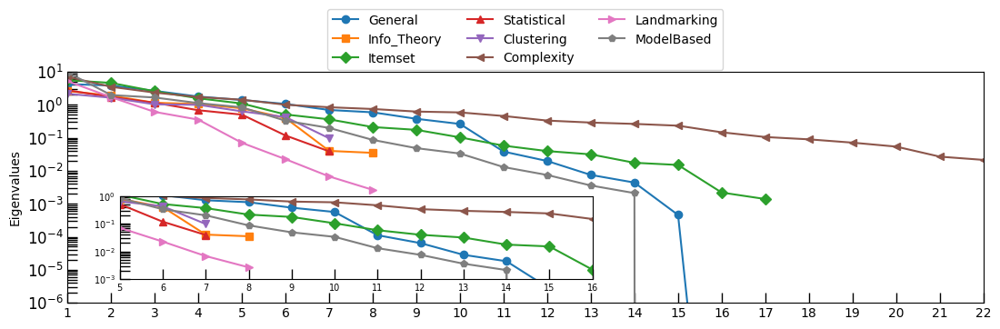

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Read the uploaded files
file_paths = {
    "General": "Simple_Metafeatures.xlsx",
    "Info_Theory": "Information_Theoretic_Metafeatures.xlsx",
    "Itemset": "Structural_Metafeatures.xlsx",
    "Statistical": "Statistical_Metafeatures.xlsx",
    "Clustering": "Clustering_Metafeatures.xlsx",
    "Complexity": "Complexity_Metafeatures.xlsx",
    "Landmarking": "Landmarking_Metafeatures.xlsx",
    "ModelBased": "Model_Based_Metafeatures.xlsx"
}

# Read all metafeature groups from Excel files
metafeature_groups = {}
for name in file_paths:
    try:
        metafeature_groups[name] = pd.read_excel(file_paths[name])
        print(f"Successfully read {name}")
    except Exception as e:
        print(f"Error reading {file_paths[name]}: {e}")

# Function to preprocess the data: normalize and remove columns with too many zeros or NaNs
def preprocess_data(df):
    # Remove non-numeric columns
    df = df.select_dtypes(include=[np.number])

    # Remove columns with all values the same
    df = df.loc[:, df.nunique() > 1]

    # Remove columns with too many zeros or NaNs (threshold: more than 50% zeros or NaNs)
    threshold = 0.5
    df = df.dropna(thresh=int(threshold * len(df)), axis=1)
    df = df.loc[:, (df == 0).mean() < threshold]

    # Normalize the data
    df_normalized = df.copy()
    for column in df.columns:
        min_val = df[column].min()
        max_val = df[column].max()
        if max_val != min_val:
            df_normalized[column] = (df[column] - min_val) / (max_val - min_val)
        else:
            df_normalized.drop(columns=[column], inplace=True)

    return df_normalized

# Preprocess each metafeature group
preprocessed_metafeature_groups = {name: preprocess_data(df) for name, df in metafeature_groups.items()}

# Calculate correlation matrix and eigenvalues
eigenvalues = {}
for name, df in preprocessed_metafeature_groups.items():
    if df.shape[1] > 1:  # Ensure there are at least two columns to form a square matrix
        correlation_matrix = df.corr()
        correlation_matrix = correlation_matrix.replace([np.inf, -np.inf], np.nan).dropna(how='any')
        if correlation_matrix.shape[0] == correlation_matrix.shape[1]:  # Ensure matrix is square
            eigenvalues[name] = np.linalg.eigvals(correlation_matrix)
            print(f"Calculated eigenvalues for {name}")

# Sort eigenvalues and assign index numbers accordingly
eigenvalues_sorted = {name: sorted(values, reverse=True) for name, values in eigenvalues.items()}

# Define the y-axis ticks and limits as specified
y_ticks = [10**-6, 10**-5, 10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1]
#y_tick_labels = ['10^{}'.format(int(np.log10(tick))) for tick in y_ticks]
y_tick_labels = ['$10^{%d}$' % int(np.log10(tick)) for tick in y_ticks]

# Customize figure size
fig_width, fig_height = 13, 3.3  # You can change these values manually
fig, ax = plt.subplots(figsize=(fig_width, fig_height))

# Define different marker shapes for each meta-feature group
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'H']

for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize the ticks
ax.set_xticks(range(1, max(len(values) for values in eigenvalues_sorted.values()) + 1))
ax.tick_params(axis='both', which='both', direction='in', length=8, width=2)  # Customize tick size here

# Customize y-axis tick labels
ax.set_yscale('log')
ax.set_ylim(10**-6, 10**1)
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_tick_labels, fontsize=12)  # Customize tick label size here
#ax.set_xlabel('Index')
ax.set_ylabel('Eigenvalues')
#ax.set_title('Eigenvalues of Correlation Matrices of Metafeatures')

# Move legend outside the plot
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)

# Inset plot customization parameters
x_lim_inset = (5, 16)  # X-axis limits for the inset plot
y_lim_inset = (10**-3, 10**0)  # Y-axis limits for the inset plot

# Add inset plot with specified position using bbox_to_anchor without loc parameter
ax_inset = inset_axes(ax, width="129%", height="90%", bbox_to_anchor=(0.18, 0.09, 0.4, 0.4), bbox_transform=ax.transAxes)

# Plot a zoomed-in section in the inset
for (name, values), marker in zip(eigenvalues_sorted.items(), markers):
    ax_inset.plot(range(1, len(values) + 1), values, marker=marker, label=name)

# Customize inset plot ticks and labels
#ax_inset.set_yscale('log')
#ax_inset.set_xlim(x_lim_inset)  # Set x-axis limits for the inset
#ax_inset.set_ylim(y_lim_inset)  # Set y-axis limits for the inset
#ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
#ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])
#ax_inset.set_yticklabels(['10^{}'.format(int(np.log10(tick))) for tick in [10**-3, 10**-2, 10**-1, 10**0]], fontsize=12)  # Customize tick label size here
#ax_inset.sety_tick_labels = ['$10^{%d}$' % int(np.log10(tick)) for tick in y_ticks]

ax_inset.set_yscale('log')
ax_inset.set_xlim(x_lim_inset)
ax_inset.set_ylim(y_lim_inset)
ax_inset.set_xticks(range(x_lim_inset[0], x_lim_inset[1] + 1))
ax_inset.set_yticks([10**-3, 10**-2, 10**-1, 10**0])

# Use LaTeX formatting for the y-tick labels
y_tick_labels_inset = ['$10^{%d}$' % int(np.log10(tick)) for tick in [10**-3, 10**-2, 10**-1, 10**0]]
ax_inset.set_yticklabels(y_tick_labels_inset, fontsize=7)

# Set the x-tick labels (you can use regular formatting here)
ax_inset.set_xticklabels(ax_inset.get_xticks(), fontsize=7)



# Adjust the size of tick marks
ax_inset.tick_params(axis='both', which='both', direction='in', length=8, width=1)  # Customize tick size here
ax.tick_params(axis='both', which='both', direction='in', length=8, width=1)  # Customize tick size here

print(ax_inset.get_position())

# Remove extra space on x-axis by setting limits
ax.set_xlim(1, max(len(values) for values in eigenvalues_sorted.values()))
#plt.yticks(y_ticks, y_tick_labels)

# Save the plot (optional)
pdf_path = 'multicollinearity_existed_.pdf'
svg_path = 'multicollinearity_existed.svg'

#plt.savefig('your_plot.pdf', bbox_inches='tight')
plt.savefig(pdf_path, format='pdf', bbox_inches='tight')
plt.savefig(svg_path, format='svg')

# Show plot
plt.show()

